### MIE370 Project 2 --- PCA
**Deadline: Oct 23rd, 9PM**

# Project 2 **[100 Marks]**

In this project we work on [flight delays dataset](https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018) that reports scheduled and actual departure and arrival times reported by certified US air carriers. This dataset contains date, origin, destination, airline, distance, and delay status of flights for flights between 2016 and 2018.

# Part 1: Getting started [9 Marks]

1. Write a function to do the following: **[3]**
    * Takes the dataframe, and the list of destination states as inputs (California, Colorado, North Carolina, Arizona, ...)
    * Plots time-series for the input list (it is best to plot each destination state in a separate graph (subplot), so you can easily compare them.)
    
2. Apply `StandardScalar` to the data. Each day should have a `mean` of zero and a `StD` of 1. **[2]**
3. Run the function in `step 1` on both the original as well as the standardized dataset for the `AZ`, `CA`, `IL` and `NC`.   **[2]**

4. Discuss the trends in the standardized time-series for `AZ`, `CA`, `IL` and `NC`. What does it mean if the curve goes up or down? What does the sign of values indicate? **[2]**

In [3]:
import pandas as pd
data_raw = pd.read_csv(
    filepath_or_buffer='https://raw.githubusercontent.com/Sabaae/Dataset/main/TotalDelaysbyState.csv',
    index_col=0
)

In [4]:
### visualize the data
data_raw.head()
# according to piazza instructor's answer:
    # The values are the number of flights delayed at a particular state and date. 

,2016-01-01,2016-01-02,2016-01-03,2016-01-04,2016-01-05,2016-01-06,2016-01-07,2016-01-08,2016-01-09,2016-01-10,...,2018-12-22,2018-12-23,2018-12-24,2018-12-25,2018-12-26,2018-12-27,2018-12-28,2018-12-29,2018-12-30,2018-12-31
DestState,,,,,,,,,,,,,,,,,,,,,
AZ,742.0,2262.0,1095.0,1247.0,1197.0,1481.0,1400.0,1263.0,859.0,596.0,...,970.0,1048.0,477.0,305.0,1456.0,1975.0,1479.0,1212.0,1097.0,1590.0
CA,2552.0,2849.0,5492.0,8256.0,6821.0,12656.0,4238.0,3912.0,1132.0,2024.0,...,2834.0,2386.0,3587.0,434.0,5847.0,5494.0,4323.0,1667.0,3193.0,2744.0
CO,711.0,1361.0,1172.0,1206.0,670.0,946.0,969.0,1303.0,627.0,1332.0,...,1076.0,1660.0,188.0,264.0,1727.0,2905.0,2111.0,1420.0,1474.0,1481.0
GA,378.0,393.0,908.0,902.0,805.0,1011.0,810.0,769.0,713.0,1203.0,...,706.0,275.0,382.0,102.0,2254.0,2365.0,2006.0,992.0,444.0,1186.0
IL,331.0,517.0,1831.0,1691.0,1102.0,720.0,813.0,1114.0,1116.0,519.0,...,1228.0,583.0,571.0,297.0,1522.0,2962.0,2759.0,1843.0,762.0,1090.0


1.

In [5]:
import wget
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [6]:
### YOUR CODE HERE ###
from matplotlib.ticker import MaxNLocator
def plot_time_series_states(df: pd.DataFrame, destination_states: list): 
    
    num_states = len(destination_states)
    fig, ax = plt.subplots(num_states, 1, figsize=(20, 21))
    for i in range(num_states):
        ax[i].plot(df.loc[destination_states[i]])
        ax[i].set_title(destination_states[i])
        ax[i].tick_params(axis='x', rotation=45)
        
        # Set the x-axis tick frequency
        ax[i].xaxis.set_major_locator(MaxNLocator(nbins=10))  # Adjust nbins to set the desired number of ticks
    fig.tight_layout()
    
    # have a plot show all states' time series together
    plt.figure(figsize=(15, 5))
    for state in destination_states:
        plt.plot(df.loc[state], label=state)
        
    plt.legend(title='States', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.title("all states' time series together")
    plt.tick_params(axis='x', rotation=45)
    plt.gca().xaxis.set_major_locator(MaxNLocator(nbins=10))
    
    plt.show()
    


2.

In [7]:
from sklearn.preprocessing import StandardScaler

In [8]:
scaler = StandardScaler(copy=True, with_mean=True, with_std=True)
scaler.fit(data_raw)
standard_data = scaler.transform(data_raw)

standard_df = pd.DataFrame(standard_data, index=data_raw.index, columns=data_raw.columns)
standard_df

,2016-01-01,2016-01-02,2016-01-03,2016-01-04,2016-01-05,2016-01-06,2016-01-07,2016-01-08,2016-01-09,2016-01-10,...,2018-12-22,2018-12-23,2018-12-24,2018-12-25,2018-12-26,2018-12-27,2018-12-28,2018-12-29,2018-12-30,2018-12-31
DestState,,,,,,,,,,,,,,,,,,,,,
AZ,-0.346424,1.111421,-0.550259,-0.360059,-0.352266,-0.297055,-0.069939,-0.370488,-0.078917,-1.169553,...,-0.281014,-0.033796,-0.359971,-0.299428,-0.599862,-0.721949,-1.086590,-0.551261,-0.299580,0.010751
CA,1.453903,1.771845,2.272007,2.432034,2.402600,2.439621,2.297036,1.907350,0.840659,1.267056,...,2.308439,1.839205,2.382006,-0.079425,0.894542,0.616888,1.823261,0.674832,2.110198,1.649389
CO,-0.377259,0.097721,-0.500835,-0.376392,-0.610412,-0.428072,-0.429406,-0.336093,-0.860388,0.086290,...,-0.133759,0.822913,-0.614772,-0.369351,-0.507632,-0.368122,-0.439956,0.009239,0.133858,-0.144025
GA,-0.708479,-0.991359,-0.670287,-0.497493,-0.544283,-0.412154,-0.562017,-0.795272,-0.570705,-0.133823,...,-0.647760,-1.115882,-0.443729,-0.645634,-0.328276,-0.573570,-0.547387,-1.144097,-1.050336,-0.562914
IL,-0.755228,-0.851849,-0.077849,-0.183188,-0.398801,-0.483418,-0.559514,-0.498611,0.786764,-1.300939,...,0.077398,-0.684727,-0.277095,-0.313071,-0.577400,-0.346435,0.223048,1.149101,-0.684730,-0.699231
NC,-0.914373,-0.929479,-0.835245,-0.601862,-0.524200,-0.547090,-0.919815,-1.008524,-1.574491,-0.248146,...,-1.031177,-1.078086,-0.736442,-0.695092,-0.943259,-0.810596,-0.974043,-1.410873,-0.754862,-1.434772
TX,1.647860,-0.208301,0.362468,-0.413041,0.027361,-0.271831,0.243656,1.101637,1.457078,1.499114,...,-0.292127,0.250373,0.050003,2.402000,2.061887,2.203783,1.001668,1.273058,0.545452,1.180801


In [9]:
# check if the mean and std is 0 and 1
means = standard_df.mean().sum()
print(means)


stds = standard_df.std().sum()/len(data_raw.columns.to_list())
print(stds)

-5.945392987451369e-15
1.0801234497346432


3.

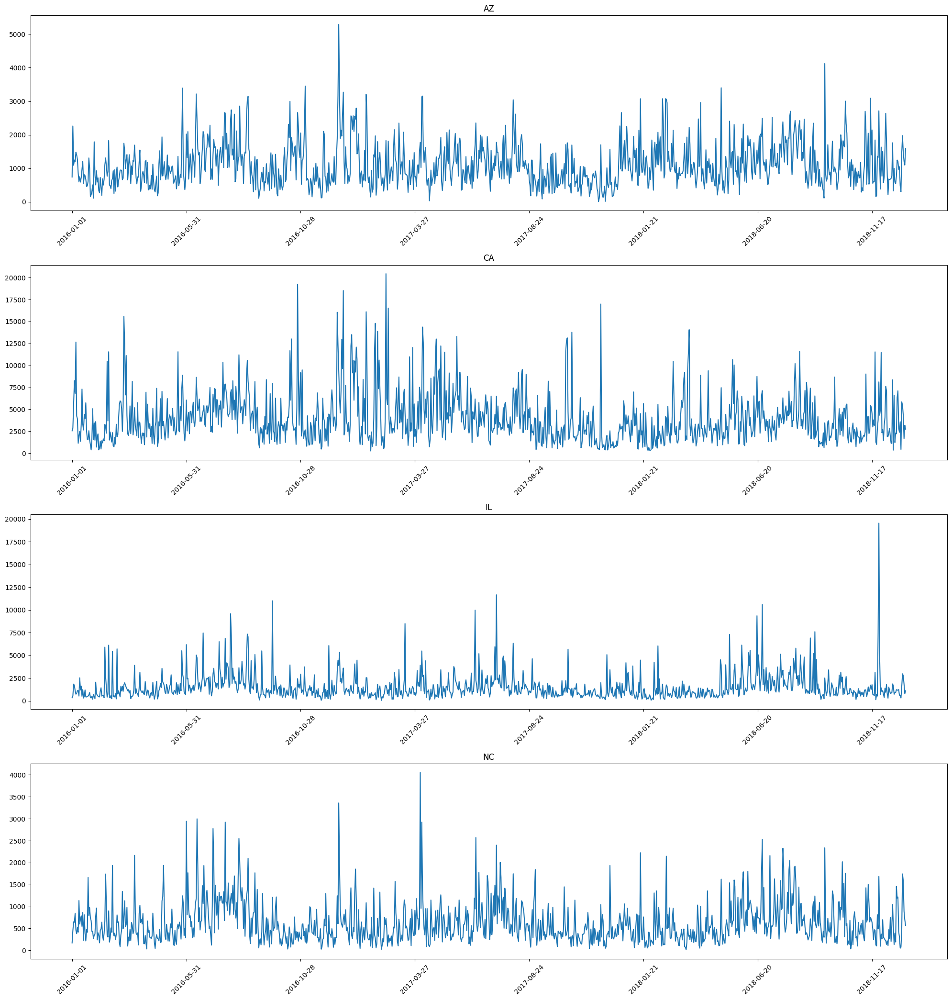

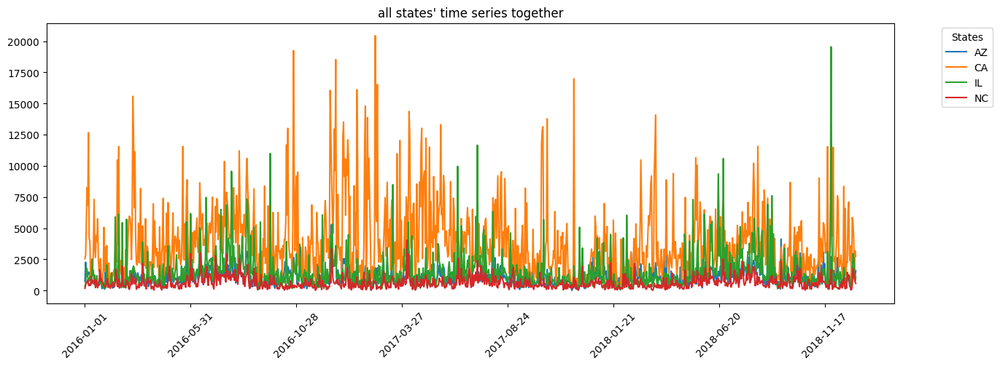

In [10]:
# plot the graph in original data
plot_time_series_states(data_raw, ["AZ", "CA", "IL", "NC"])

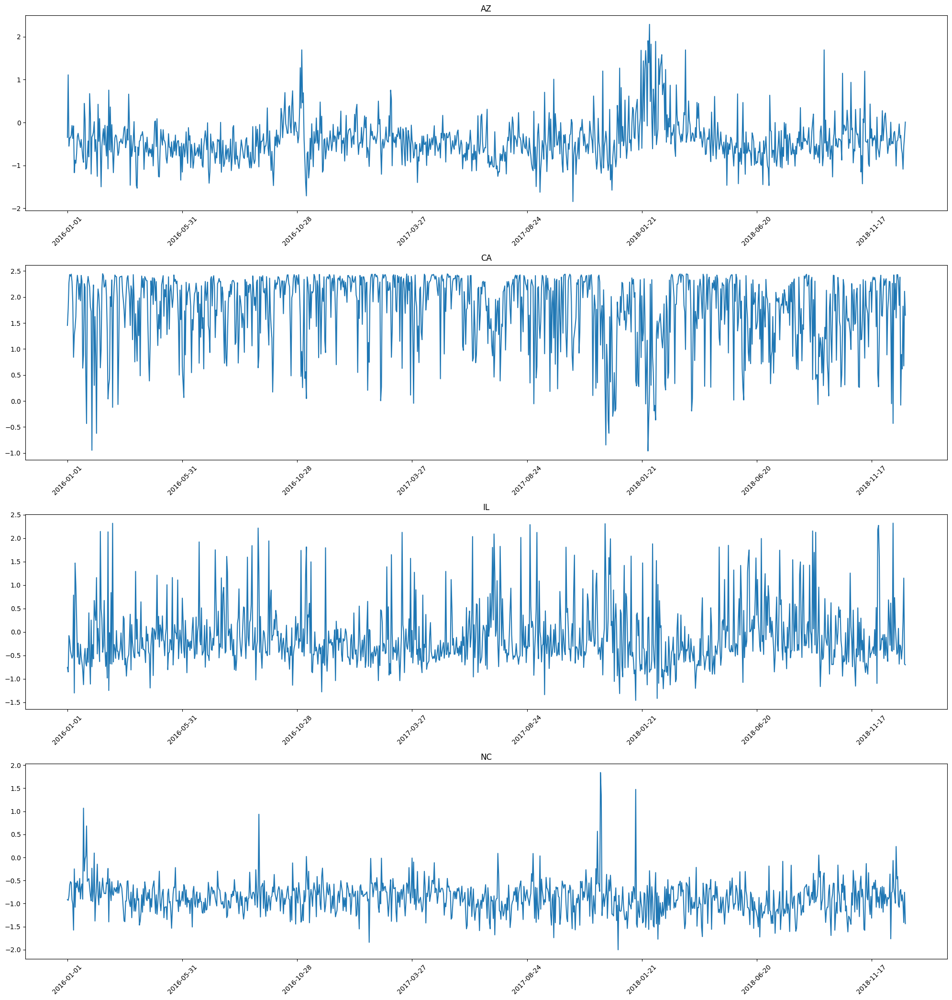

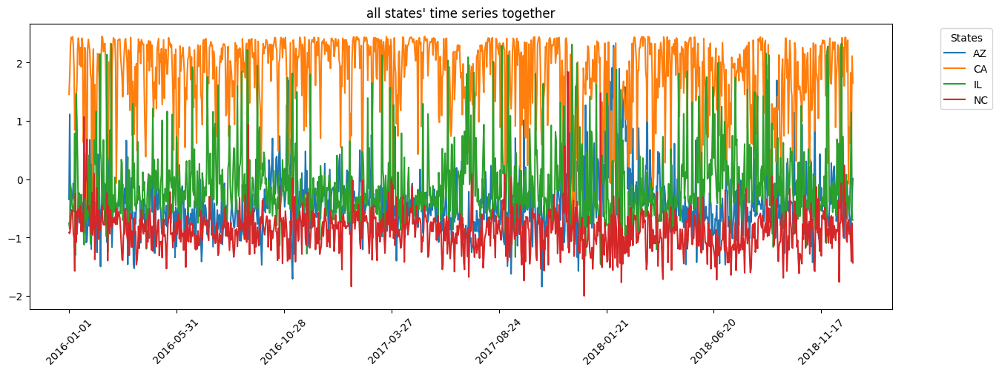

In [11]:
# plot the graph in standardized data
plot_time_series_states(standard_df, ["AZ", "CA", "IL", "NC"])

4.

The trends in standardized time-series for `AZ, CA, IL, NC` show the relative number of delayed flights at particular state at particular date. The unregularized data indicates the flight delay data is totally random. \
All the data are standardized, with mean = 0, and std = 1 
- If the curve goes up above the mean 0, it shows that there is more number of delayed flights in this day compare to the average, as we can see the most of the flights in CA are delayed for more time compare to the average. 
    - As the sign of value gets higher, further away from the mean 0, it meanas that the delayed time is longer. 
- If the curve goes up down the mean 0, it shows that there is less number of delayed flights in this day compare to the average, as we can see the most of the flights in NC are delayed for less time compare to the average. 
    - As the sign of value gets lower, further away from the mean 0, it meanas that the delayed time is shorter. 




# Part 2: Applying PCA [14 Marks]

1. Compute the covariance matrix of the dataframe. *Hint: The dimensions of your covariance matrix should be ((1095, 1095).* **[1]**
2. Write a function `get_sorted_eigen(df_cov)` that gets the covariance matrix of dataframe `df` (from step 1), and returns sorted eigenvalues and eigenvectors using `np.linalg.eigh`. **[2]**
3. Show the effectiveness of your principal components in covering the variance of the dataset with a `scree plot`. *Hint: Limit the scree plot to the first 10 PCs.* **[3]**
4. How many PCs do you need to cover 90% of the dataset's variance? **[1]**
5. Plot the first 16 principal components (Eigenvectors) as a time series (16 subplots, on the x-axis you have dates and on the y-axis you have the value of the PC element) . **[5]**
6. Compare the first few PCs with the rest of them. Do you see any difference in their trend? **[2]**

1.

In [12]:
# use the equation we used in tut 7 instead of just .cov
# since we standardized data and the mean is 0
standard_df_cov = np.dot(standard_df.T, standard_df) / (standard_df.shape[0]-1)
standard_df_cov

array([[1.16666667, 0.66775605, 0.92959088, ..., 0.7498742 , 0.99527142,
        1.10554403],
       [0.66775605, 1.16666667, 0.79946384, ..., 0.29757768, 0.93860379,
        0.86027552],
       [0.92959088, 0.79946384, 1.16666667, ..., 0.69153627, 1.0796212 ,
        0.9786297 ],
       ...,
       [0.7498742 , 0.29757768, 0.69153627, ..., 1.16666667, 0.62744687,
        0.74564222],
       [0.99527142, 0.93860379, 1.0796212 , ..., 0.62744687, 1.16666667,
        1.04253291],
       [1.10554403, 0.86027552, 0.9786297 , ..., 0.74564222, 1.04253291,
        1.16666667]])

In [13]:
# check the shape
standard_df_cov.shape

(1095, 1095)

2.

In [157]:
# use help to check the built-in method
np.linalg.eigh?

Signature:       np.linalg.eigh(a, UPLO='L')
Call signature:  np.linalg.eigh(*args, **kwargs)
Type:            _ArrayFunctionDispatcher
String form:     <function eigh at 0x000001847F942C00>
File:            d:\python\lib\site-packages\numpy\linalg\linalg.py
Docstring:      
Return the eigenvalues and eigenvectors of a complex Hermitian
(conjugate symmetric) or a real symmetric matrix.

Returns two objects, a 1-D array containing the eigenvalues of `a`, and
a 2-D square array or matrix (depending on the input type) of the
corresponding eigenvectors (in columns).

Parameters
----------
a : (..., M, M) array
    Hermitian or real symmetric matrices whose eigenvalues and
    eigenvectors are to be computed.
UPLO : {'L', 'U'}, optional
    Specifies whether the calculation is done with the lower triangular
    part of `a` ('L', default) or the upper triangular part ('U').
    Irrespective of this value only the real parts of the diagonal will
    be considered in the computation to preserv

In [14]:
def get_sorted_eigen(df: pd.DataFrame):
    # find eigen value and vector
    eigen_val, eigen_vec = np.linalg.eigh(df)
    # sort in desc order
    args = (-eigen_val).argsort()  # need the position of the sorted values
    eigen_val = eigen_val[args]
    eigen_vec = eigen_vec[:, args]
    
    return eigen_val, eigen_vec

In [15]:
# print out to check
eigen_val, eigen_vec = get_sorted_eigen(standard_df_cov)
print(f"eigen val: {eigen_val}, \n\neigen vec: {eigen_vec}")

eigen val: [ 8.96325414e+02  1.52314505e+02  8.83966038e+01 ... -2.45502966e-13
 -3.27808060e-13 -6.02067914e-13], 

eigen vec: [[-0.03032132 -0.03622483 -0.03802044 ...  0.0046172   0.
   0.        ]
 [-0.02519803  0.033178   -0.0393146  ...  0.08590404 -0.04850112
  -0.09865914]
 [-0.03586215  0.0052813   0.00593399 ... -0.14822007  0.10556335
   0.12965812]
 ...
 [-0.02232832 -0.04641152  0.04548647 ...  0.00285643  0.00277841
  -0.00608046]
 [-0.03367619  0.00696076 -0.02571844 ...  0.04567799  0.01052066
   0.00663739]
 [-0.03208999 -0.02053568 -0.03422654 ...  0.04693383 -0.00566484
  -0.0067113 ]]


3.

In [16]:
# 1st calculate the explained var
eigen_val_sum = sum(eigen_val)  # total var explained by all PCs
exp_var = [(e_val / eigen_val_sum) * 100 for e_val in eigen_val]  # % of var explain by this PC - PCi

cum_exp_var = np.cumsum(exp_var)  # get the cummulative sum
cum_exp_var

array([ 70.162459  ,  82.08531655,  89.00481587, ..., 100.        ,
       100.        , 100.        ])

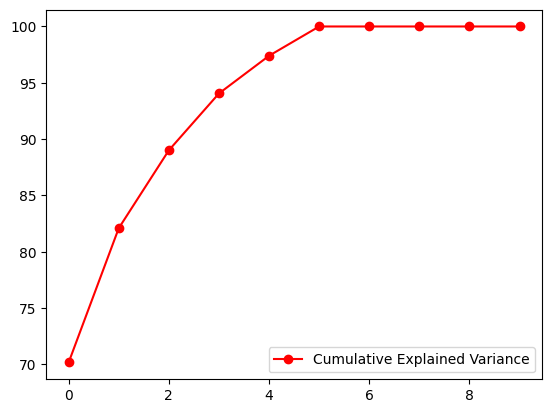

In [17]:
# plot first 10 PCs cum to check
plt.plot(cum_exp_var[:10], 'r-o', label="Cumulative Explained Variance")
plt.legend()
plt.show()

scree plot

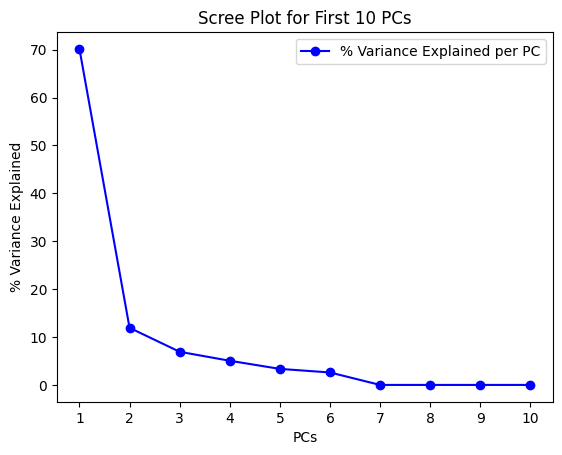

In [315]:
# first 10
exp_var = [cum_exp_var[0]] + [cum_exp_var[i] - cum_exp_var[i-1] for i in range(1, len(cum_exp_var))]

# Plot the scree plot for the first 10 PCs (individual explained variance)
plt.plot(range(1, 11), exp_var[:10], 'b-o', label="% Variance Explained per PC")
plt.xlabel("PCs")
plt.xticks(range(1, 11))
plt.ylabel("% Variance Explained")
plt.title("Scree Plot for First 10 PCs")
plt.legend()
plt.show()


4.

In [18]:
for i in range(len(cum_exp_var)):
    if cum_exp_var[i] >= 90:
        print(f"{i} PCs need to explain 90% of the dataset's variance")
        print(f"({cum_exp_var[i]})")
        break

3 PCs need to explain 90% of the dataset's variance
(94.05108002543795)


5.

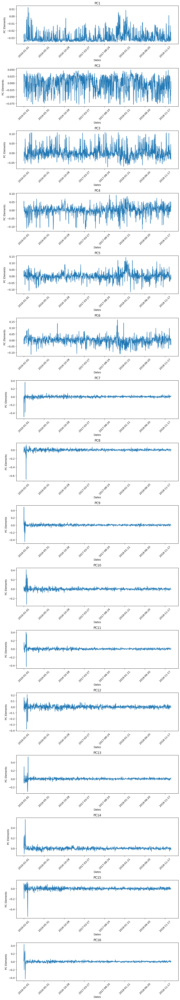

In [19]:

# plot 16 PCs as time series
date = data_raw.columns

fig, ax = plt.subplots(16, 1, figsize=(10, 55))
for i in range(16):
    ax[i].plot(date, eigen_vec[:, i])
    ax[i].set_title(f"PC{i+1}")
    ax[i].tick_params(axis='x', rotation=45)
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("PC Elements")
    
    # Set the x-axis tick frequency
    ax[i].xaxis.set_major_locator(MaxNLocator(nbins=10))  # Adjust nbins to set the desired number of ticks
fig.tight_layout()
plt.show()

6.

By comparing the first 6 PCs with the rest of the PCs, we can see a trends from PC1 to PC6 is largely flucuating, reflect that principle of PCA where the first few components captures the most important trends and information. With the less flucuation and more stable in the trends through PCs, we can see that the later PCs tend to capture the less informations, even the left out outliers and noisy information from the top PCs.

# Part 3: Data reconstruction [21 Marks]

Create a function that:

*   Accepts a destination state and the original dataset as inputs.
*   Calls useful functions that you designed in previous parts to compute eigenvectors and eigenvalues.
*   Plots 4 figures:
  1.   The original time-series for the specified state. **[5]**
  2.   The incremental reconstruction of the **original** (not standardized) time-series for the specified state in a single plot. **[8]**
       * You should show 4 curves in a figure for incremental reconstruction by picking the following combinations:
          * Reconstruction with only PC1
          * Reconstruction with both PC1 and PC2
          * Reconstruction with PC1 to PC4 (First 4 PCs)
          * Reconstruction with PC1 to PC6 (First 6 PCs)

      * Hint: you need to compute the reconstruction for the standardized time-series first, and then scale it back to the original (non-standardized form) using the StandardScaler `inverse_transform` [help...](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html#sklearn.preprocessing.StandardScaler.inverse_transform)
  3.   The residual error for your best reconstruction with respect to the original time-series. **[3]**
      * Hint: You are plotting the error that we have for reconstructing each day `(df - df_reconstructed)`. On the x-axis, you have dates, and on the y-axis, the residual error.
  4.   The RMSE of the reconstruction as a function of the number of included components (x-axis is the number of components and y-axis is the RMSE). Sweep x-axis from 1 to 7 (this part is independent from part 3.2.) **[3]**

Test your function using the `AZ`, `CA`, `IL` and `NC` as inputs. **[2]**


In [58]:
# helper func 1
def help_plot_time_series_state(df: pd.DataFrame, destination_state: str): 
    
    # num_states = len(destination_states)
    plt.figure(figsize=(15, 10))
    plt.plot(df.loc[destination_state])
    plt.title(f"Original Time-Series for : {destination_state}")
    plt.tick_params(axis='x', rotation=45)
        
    # Set the x-axis tick frequency
    plt.gca().xaxis.set_major_locator(MaxNLocator(nbins=10))  # Adjust nbins to set the desired number of ticks
    plt.show()
    

In [236]:
# helper func 2
def incremental_recon(standard_df: pd.DataFrame, eigen_vec: np.array, num_components: int):
    # # list holding 4 recon
    # reconsturctions = []
    
    # only PC1
    W = eigen_vec[: , :num_components]
    print(f"w shape: {W.shape}")      # debug
    projX = np.dot(standard_df, W)
    print(f"proj X shaep: {projX.shape}")  # debug
    ReconX = np.dot(projX, W.T)
    print(f"Recon X shaep: {ReconX.shape}")  # debug
    # reconsturctions.append(ReconX)
    
    # # PC1, PC2
    # W2 = eigen_vec[: , :2]
    # projX2 = np.dot(standard_df, W2)
    # ReconX2 = np.dot(projX2, W2.T)
    # reconsturctions.append(ReconX2)
    
    # # PC1 - PC4
    # W3 = eigen_vec[: , :4]
    # projX3 = np.dot(standard_df, W3)
    # ReconX3 = np.dot(projX3, W3.T)
    # reconsturctions.append(ReconX3)
    
    # # PC1 - PC6
    # W4 = eigen_vec[: , :6]
    # projX4 = np.dot(standard_df, W4)
    # ReconX4 = np.dot(projX4, W4.T)
    # reconsturctions.append(ReconX4)
      
    return ReconX

In [229]:
# helper func 3
def residual_error(df, date, df_recon):
    residual = df.values - df_recon.flatten()  # cal the residual
    
    # plot
    plt.figure(figsize=(15, 10))
    plt.plot(date, residual)
    plt.xlabel("Date")
    plt.ylabel("Residuals")
    plt.title("Residual Error of the Best Reconstruction")
    plt.tick_params(axis='x', rotation=45)
        
    # Set the x-axis tick frequency
    plt.gca().xaxis.set_major_locator(MaxNLocator(nbins=20))  # Adjust nbins to set the desired number of ticks
    plt.show()
    # print(residual)  # debug
    
    return residual

def cal_rmse(orifinal_data, recon_data):
    # sq diff
    sq_diff = (orifinal_data - recon_data)**2
    # mse
    mse = np.mean(sq_diff)
    # rmse
    rmse = np.sqrt(mse)
    
    return rmse

In [169]:
# helper func 4
def RMSE(df, standard_df: pd.DataFrame, eigen_vec: np.array, scaler):
    # 1 to 7 PCs
    num_components = [i for i in range(1, 8)]
    rmse_list = []
    
    # iter from 1 PC to 7 PCs
    for i in range(len(num_components)):
        
        # rmse_list.append(rmse)
        df_recon = incremental_recon(standard_df, eigen_vec, num_components[i])
        recon_original = scaler.inverse_transform(df_recon)
        
        rmse = cal_rmse(df.values, recon_original.flatten())
        rmse_list.append(rmse)
        
    # plot
    plt.figure(figsize=(21, 14))
    plt.plot(num_components, rmse_list, marker='o', linestyle='-', color='b')
    plt.xlabel("num of components")
    plt.ylabel("rmse")
    plt.title("Number of PCs VS. According RMSE")
    plt.show()

In [231]:
### YOUR CODE HERE ###
def date_reconstruction(df: pd.DataFrame, destination: str):
    
    # plot 4 figs:
    # 1. original time-series for 1 state
    help_plot_time_series_state(df, destination)
    
    # 2. incremental reconstruction on original time series
    # scale the original data
    scaler = StandardScaler(copy=True, with_mean=True, with_std=True)
    scaler.fit(df)
    standard_data = scaler.transform(df)
    standard_df = pd.DataFrame(standard_data, index=df.index, columns=df.columns)
    
    # find the cov
    standard_df_cov = np.dot(standard_df.T, standard_df) / (standard_df.shape[0]-1)
    standard_df_cov
    
    # compute eigen val, vec
    eigen_val, eigen_vec = get_sorted_eigen(standard_df_cov)
    
    # single state
    select_state_data = standard_df.loc[destination].values.reshape(1, -1)  # Get standardized data for the specific state
    
    # get back the reconstruced data with diff PCs
    reconsturctions = []
    num_components = [1, 2, 4, 6]
    best_rmse = float('inf')
    best_recon = None
    rmse_list = []
    
    # plot 
    plt.figure(figsize=(20, 15))
    for i in range(4):
        recon = incremental_recon(select_state_data, eigen_vec, num_components[i])
        reconsturctions.append(recon)
        # scale it back to original
        recon_original = scaler.inverse_transform(recon)
        
        if i == 0:
            PC = "PC1"
        if i == 1:
            PC = "PC1 and PC2"
        if i == 2:
            PC = "PC1 to PC4"
        if i == 3:
            PC = "PC1 to PC6"
            
        # cal the rmse of each recon
        rmse = cal_rmse(df.loc[destination].values, recon_original.flatten())
        rmse_list.append(rmse)
            
        plt.plot(df.columns, recon_original.flatten(), label=f'Reconstruction with {PC}')
        
        # find the best recon
        if (rmse < best_rmse):
            best_rmse = rmse
            best_recon = recon_original
    
    print(f"recons: {rmse_list}")  # debug

    plt.title(f"Incremental Reconstruction of the original time-series for state {destination}")
    plt.tick_params(axis='x', rotation=45)
        
    # Set the x-axis tick frequency
    plt.gca().xaxis.set_major_locator(MaxNLocator(nbins=20))  # Adjust nbins to set the desired number of ticks
    plt.legend()
    plt.show()
    
    # 3. residual err
    # use RMSE to find the best reconstruction at above
    residual_err = residual_error(df.loc[destination], df.columns, best_recon)
    
    # 4. RMSE
    # seperate with 3.2
    RMSE(df.loc[destination], select_state_data, eigen_vec, scaler)
    
    return rmse_list, residual_err, best_recon
    

Test function using `AZ, CA, IL, NC`

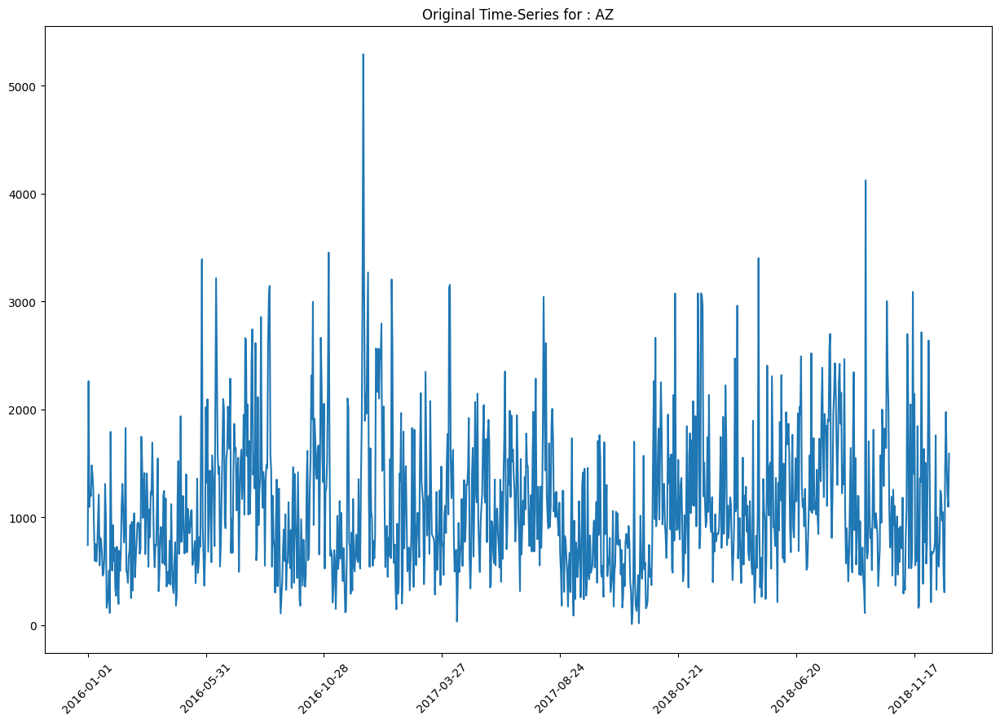

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
recons: [531.2378563332326, 451.78720237214304, 301.55943454240384, 8.301535283928593e-13]


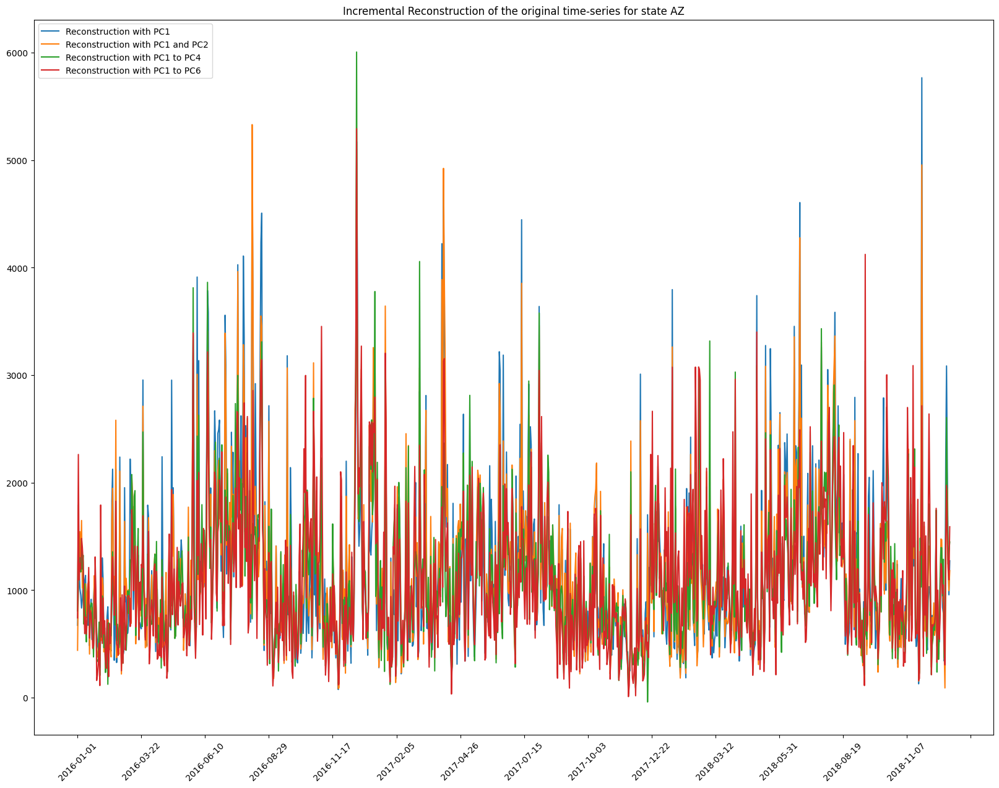

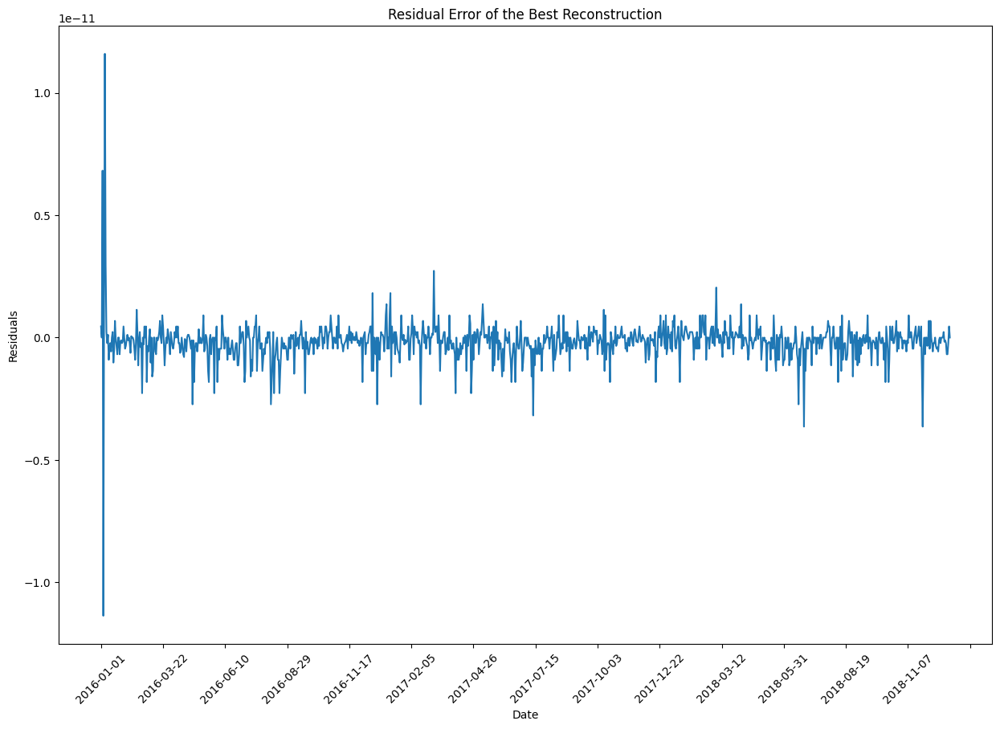

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 3)
proj X shaep: (1, 3)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 5)
proj X shaep: (1, 5)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
w shape: (1095, 7)
proj X shaep: (1, 7)
Recon X shaep: (1, 1095)


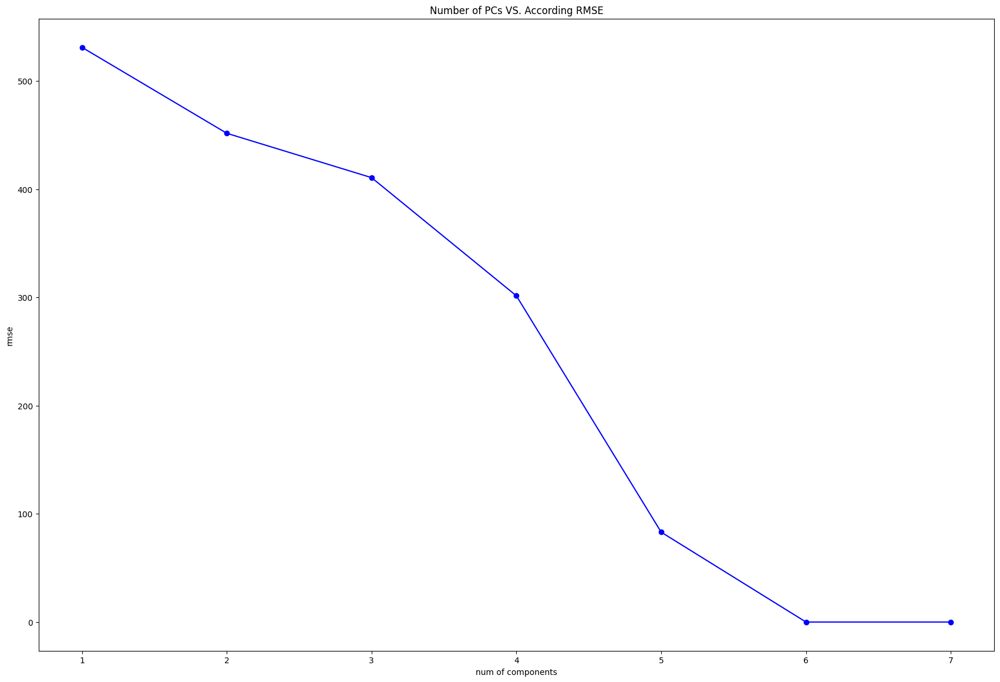

([531.2378563332326,
  451.78720237214304,
  301.55943454240384,
  8.301535283928593e-13],
 array([ 4.54747351e-13,  0.00000000e+00,  6.82121026e-12, ...,
        -2.27373675e-13,  4.54747351e-13,  0.00000000e+00]),
 array([[ 742., 2262., 1095., ..., 1212., 1097., 1590.]]))

In [237]:
# AZ
date_reconstruction(data_raw, "AZ")

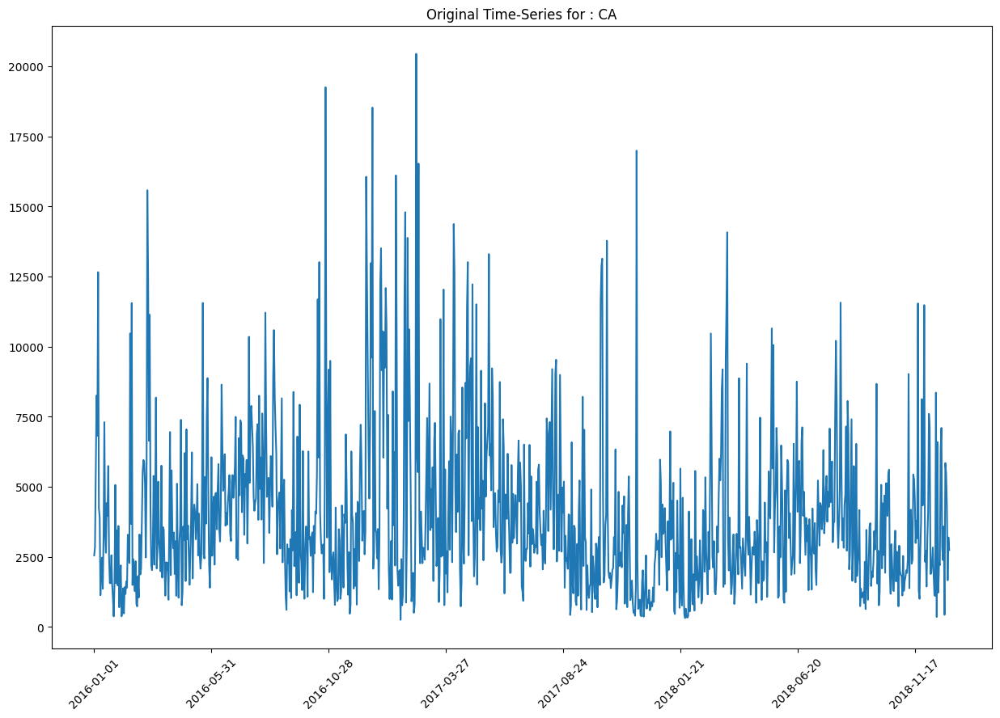

recons: [553.7884337926243, 91.1449869957263, 49.33010924230416, 8.768000024118038e-13]


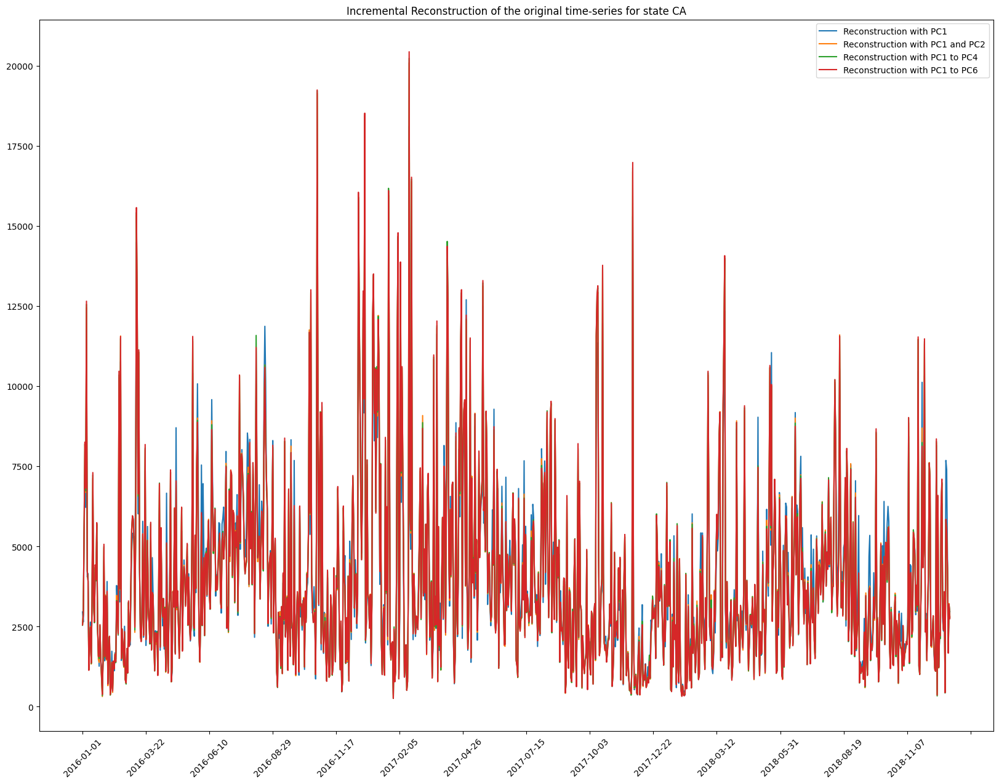

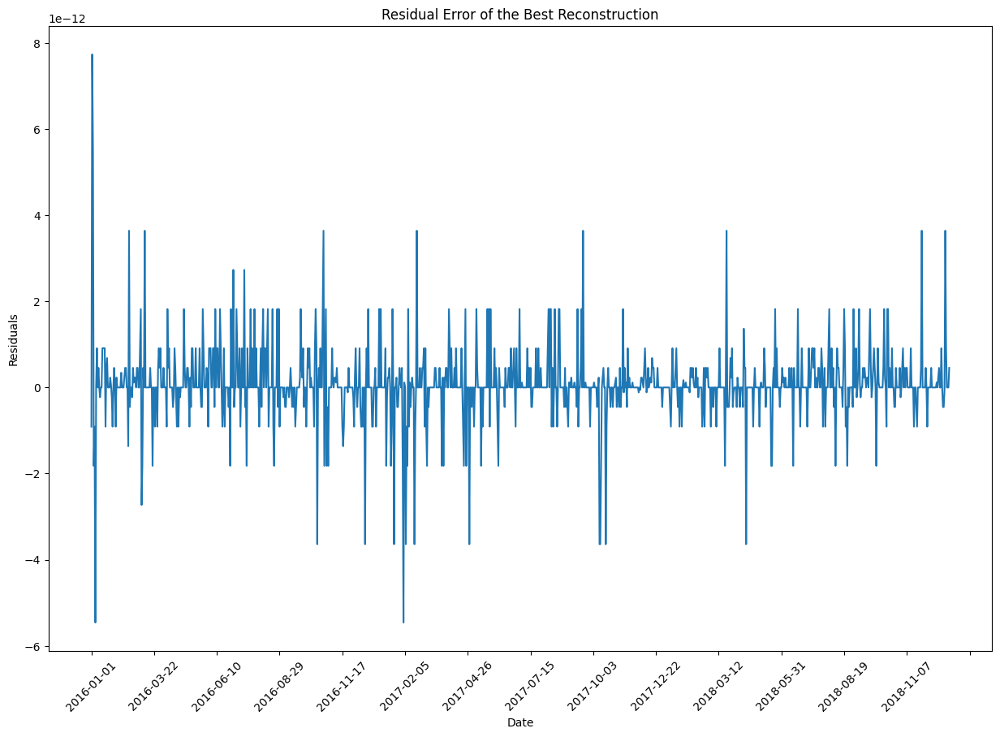

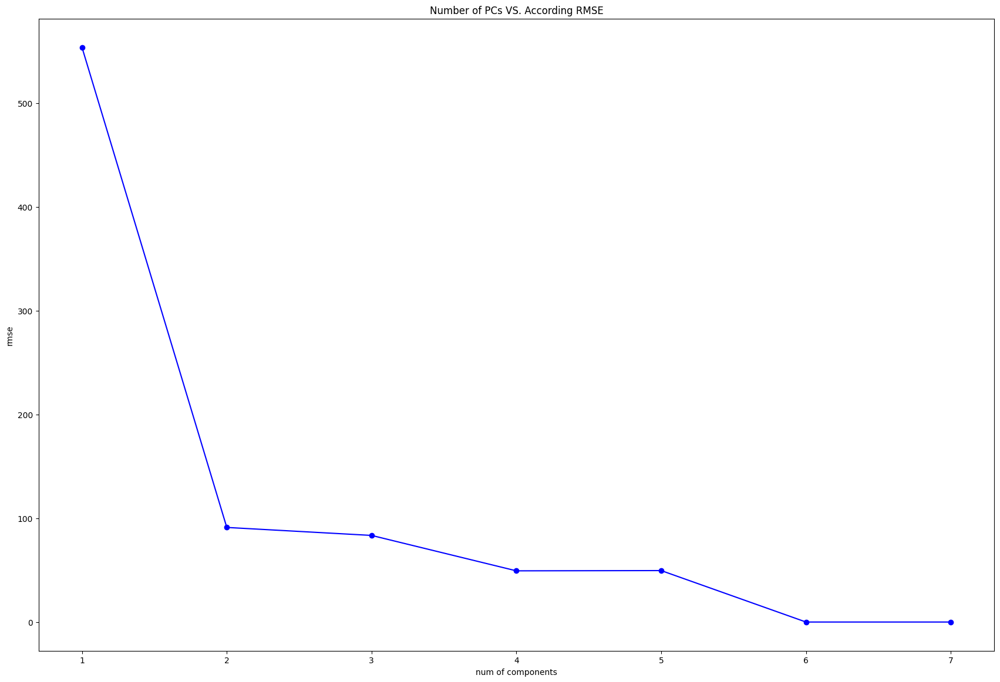

([553.7884337926243,
  91.1449869957263,
  49.33010924230416,
  8.768000024118038e-13],
 array([-9.09494702e-13,  7.73070497e-12,  5.45696821e-12, ...,
         0.00000000e+00,  0.00000000e+00,  4.54747351e-13]),
 array([[2552., 2849., 5492., ..., 1667., 3193., 2744.]]))

In [233]:
# CA
date_reconstruction(data_raw, "CA")

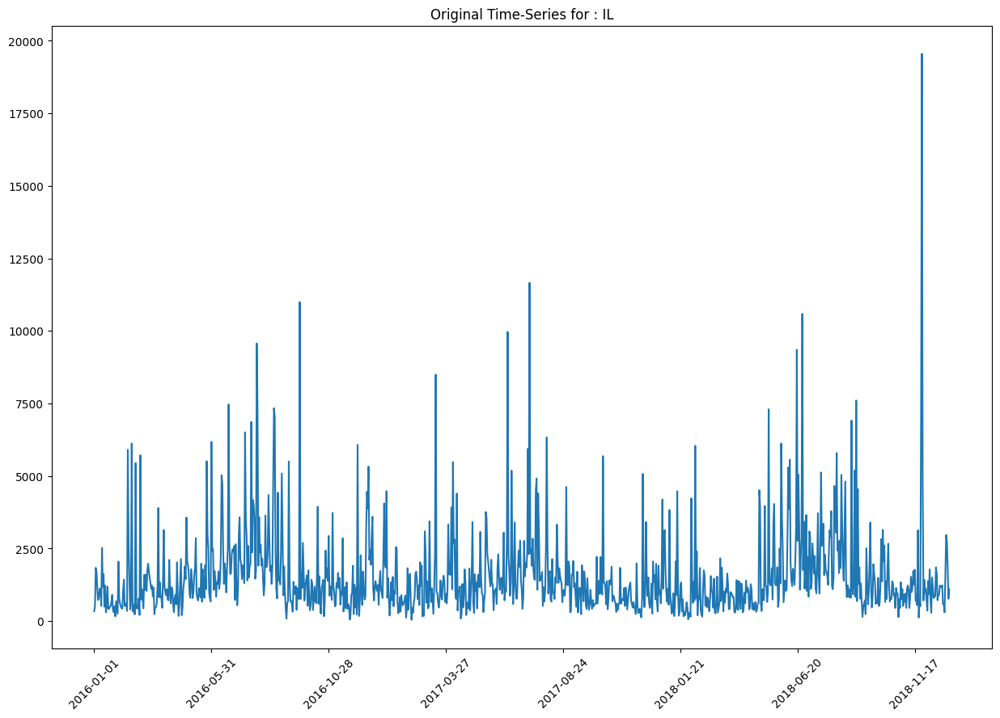

recons: [1020.0830187098478, 987.8167322281594, 41.45732860194495, 1.3166662507491616e-12]


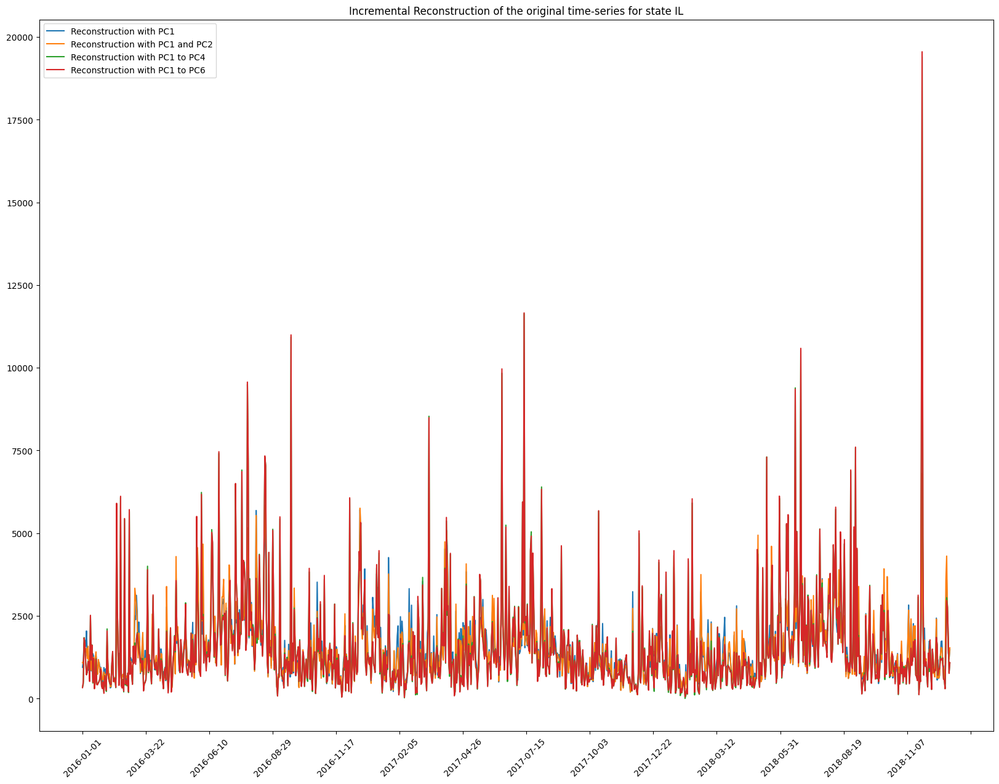

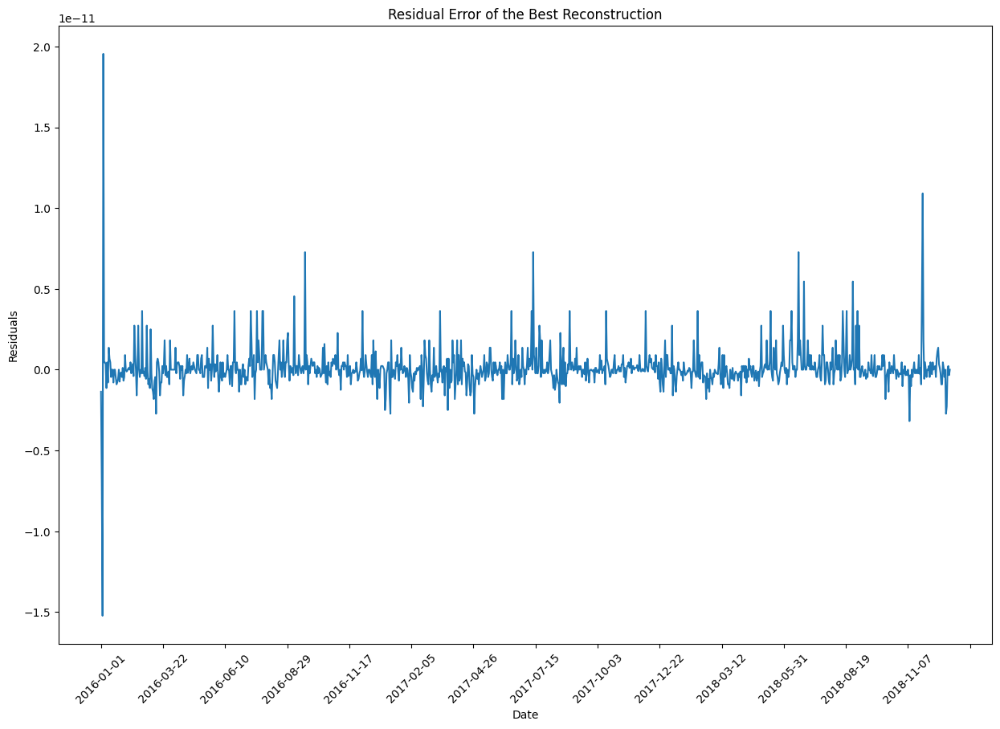

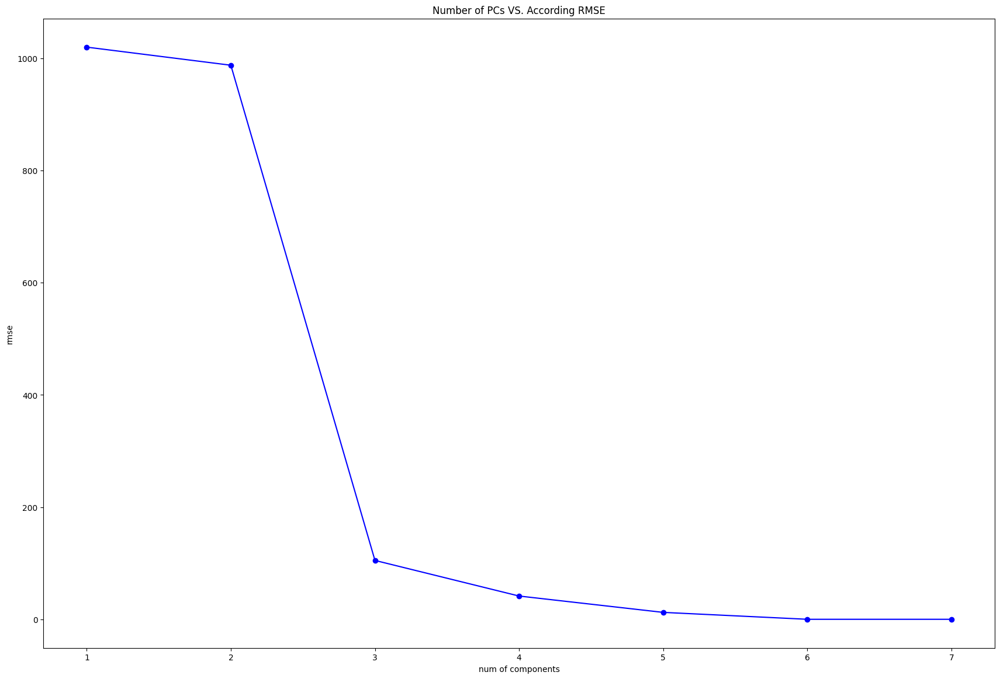

([1020.0830187098478,
  987.8167322281594,
  41.45732860194495,
  1.3166662507491616e-12],
 array([-1.36424205e-12, -6.93489710e-12, -1.52340363e-11, ...,
         2.27373675e-13, -3.41060513e-13,  0.00000000e+00]),
 array([[ 331.,  517., 1831., ..., 1843.,  762., 1090.]]))

In [234]:
# IL
date_reconstruction(data_raw, "IL")

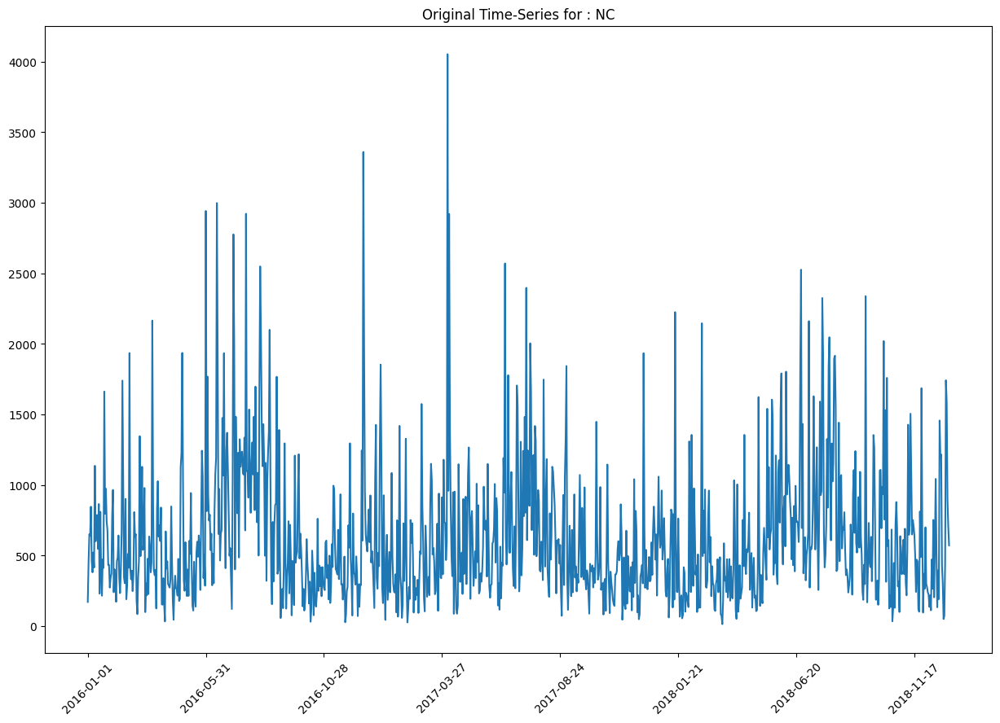

recons: [511.48724297222833, 377.78480160630147, 342.2656590536377, 9.999376271636067e-13]


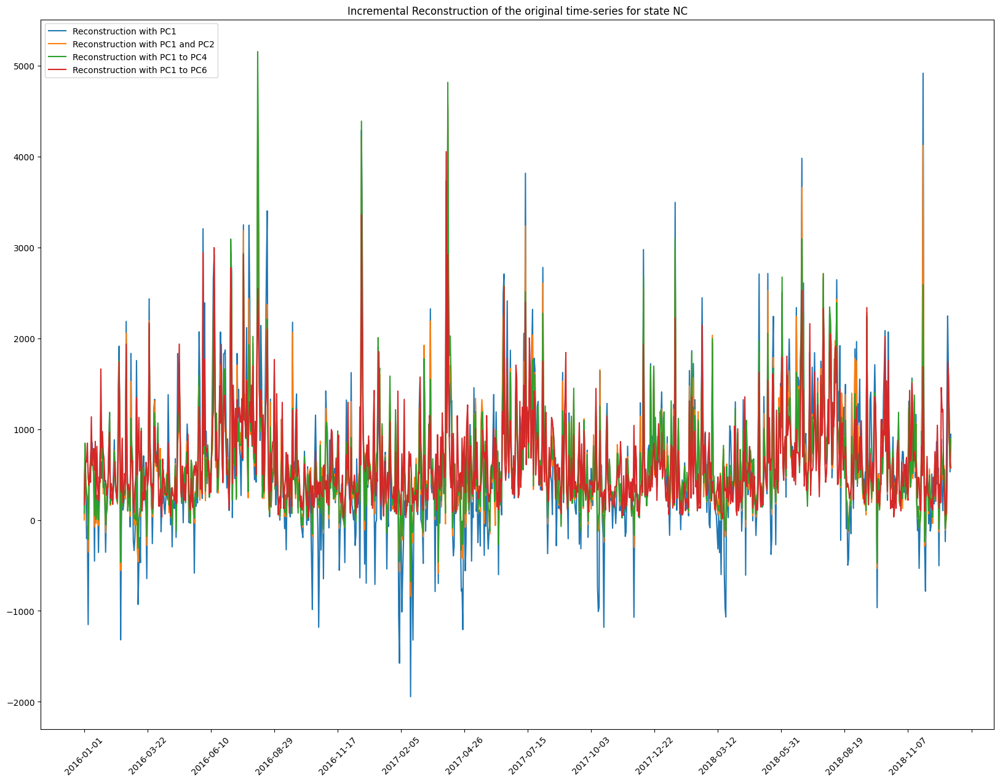

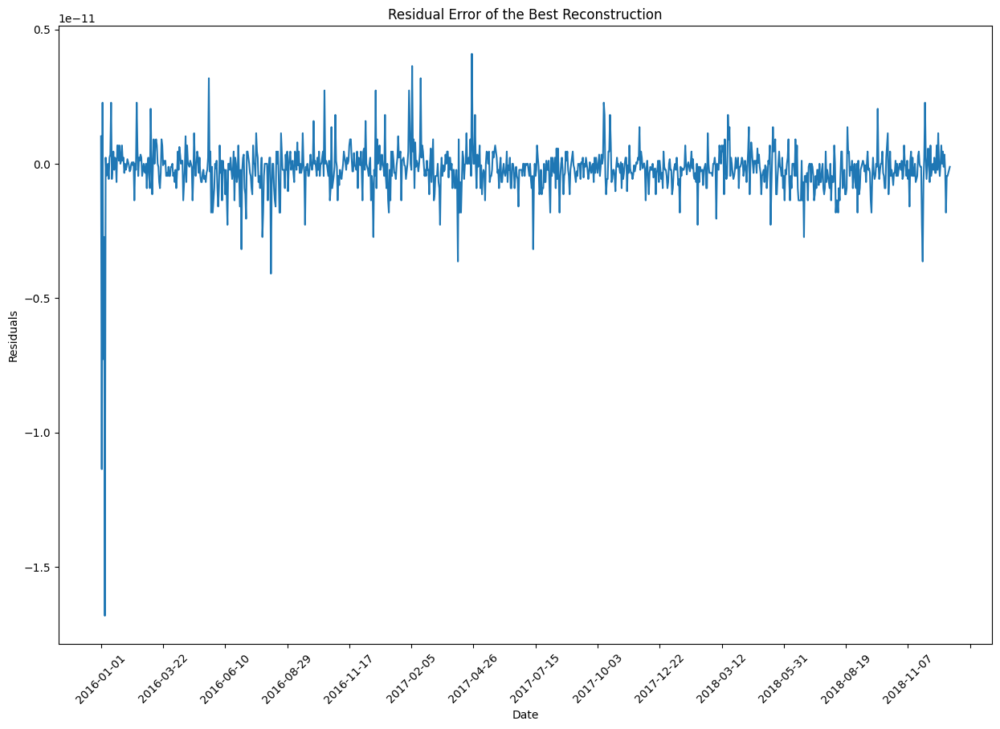

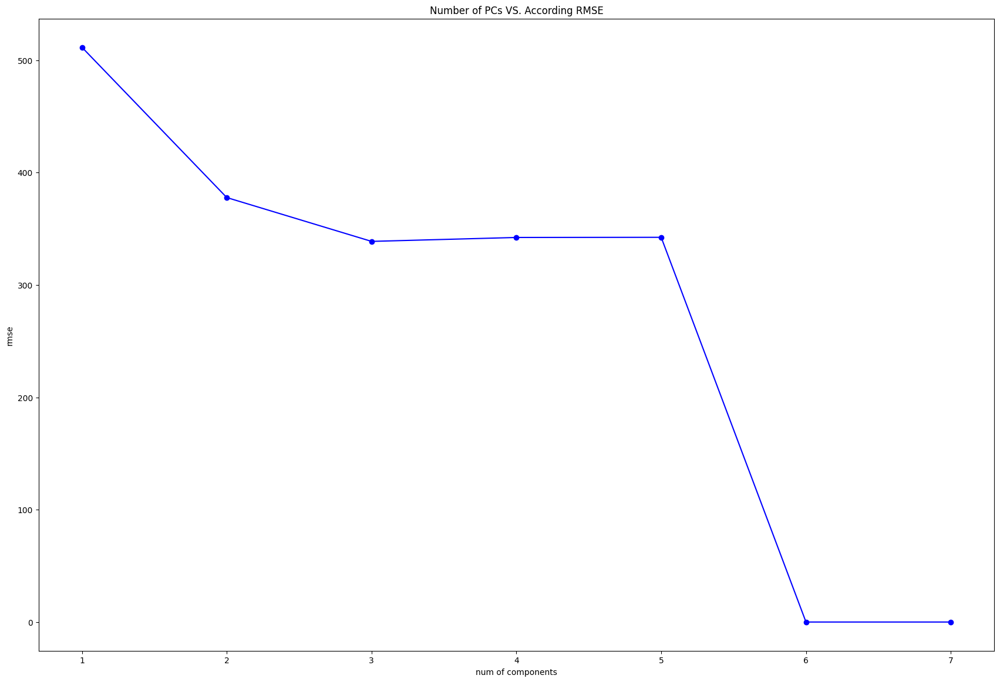

([511.48724297222833,
  377.78480160630147,
  342.2656590536377,
  9.999376271636067e-13],
 array([ 1.02318154e-12, -1.13686838e-11,  2.27373675e-12, ...,
        -3.41060513e-13, -2.27373675e-13, -1.13686838e-13]),
 array([[171., 448., 651., ..., 893., 701., 572.]]))

In [235]:
# NC
date_reconstruction(data_raw, "NC")

# Part 4: SVD [14 Marks]
Modify your code in part 3 to use SVD instead of PCA. **[8]**

Explain if standardization or covariance computation is required for this part.
Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison **[3]**, and comment on the results. **[3]**.

In [112]:
# standard_df.loc["AZ"].values.shape

(1095,)

In [238]:
# helper func for svd
def incremental_recon_svd(U, Sigma, Vh, num_component, state_idx):
    # trunk using [1, 2, 4, 6]
    U_k = U[:, :num_component]
    Sigma_k = np.diag(Sigma[:num_component])
    Vh_k = Vh[:num_component, :]
    
    print(f"shape: Uk: {U_k.shape}, sigmak: {Sigma_k.shape}, Vhk: {Vh_k.shape}")  # debug\
    
    # recon
    ReconX = np.dot(U_k, np.dot(Sigma_k, Vh_k))

    ReconX_single_state = ReconX[state_idx, :]  # Only the reconstructed time-series for the specific state

    # # transform to original state
    # ReconX_original = scaler.inverse_transform(ReconX_single_state.reshape(1, -1))
    
    return ReconX_single_state
    
# helper func 4
def RMSE_svd(df, U, Sigma, Vh, state_idx):
    # 1 to 7 PCs
    num_components = [i for i in range(1, 8)]
    rmse_list = []
    
    # iter from 1 PC to 7 PCs
    for i in range(len(num_components)):
        
        # rmse_list.append(rmse)
        df_recon = incremental_recon_svd(U, Sigma, Vh, num_components[i], state_idx)
        # recon_original = scaler.inverse_transform(df_recon)
        
        rmse = cal_rmse(df.values, df_recon)
        rmse_list.append(rmse)
        
    # plot
    plt.figure(figsize=(21, 14))
    plt.plot(num_components, rmse_list, marker='o', linestyle='-', color='b')
    plt.xlabel("num of components")
    plt.ylabel("rmse")
    plt.title("Number of PCs VS. According RMSE")
    plt.show()

In [152]:
# testing
select_state_data = standard_df.loc["AZ"].values  # shape (1095, )
U, Sigma, Vh = np.linalg.svd(standard_df, full_matrices=False, compute_uv=True)
# Transform X with SVD components
ori = incremental_recon_svd(U, Sigma, Vh, 4, 0)
ori.shape
state_index = [i for i in range(len(data_raw.index)) if data_raw.index[i] == "AZ"]
state_index


shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)


[0]

In [242]:
### YOUR CODE HERE ###
def date_reconstruction_svd(df: pd.DataFrame, destination: str):
    # plot 4 figs:
    # 1. original time-series for 1 state
    help_plot_time_series_state(df, destination)
    
    # # 2. incremental reconstruction on original time series
    # # scale the original data
    # scaler = StandardScaler(copy=True, with_mean=True, with_std=True)
    # scaler.fit(df)
    # standard_data = scaler.transform(df)
    # standard_df = pd.DataFrame(standard_data, index=df.index, columns=df.columns)
    
    # single state
    # select_state_data = standard_df.loc[destination].values  # shape (1095, )
    
    """no cov needed for svd
    according to the helper source link: 
    SVD has also already been implemented in numpy as `np.linalg.svd`. """
    # (m, k) (k, k) (k, n)
    U, Sigma, Vh = np.linalg.svd(df, full_matrices=False, compute_uv=True)
    # # Transform X with SVD components
    # X_svd = np.dot(U, np.diag(Sigma))
    
    # state_index = [i for i in range(len(data_raw.index)) if data_raw.index[i] == destination]
    state_index = data_raw.index.get_loc(destination)
    
    # get back the reconstruced data with diff svds
    # reconsturctions = []
    num_components = [1, 2, 4, 6]
    best_rmse_svd = float('inf')
    best_recon_svd = None
    rmse_svd_list = []
    
    # plot 
    plt.figure(figsize=(20, 15))
    for i in range(len(num_components)):
        
        recon_svd_original = incremental_recon_svd(U, Sigma, Vh, num_components[i], state_index)
        
        # cal the rmse of each recon
        rmse_svd = cal_rmse(df.loc[destination].values, recon_svd_original)
        rmse_svd_list.append(rmse_svd)
            
        # plot for svd
        plt.plot(df.columns, recon_svd_original, label=f'Reconstruction with {num_components[i]} components')
        
        # find the best recon
        if (rmse_svd < best_rmse_svd):
            best_rmse_svd = rmse_svd
            best_recon_svd = recon_svd_original
    
    print(f"recons: {rmse_svd_list}, best: {best_rmse_svd}")  # debug

    plt.title(f"Incremental Reconstruction of the original time-series for state {destination}")
    plt.tick_params(axis='x', rotation=45)
        
    # Set the x-axis tick frequency
    plt.gca().xaxis.set_major_locator(MaxNLocator(nbins=20))  # Adjust nbins to set the desired number of ticks
    plt.legend()
    plt.show()
    
    # 3. residual err
    # use RMSE to find the best reconstruction at above
    residual_err = residual_error(df.loc[destination], df.columns, best_recon_svd)
    
    # 4. RMSE
    # seperate with 3.2
    RMSE_svd(df.loc[destination], U, Sigma, Vh, state_index)
    
    return rmse_svd_list, residual_err, best_recon_svd
    

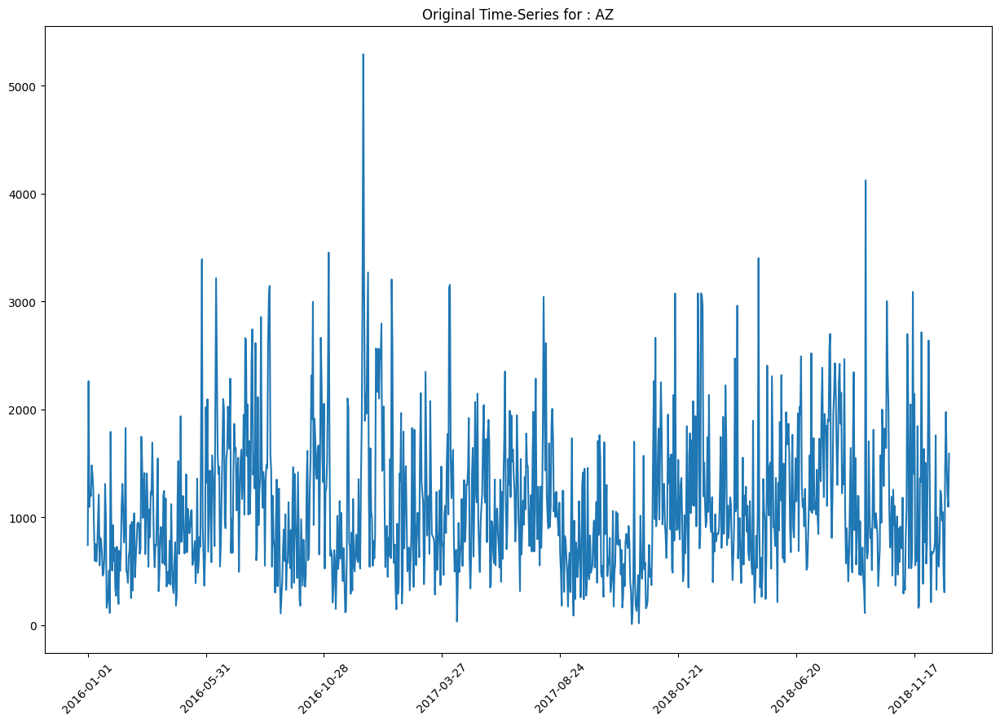

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [492.21188117185113, 465.53392233347813, 463.20545837114304, 47.79500136532656], best: 47.79500136532656


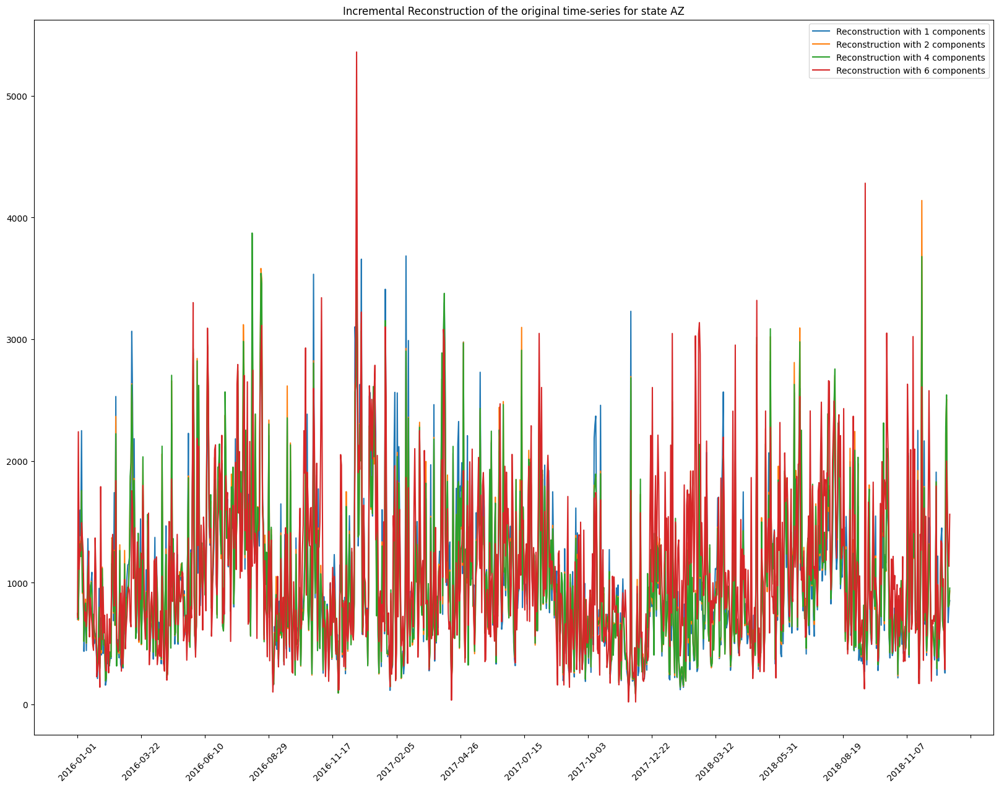

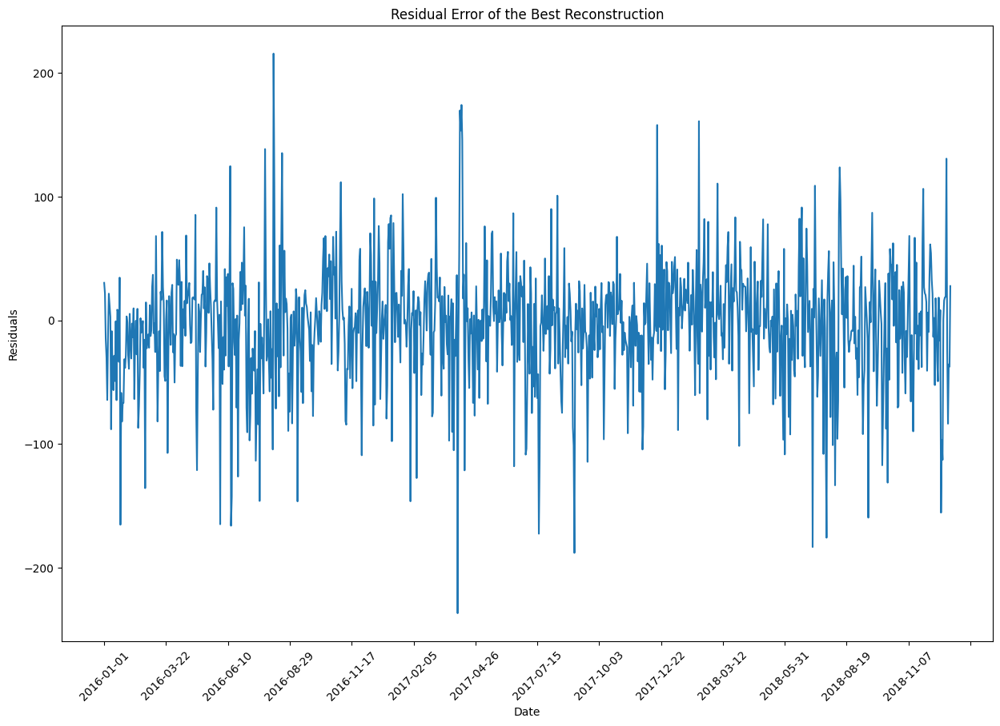

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


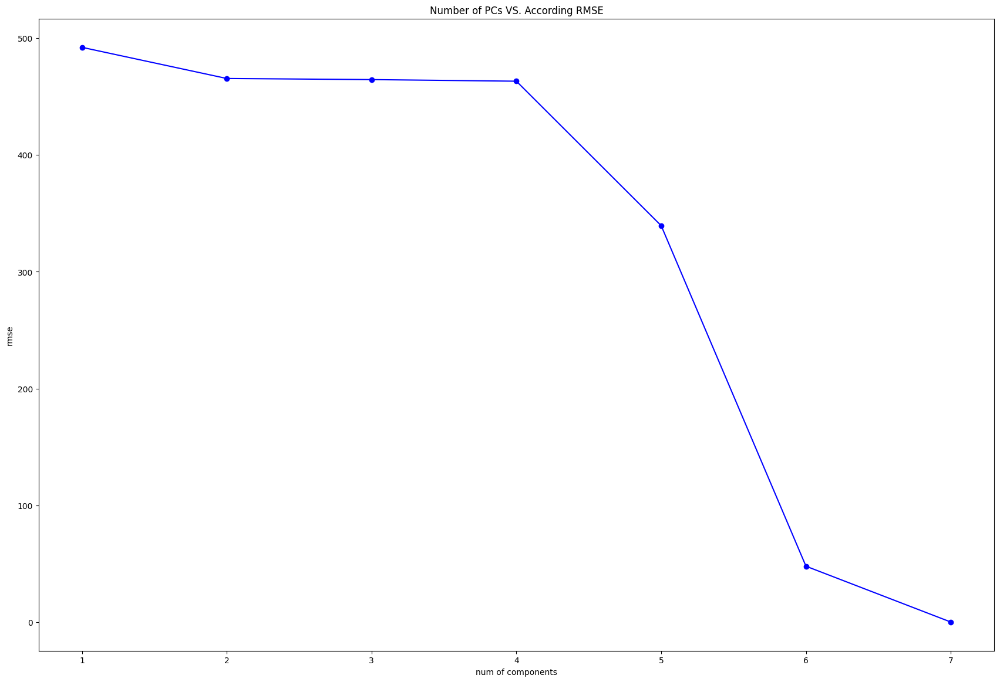

([492.21188117185113,
  465.53392233347813,
  463.20545837114304,
  47.79500136532656],
 array([ 30.23077479,  21.68248499, -14.85272714, ..., -35.6104659 ,
        -37.55166987,  27.62378861]),
 array([ 711.76922521, 2240.31751501, 1109.85272714, ..., 1247.6104659 ,
        1134.55166987, 1562.37621139]))

In [245]:
# AZ
date_reconstruction_svd(data_raw, "AZ")

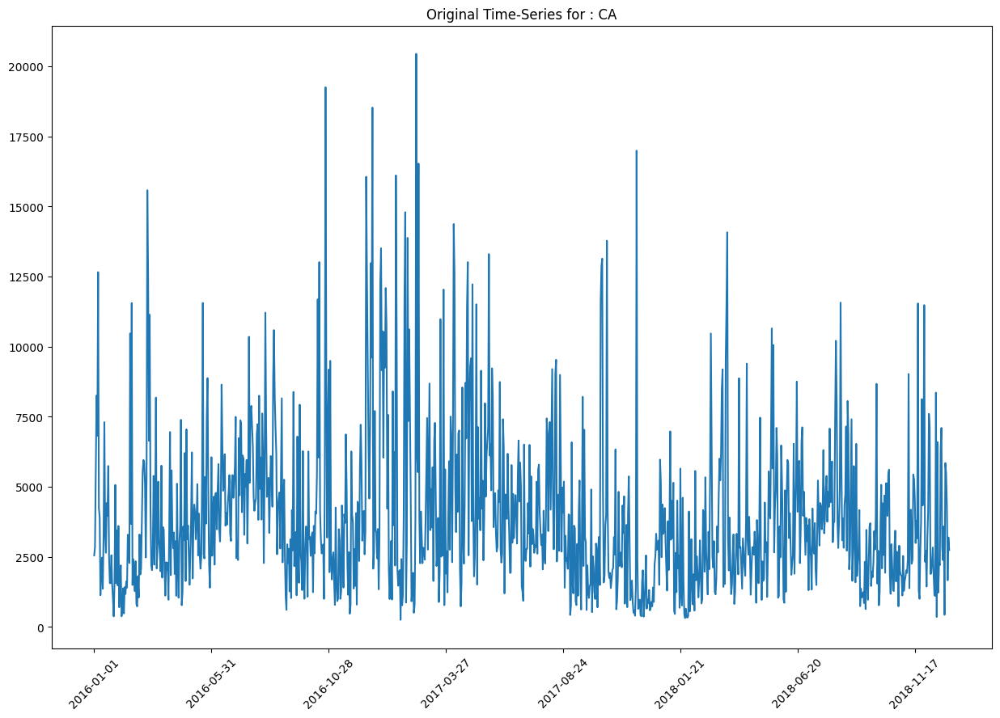

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [1132.5979628704329, 84.50054199763524, 78.31838242546445, 6.108042919387638], best: 6.108042919387638


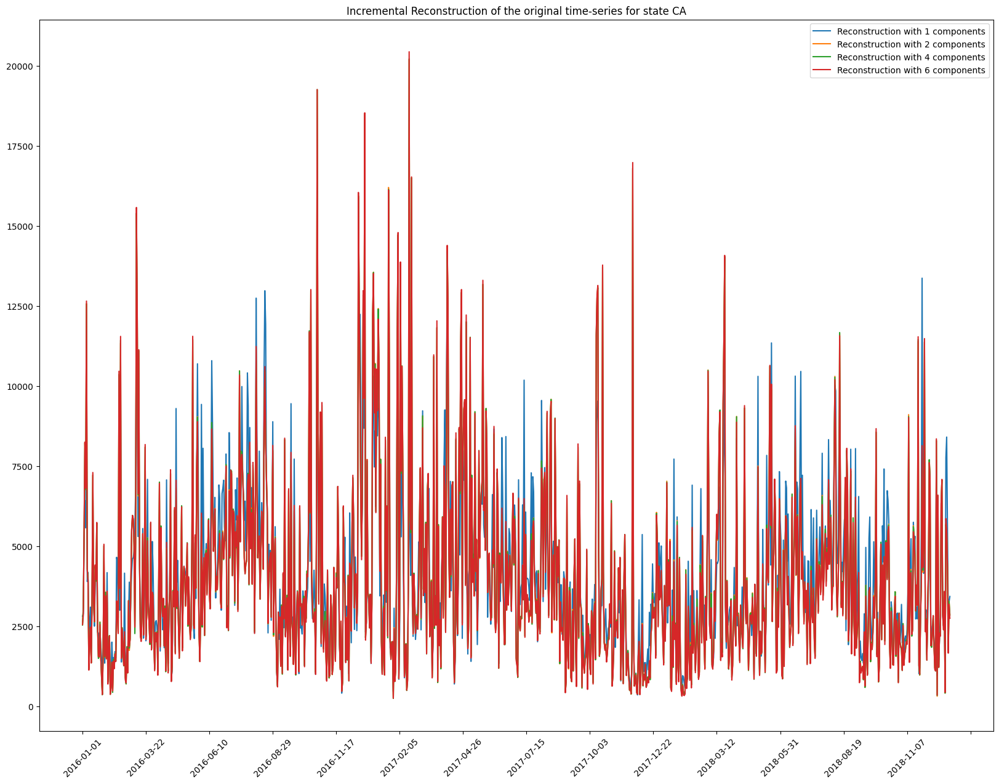

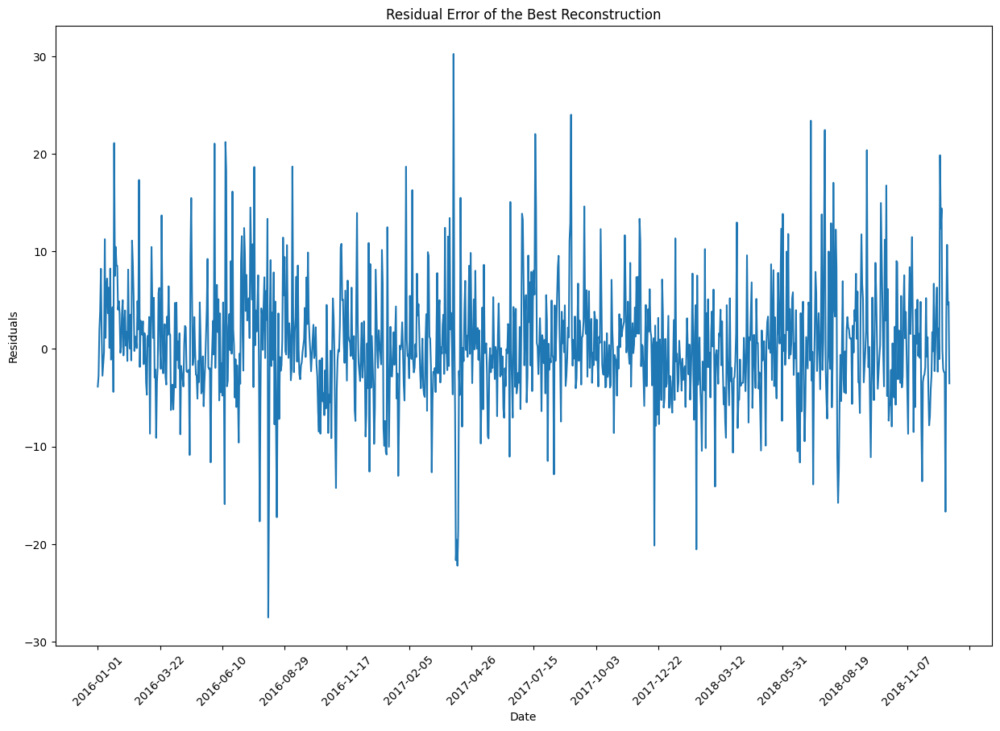

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


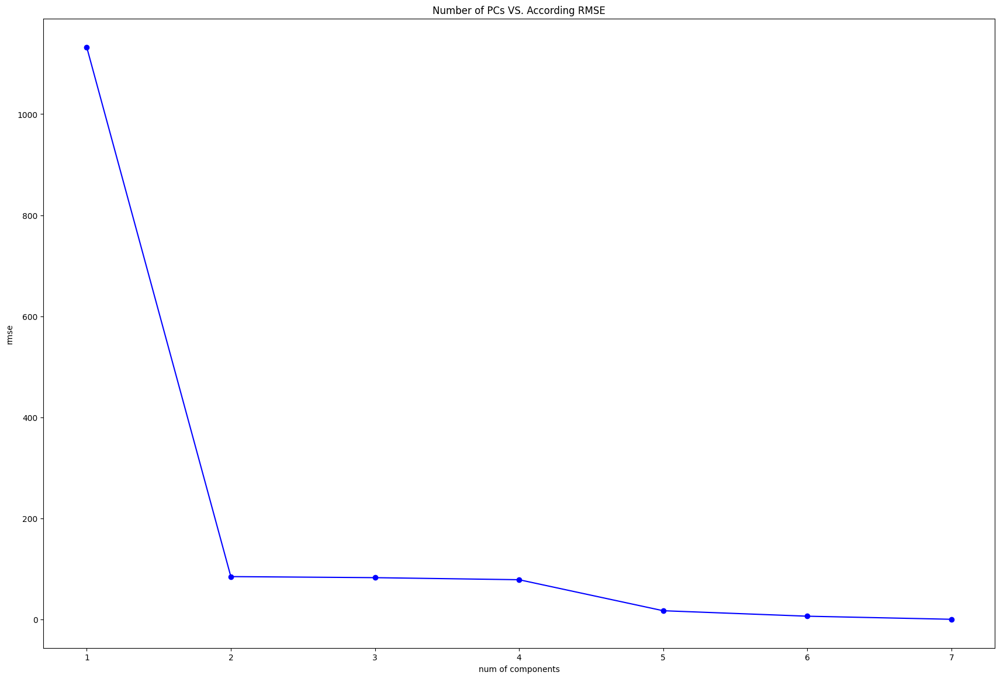

([1132.5979628704329, 84.50054199763524, 78.31838242546445, 6.108042919387638],
 array([-3.86339292, -2.77094979,  1.89812935, ...,  4.55089963,
         4.79897907, -3.53022872]),
 array([2555.86339292, 2851.77094979, 5490.10187065, ..., 1662.44910037,
        3188.20102093, 2747.53022872]))

In [244]:
# CA
date_reconstruction_svd(data_raw, "CA")

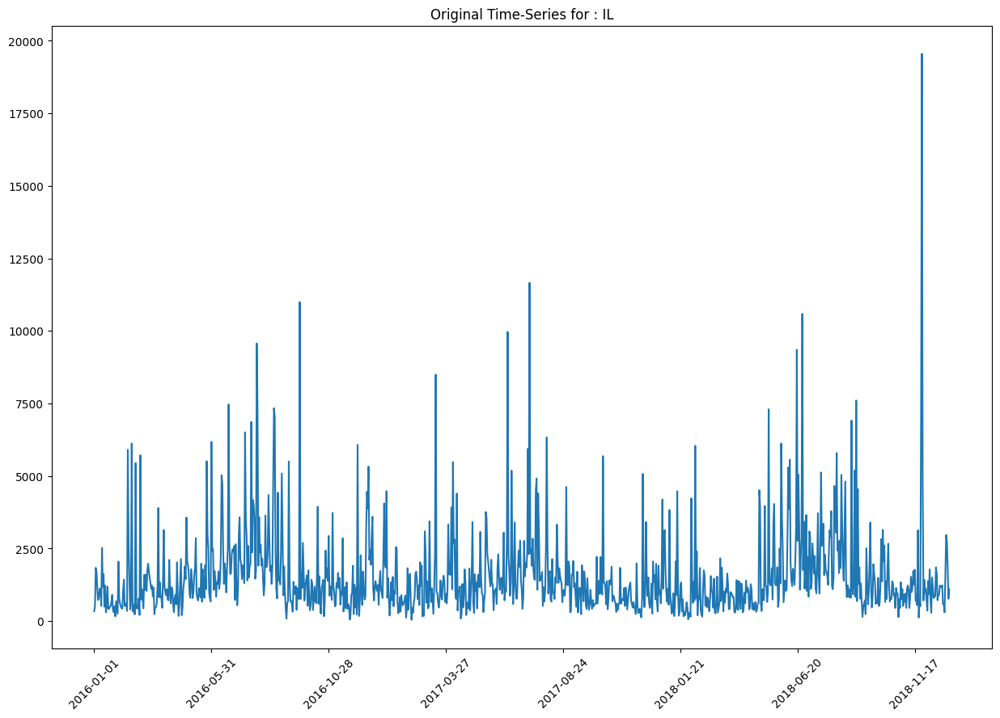

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [1221.3739788116322, 894.564095454139, 81.07078743211365, 9.189670307407297], best: 9.189670307407297


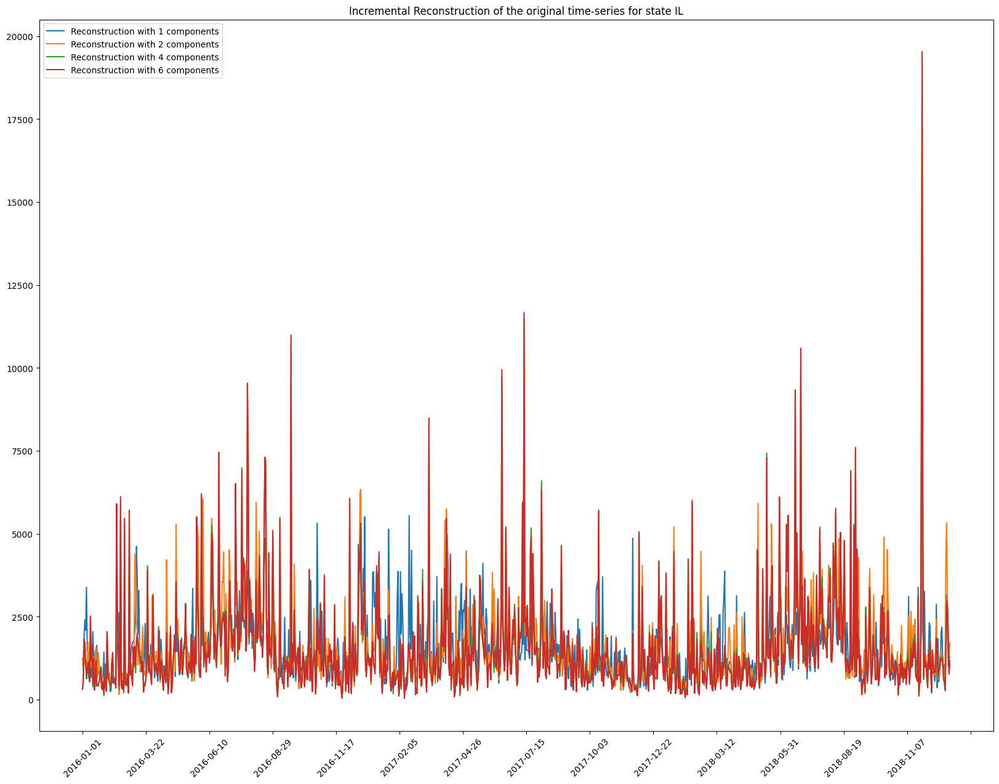

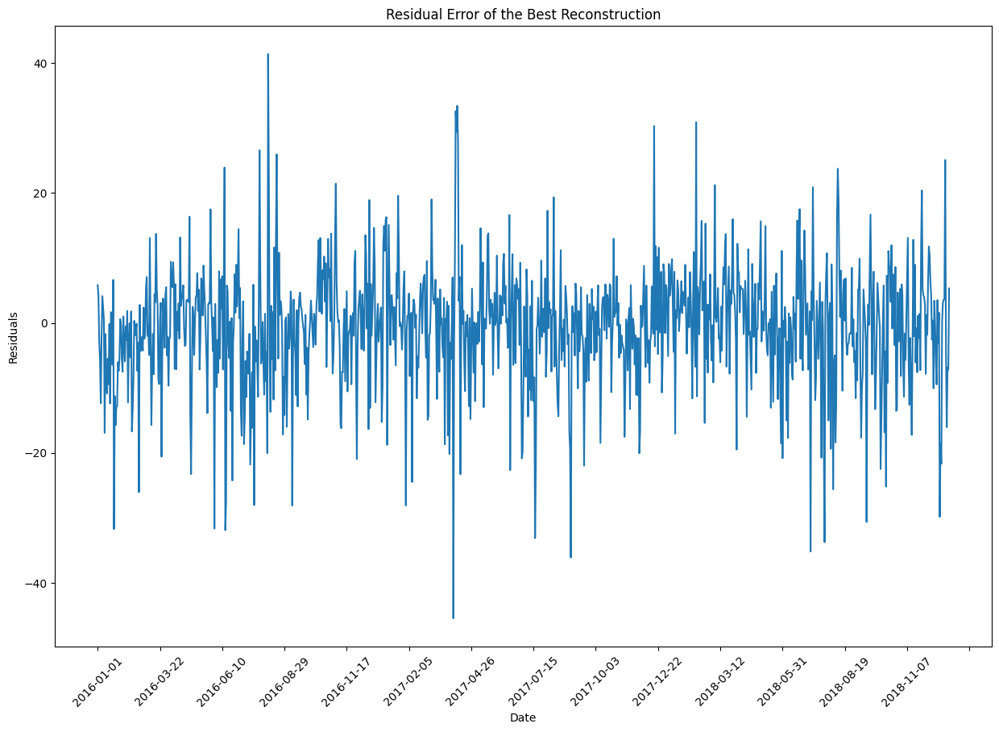

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


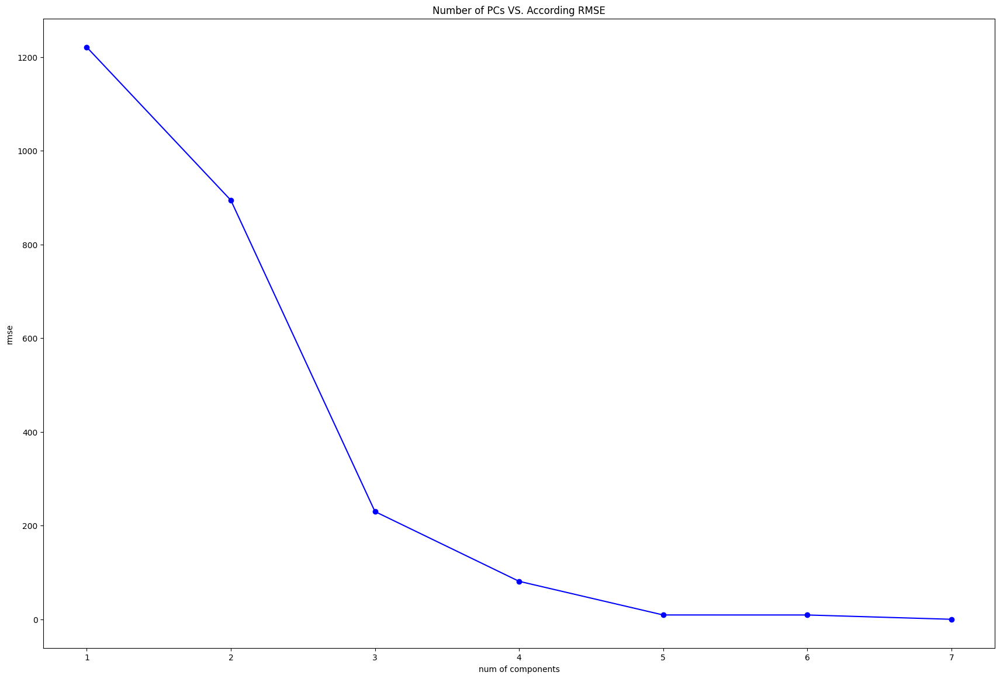

([1221.3739788116322, 894.564095454139, 81.07078743211365, 9.189670307407297],
 array([ 5.81255038,  4.16894828, -2.85577281, ..., -6.84691771,
        -7.22015809,  5.31129831]),
 array([ 325.18744962,  512.83105172, 1833.85577281, ..., 1849.84691771,
         769.22015809, 1084.68870169]))

In [246]:
# IL
date_reconstruction_svd(data_raw, "IL")

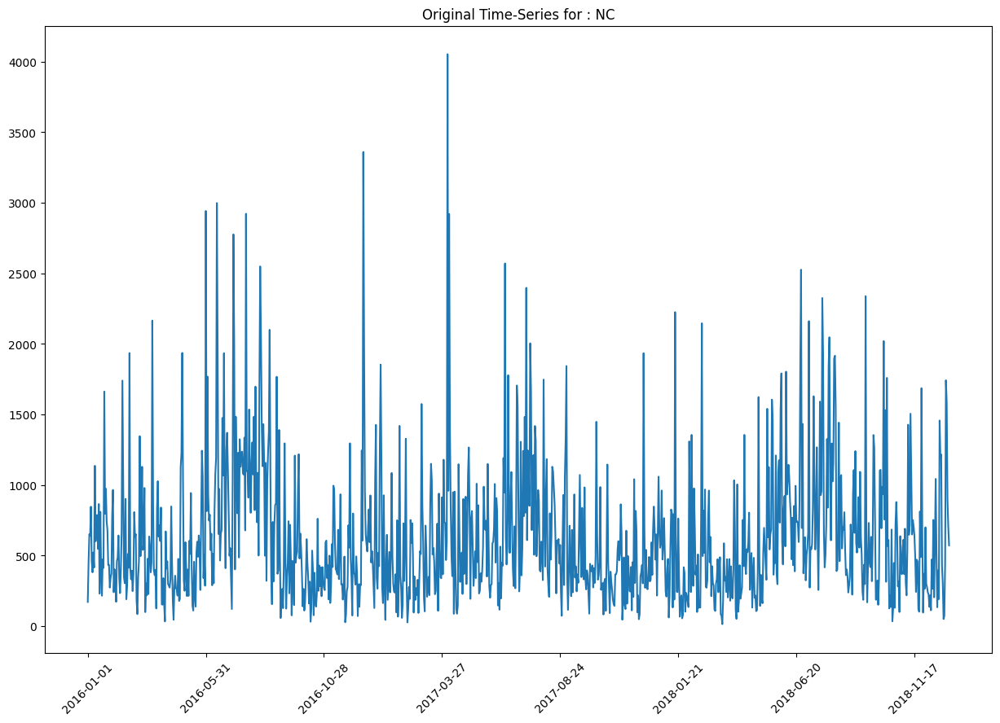

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [425.07187066483357, 330.6182481493101, 293.68882649934926, 286.86810957290874], best: 286.86810957290874


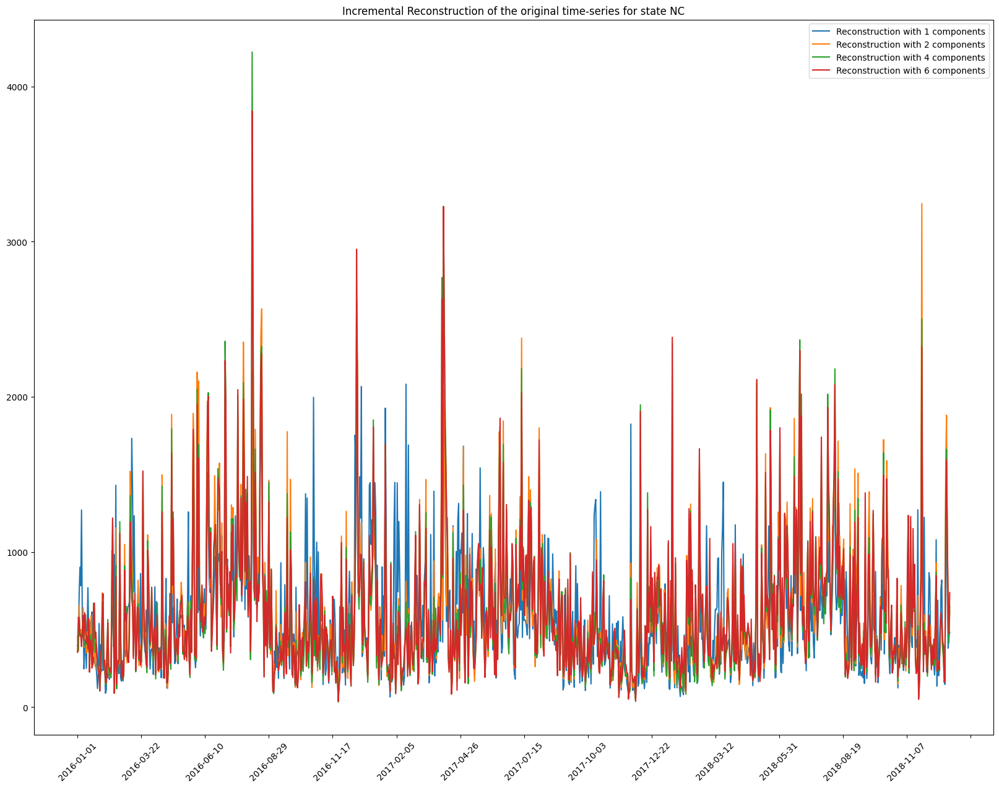

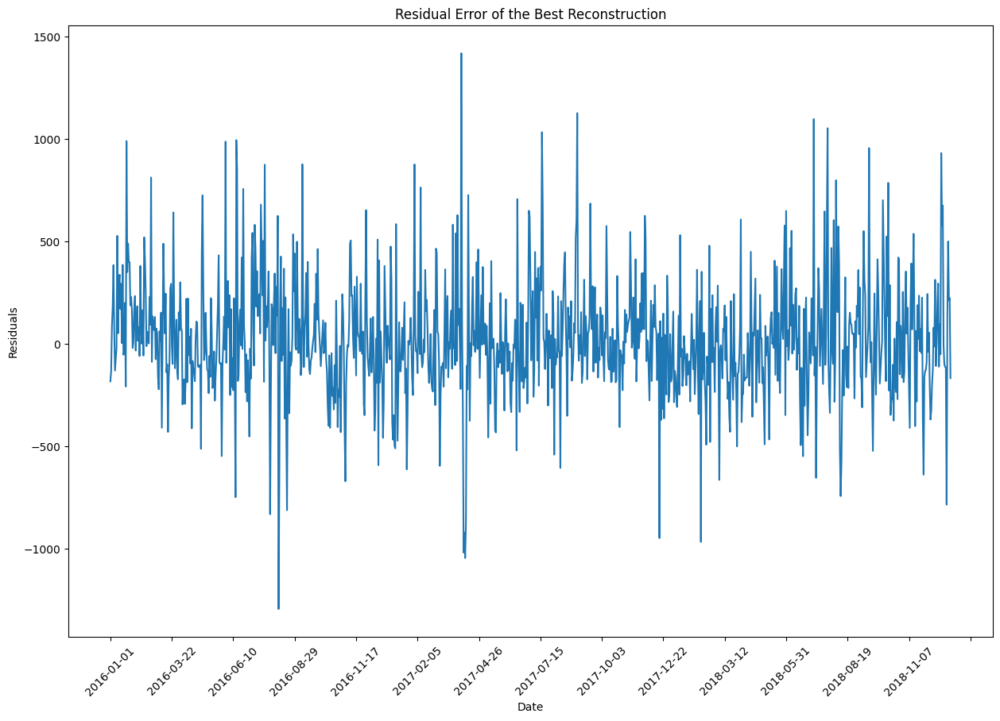

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


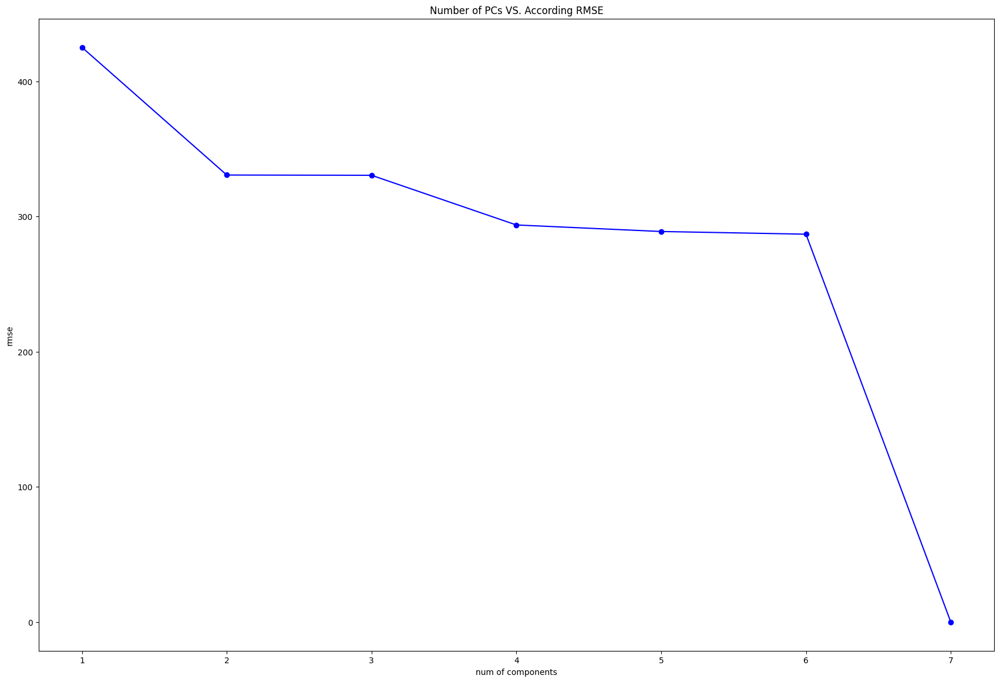

([425.07187066483357,
  330.6182481493101,
  293.68882649934926,
  286.86810957290874],
 array([-181.44669878, -130.13941422,   89.14684871, ...,  213.7358875 ,
         225.3870957 , -165.79943073]),
 array([352.44669878, 578.13941422, 561.85315129, ..., 679.2641125 ,
        475.6129043 , 737.79943073]))

In [247]:
# NC
date_reconstruction_svd(data_raw, "NC")

Explaination:

Standardization is not required for SVD, since SVD do not care about the relevat variance of the feature. Instead, it just decompose the data into `(U, sigma, Wh)` and does not care about the how large or small the values are in each feature. Also, covariance matrix is not needed for SVD. Since according to the definition of SVD, it apply directly to the matrix (in the form U sigma Vh).

In [251]:
# compare results from PCA and SVD
# we add a return for both pca and svd function so we can compare them.
def compare_PCA_SVD(df: pd.DataFrame, destination: str):
    # pca
    rmse_pca_list, residual_pca, best_recon_pca = date_reconstruction(df, destination)
    
    # svd
    rmse_svd_list, residual_svd, best_recon_svd = date_reconstruction_svd(df, destination)
    
    # num_components = [1, 2, 4, 6]
    print(f"for state {destination}:\n")
    
    # Compare RMSE lists
    print("RMSE Comparison:")
    print(f"PCA RMSEs: {rmse_pca_list}")
    print(f"SVD RMSEs: {rmse_svd_list}")

    # PCA residuals
    pca_residual_mean = np.mean(residual_pca)
    pca_residual_std = np.std(residual_pca)
    pca_residual_max = np.max(residual_pca)
    pca_residual_min = np.min(residual_pca)

    # SVD residuals
    svd_residual_mean = np.mean(residual_svd)
    svd_residual_std = np.std(residual_svd)
    svd_residual_max = np.max(residual_svd)
    svd_residual_min = np.min(residual_svd)
    
    print("\nResidual Error Summary:")
    print(f"PCA Residuals - Mean: {pca_residual_mean}, Std: {pca_residual_std}, Max: {pca_residual_max}, Min: {pca_residual_min}")
    print(f"SVD Residuals - Mean: {svd_residual_mean}, Std: {svd_residual_std}, Max: {svd_residual_max}, Min: {svd_residual_min}")
    
    # RMSE for Best Reconstruction
    rmse_best_pca = cal_rmse(df.loc[destination].values, best_recon_pca.flatten())
    rmse_best_svd = cal_rmse(df.loc[destination].values, best_recon_svd)
    
    print("\nRMSE for Best Reconstruction:")
    print(f"PCA Best Reconstruction RMSE: {rmse_best_pca}")
    print(f"SVD Best Reconstruction RMSE: {rmse_best_svd}")
    
    # Return the compared vals
    return {
        'rmse_pca_list': rmse_pca_list,
        'residual_pca': residual_pca,
        'best_recon_pca': best_recon_pca,
        'rmse_svd_list': rmse_svd_list,
        'residual_svd': residual_svd,
        'best_recon_svd': best_recon_svd,
        'pca_residual_summary': {
            'mean': pca_residual_mean,
            'std': pca_residual_std,
            'max': pca_residual_max,
            'min': pca_residual_min
        },
        'svd_residual_summary': {
            'mean': svd_residual_mean,
            'std': svd_residual_std,
            'max': svd_residual_max,
            'min': svd_residual_min
        },
        'rmse_best_pca': rmse_best_pca,
        'rmse_best_svd': rmse_best_svd
    }

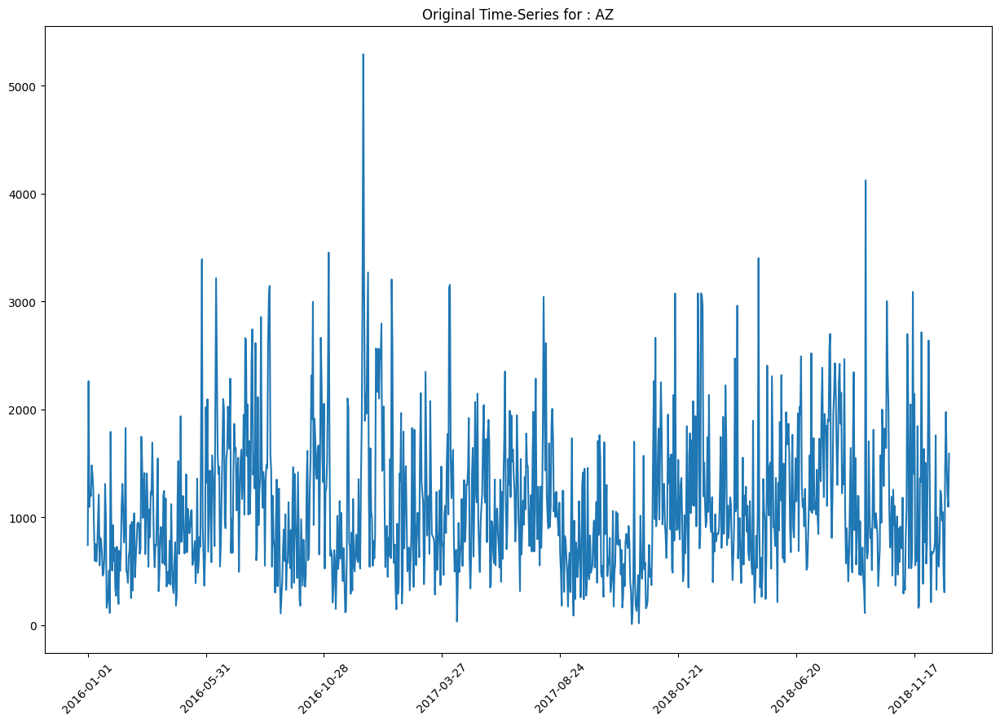

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
recons: [531.2378563332326, 451.78720237214304, 301.55943454240384, 8.301535283928593e-13]


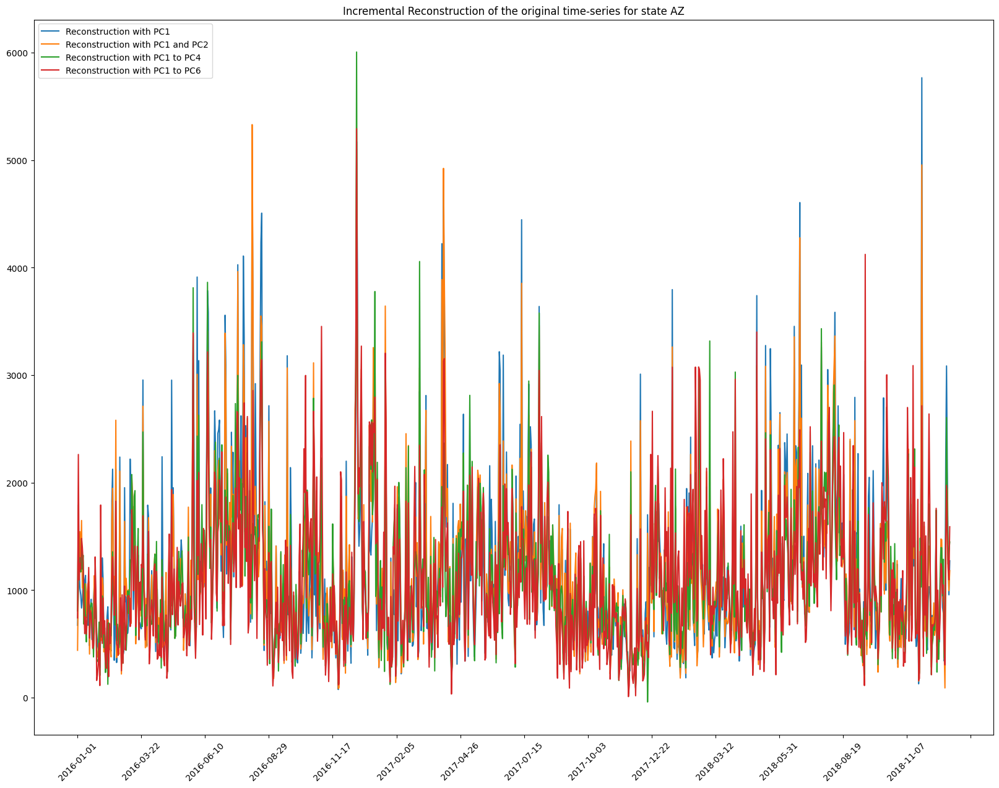

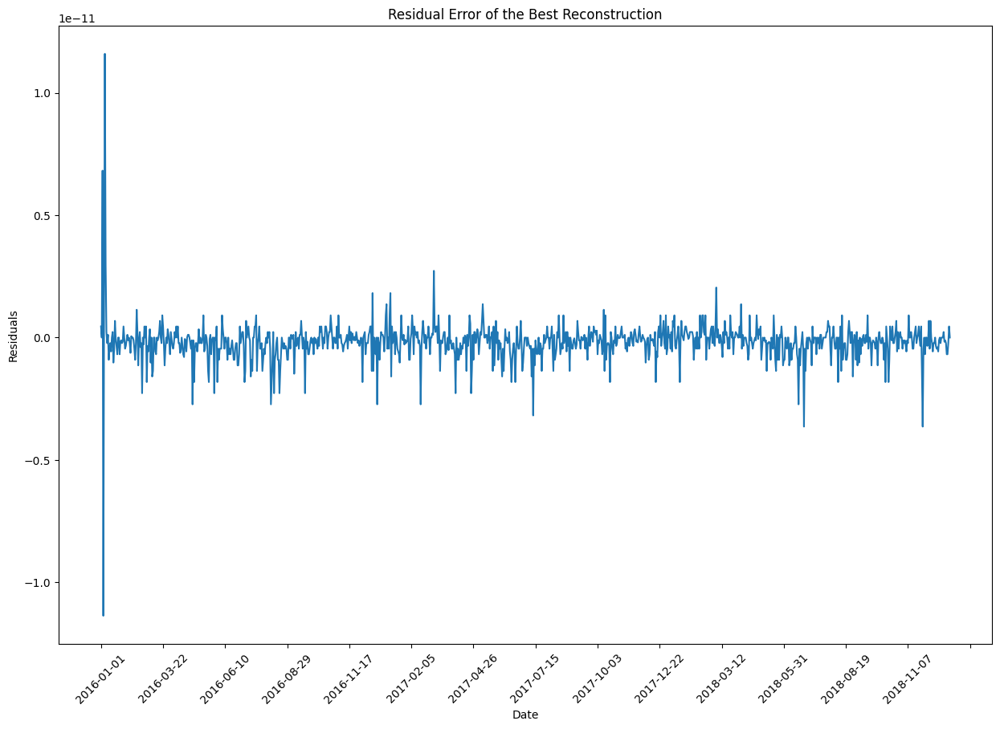

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 3)
proj X shaep: (1, 3)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 5)
proj X shaep: (1, 5)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
w shape: (1095, 7)
proj X shaep: (1, 7)
Recon X shaep: (1, 1095)


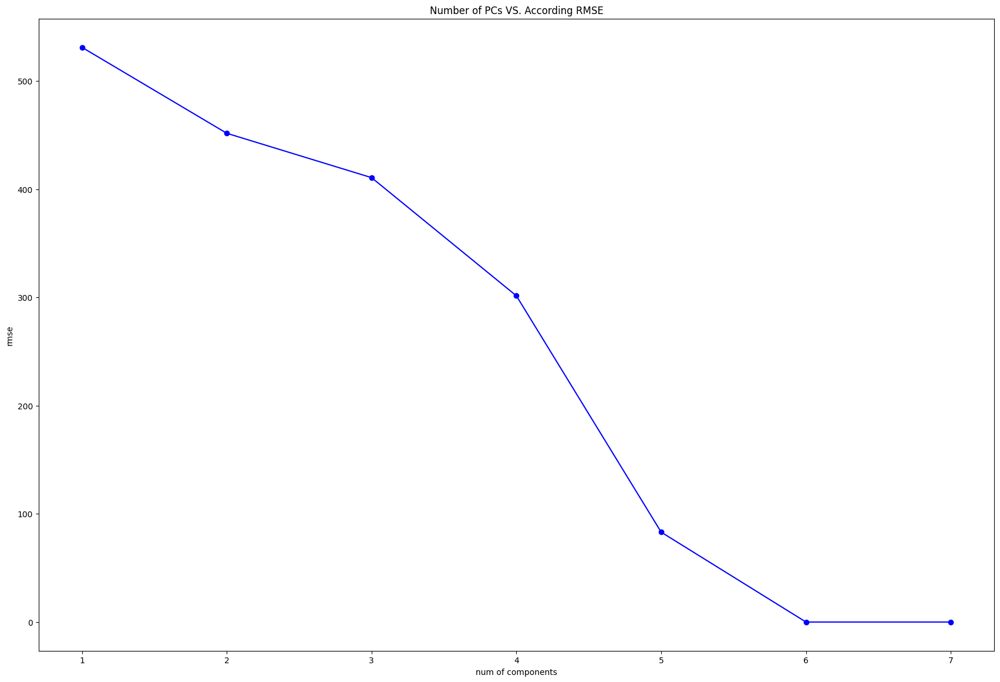

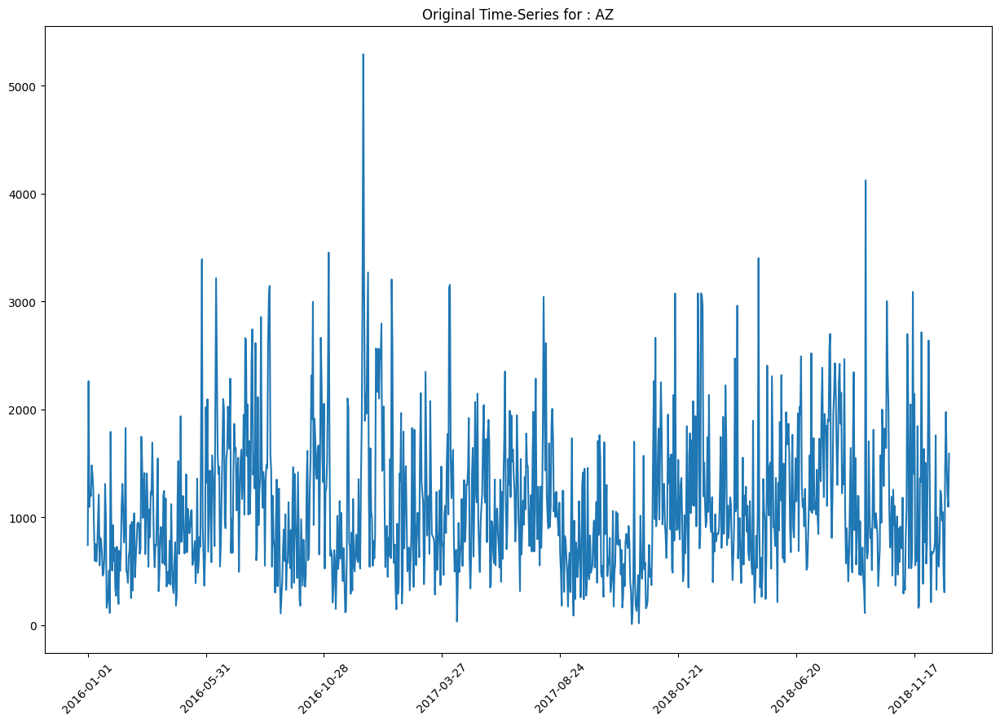

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [492.21188117185113, 465.53392233347813, 463.20545837114304, 47.79500136532656], best: 47.79500136532656


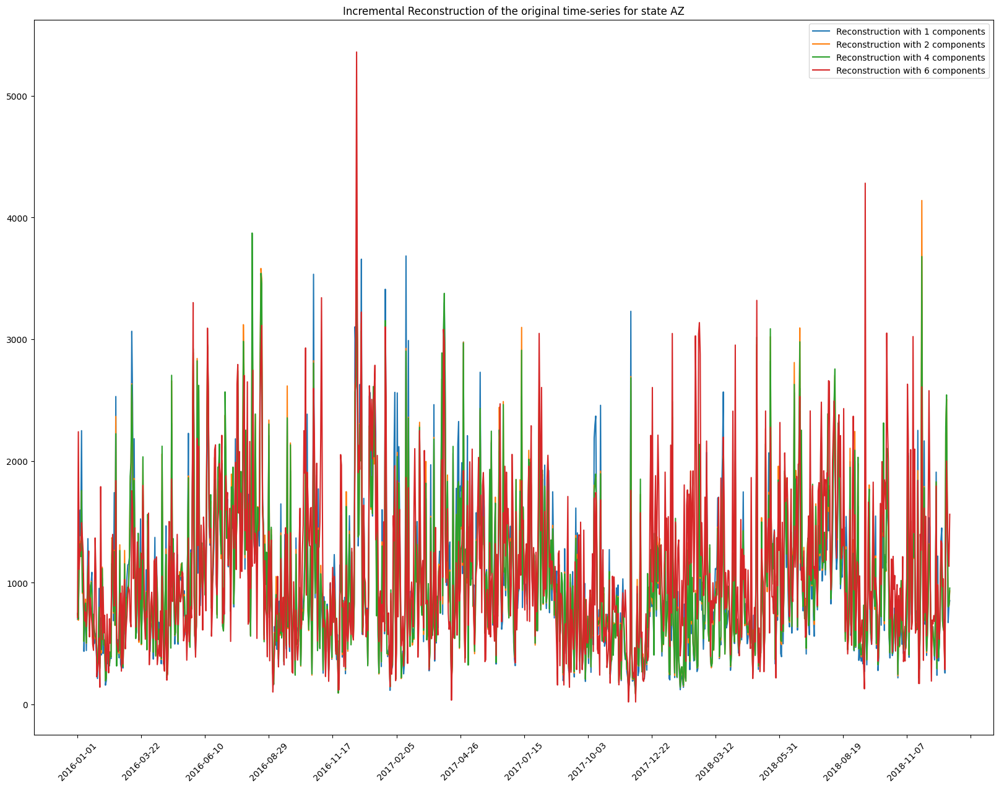

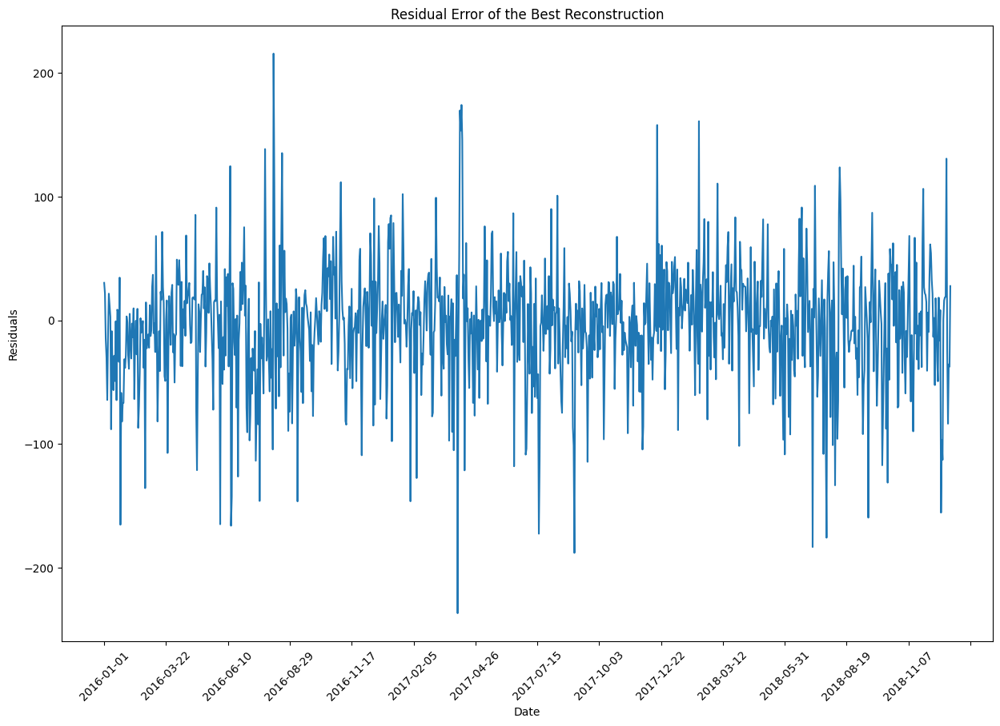

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


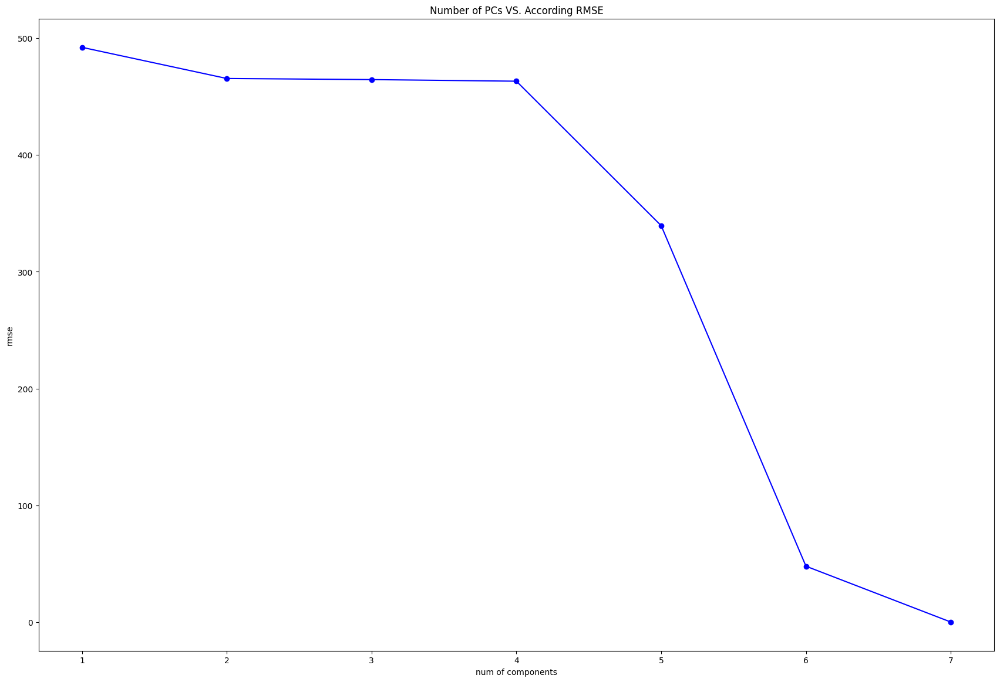

for state AZ:

RMSE Comparison:
PCA RMSEs: [531.2378563332326, 451.78720237214304, 301.55943454240384, 8.301535283928593e-13]
SVD RMSEs: [492.21188117185113, 465.53392233347813, 463.20545837114304, 47.79500136532656]

Residual Error Summary:
PCA Residuals - Mean: -1.8605188419829766e-13, Std: 8.090362025826638e-13, Max: 1.1596057447604835e-11, Min: -1.1368683772161603e-11
SVD Residuals - Mean: -3.7127850557910955, Std: 47.65057588992038, Max: 215.39171324372387, Min: -236.64201489402444

RMSE for Best Reconstruction:
PCA Best Reconstruction RMSE: 8.301535283928593e-13
SVD Best Reconstruction RMSE: 47.79500136532656


In [252]:
# AZ
compared_vals_AZ = compare_PCA_SVD(data_raw, "AZ")

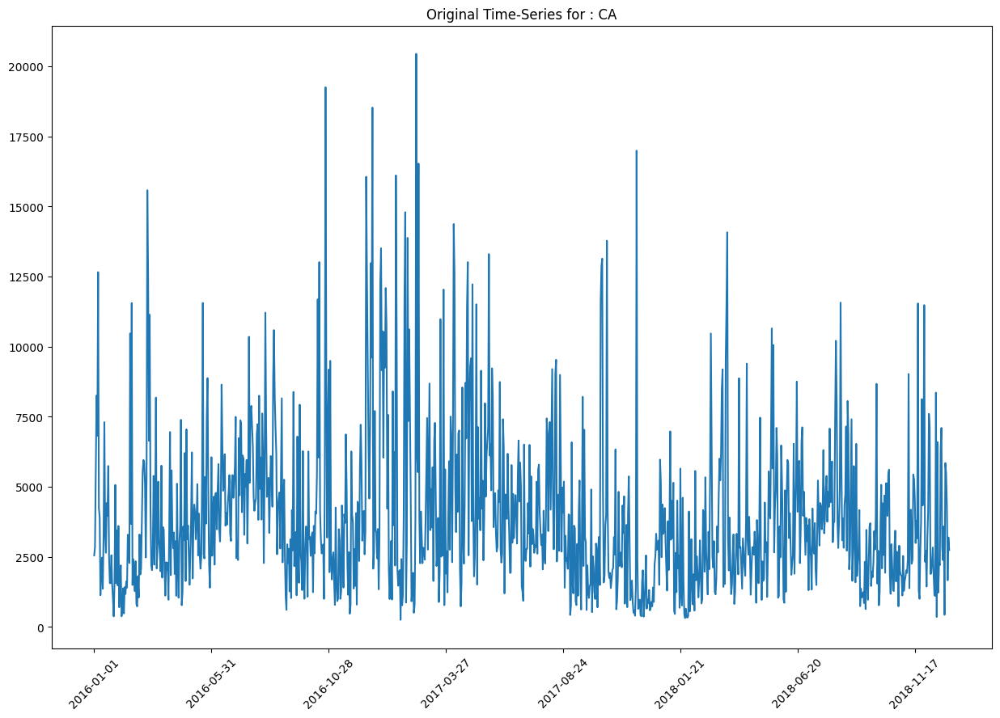

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
recons: [553.7884337926243, 91.1449869957263, 49.33010924230416, 8.768000024118038e-13]


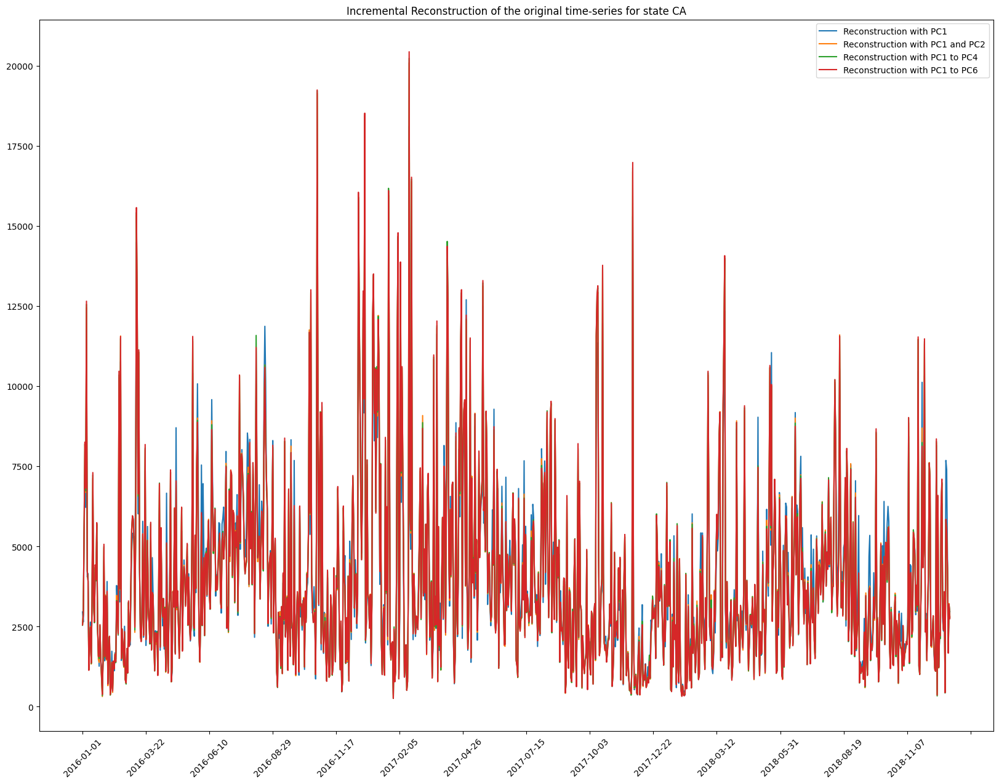

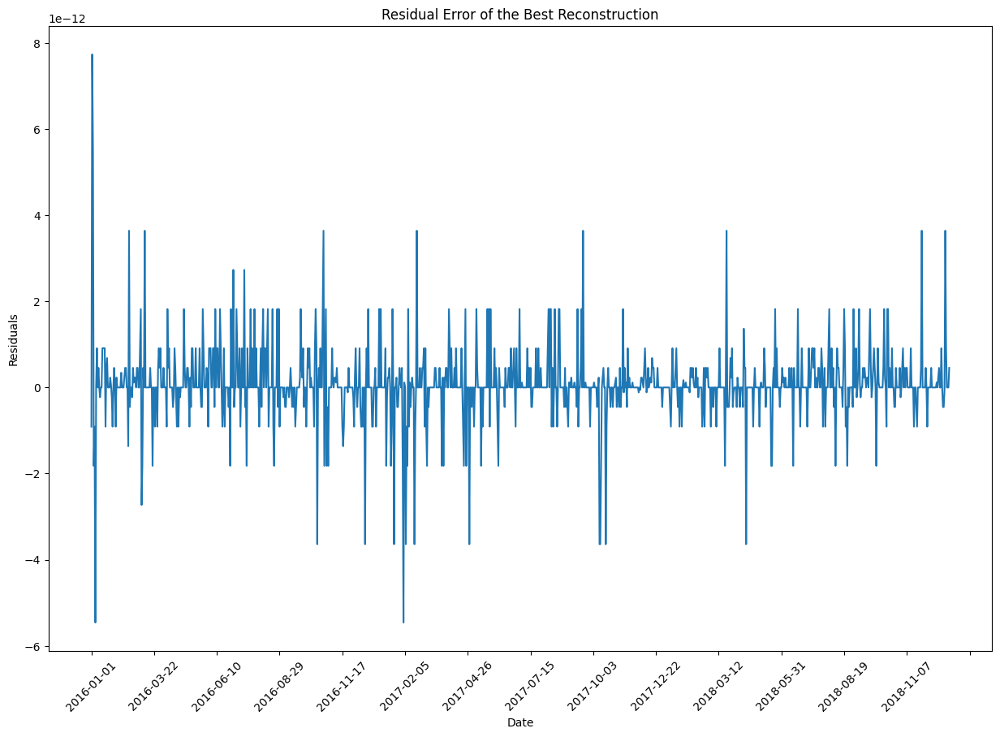

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 3)
proj X shaep: (1, 3)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 5)
proj X shaep: (1, 5)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
w shape: (1095, 7)
proj X shaep: (1, 7)
Recon X shaep: (1, 1095)


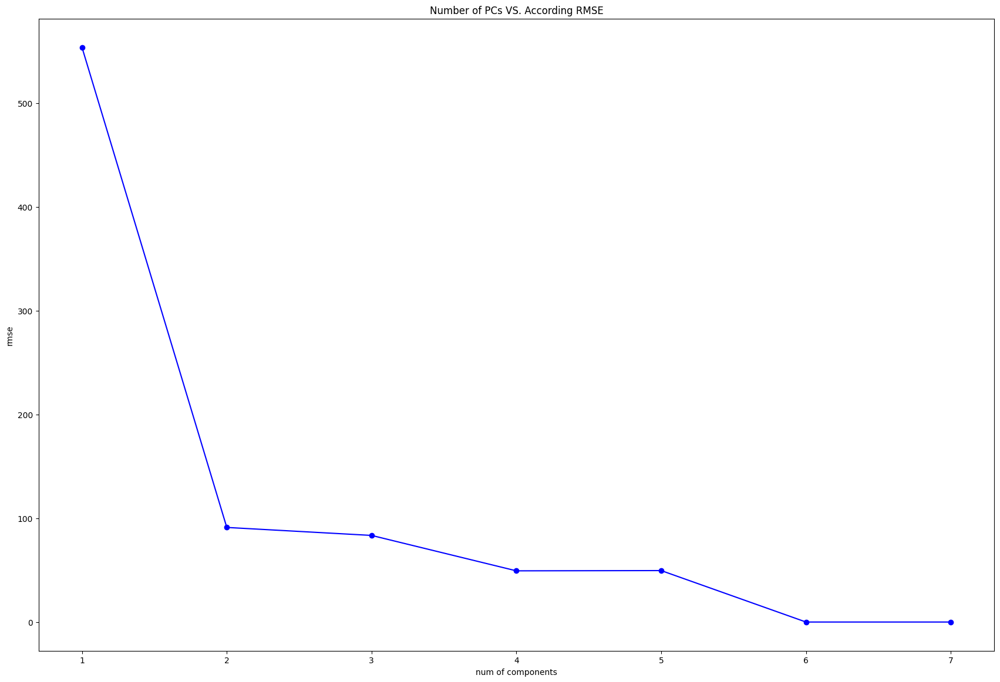

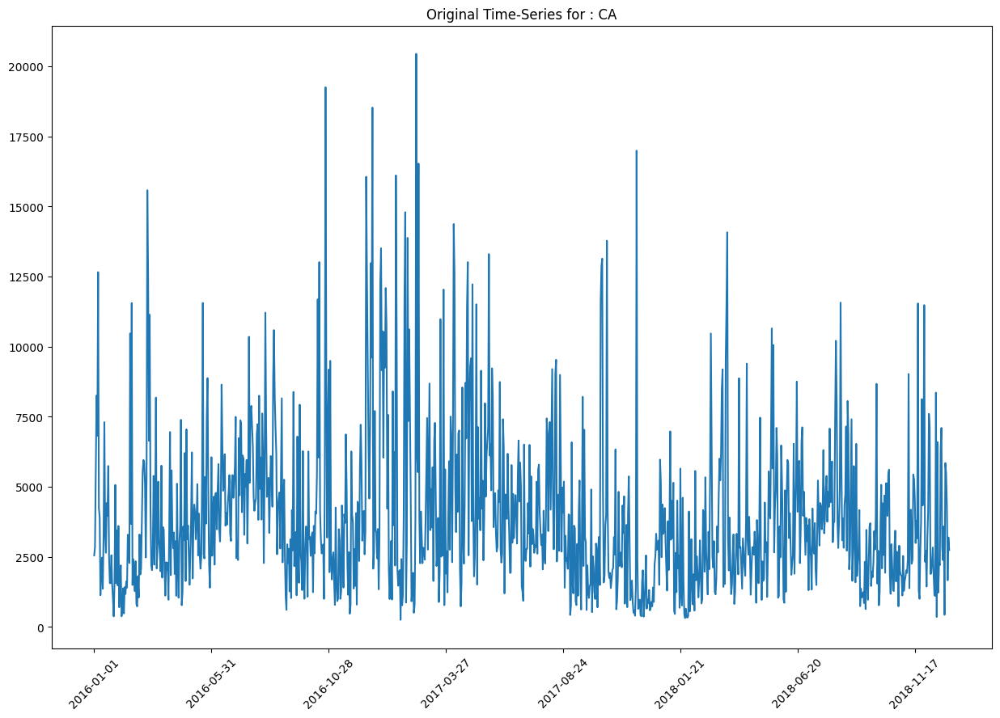

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [1132.5979628704329, 84.50054199763524, 78.31838242546445, 6.108042919387638], best: 6.108042919387638


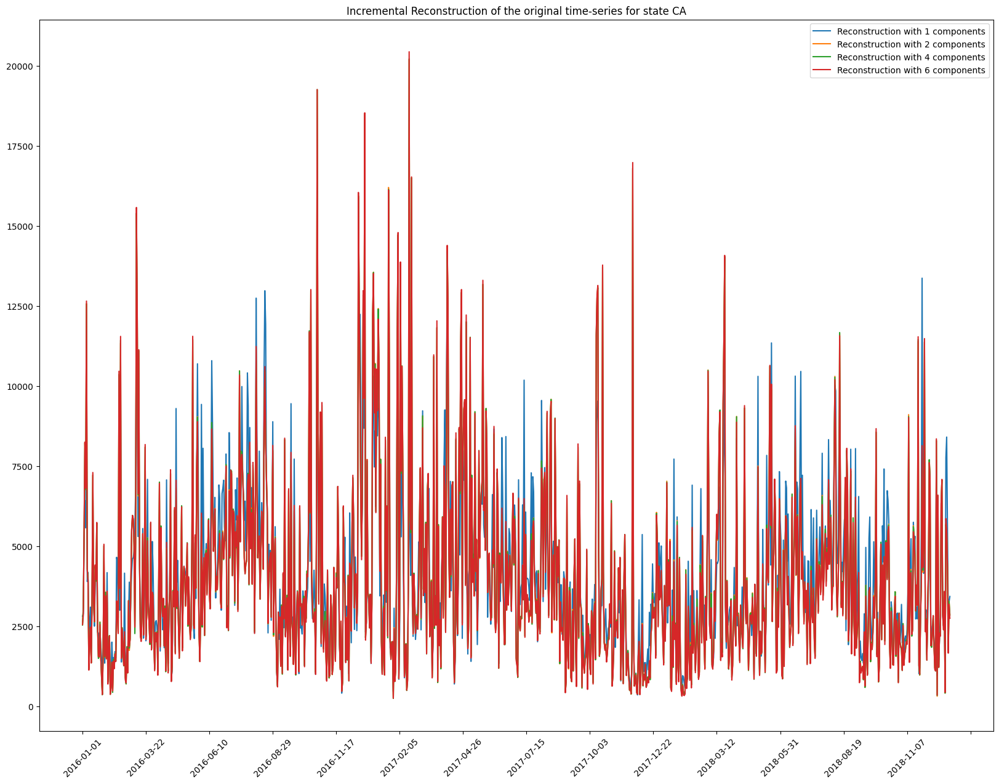

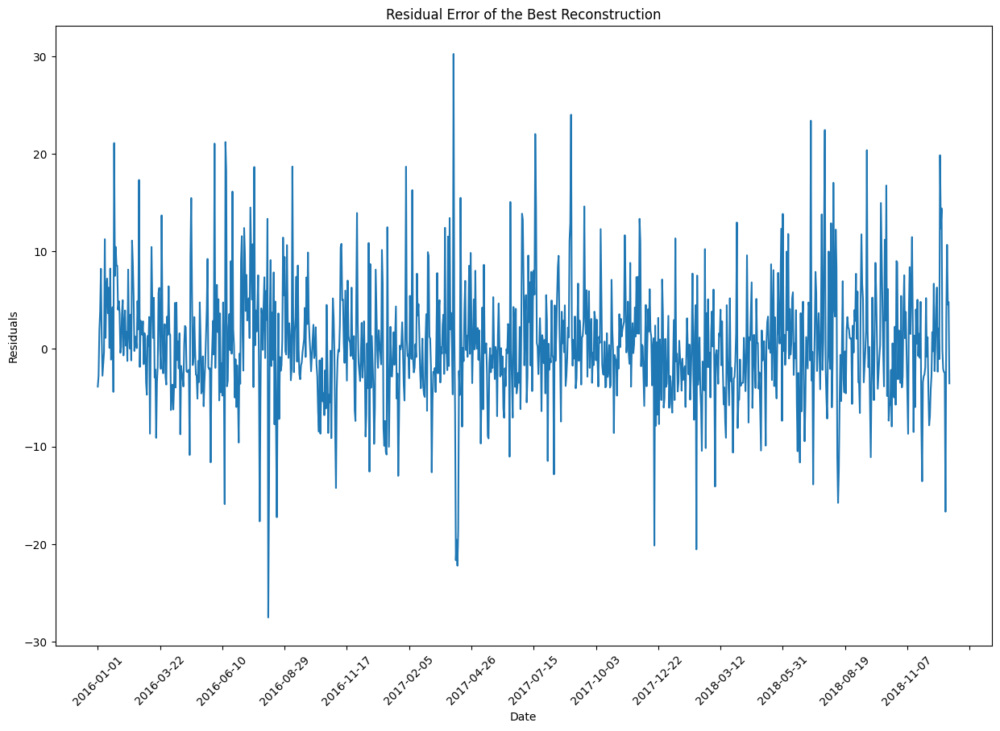

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


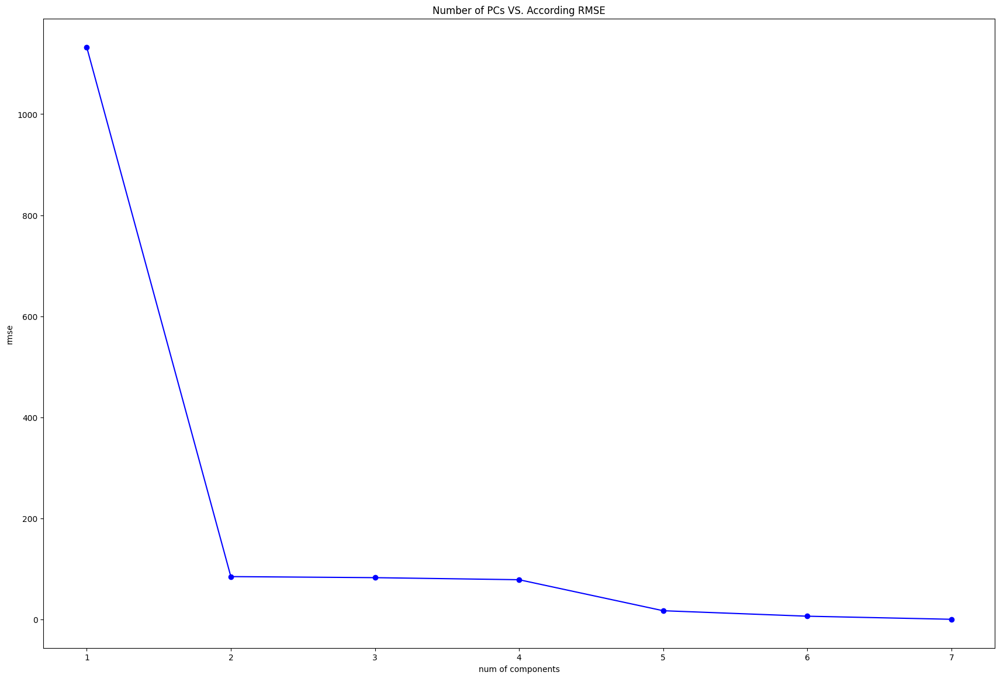

for state CA:

RMSE Comparison:
PCA RMSEs: [553.7884337926243, 91.1449869957263, 49.33010924230416, 8.768000024118038e-13]
SVD RMSEs: [1132.5979628704329, 84.50054199763524, 78.31838242546445, 6.108042919387638]

Residual Error Summary:
PCA Residuals - Mean: 7.685541700769522e-14, Std: 8.734251479697115e-13, Max: 7.73070496506989e-12, Min: -5.4569682106375694e-12
SVD Residuals - Mean: 0.47448163664121157, Std: 6.089585821841394, Max: 30.242065952767916, Min: -27.52634776422019

RMSE for Best Reconstruction:
PCA Best Reconstruction RMSE: 8.768000024118038e-13
SVD Best Reconstruction RMSE: 6.108042919387638


In [253]:
# CA
compared_vals_CA = compare_PCA_SVD(data_raw, "CA")

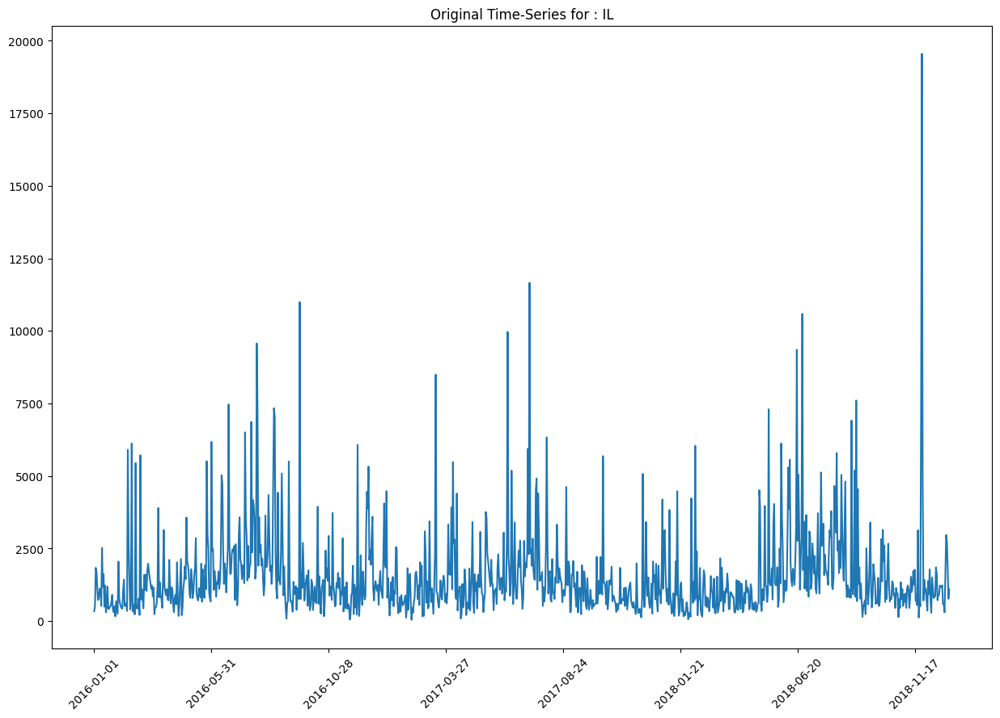

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
recons: [1020.0830187098478, 987.8167322281594, 41.45732860194495, 1.3166662507491616e-12]


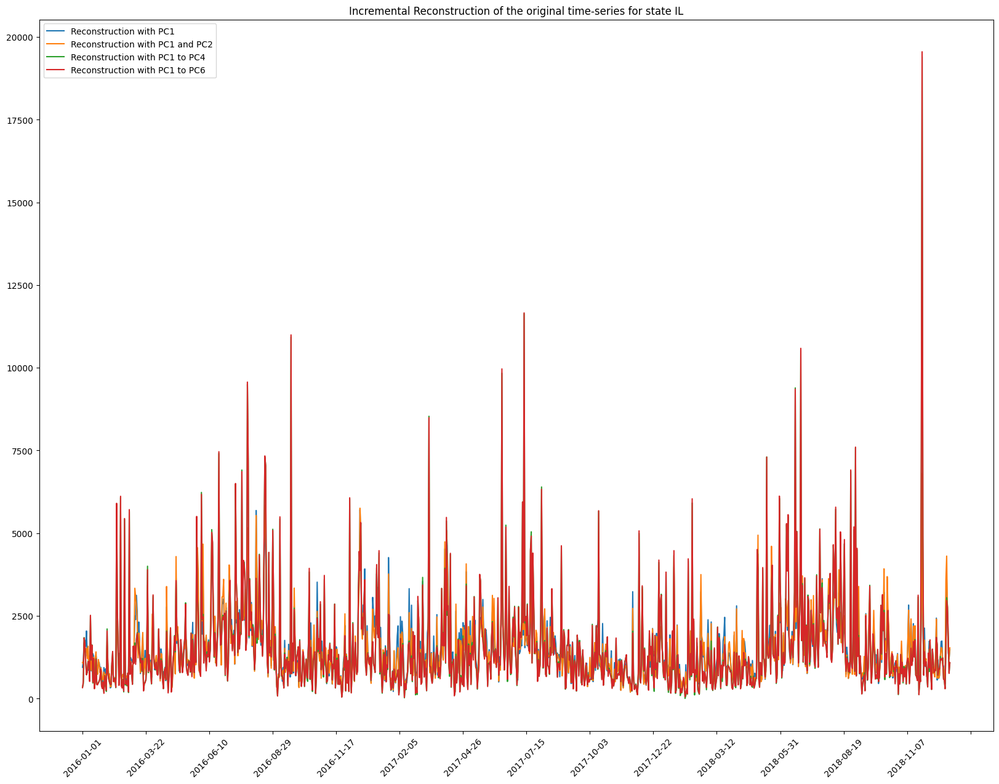

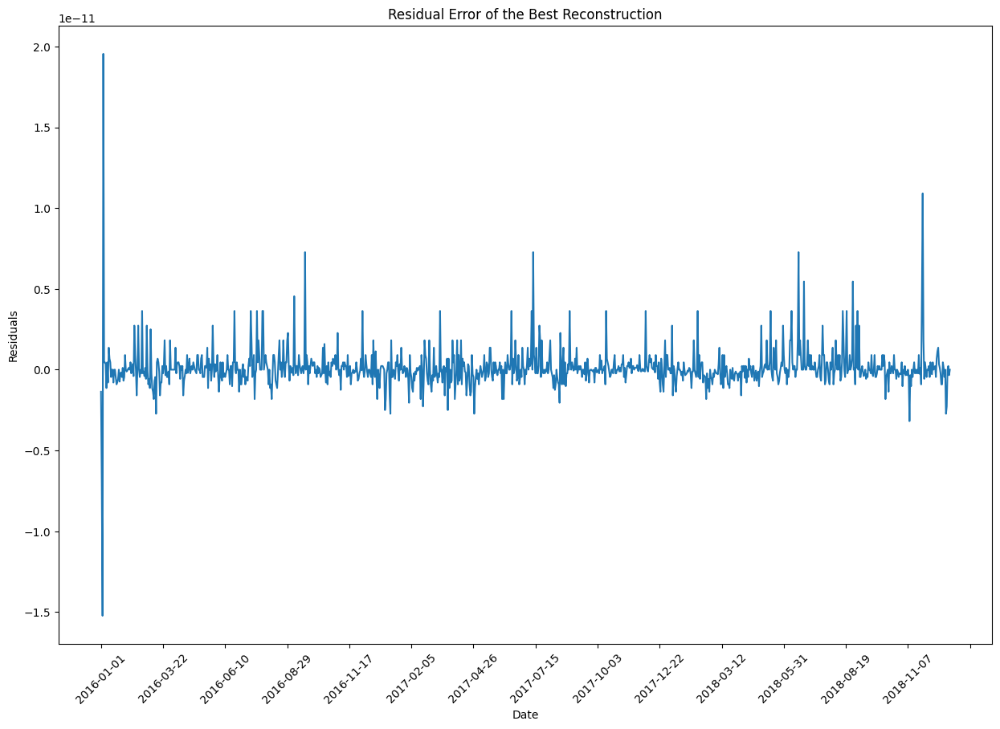

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 3)
proj X shaep: (1, 3)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 5)
proj X shaep: (1, 5)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
w shape: (1095, 7)
proj X shaep: (1, 7)
Recon X shaep: (1, 1095)


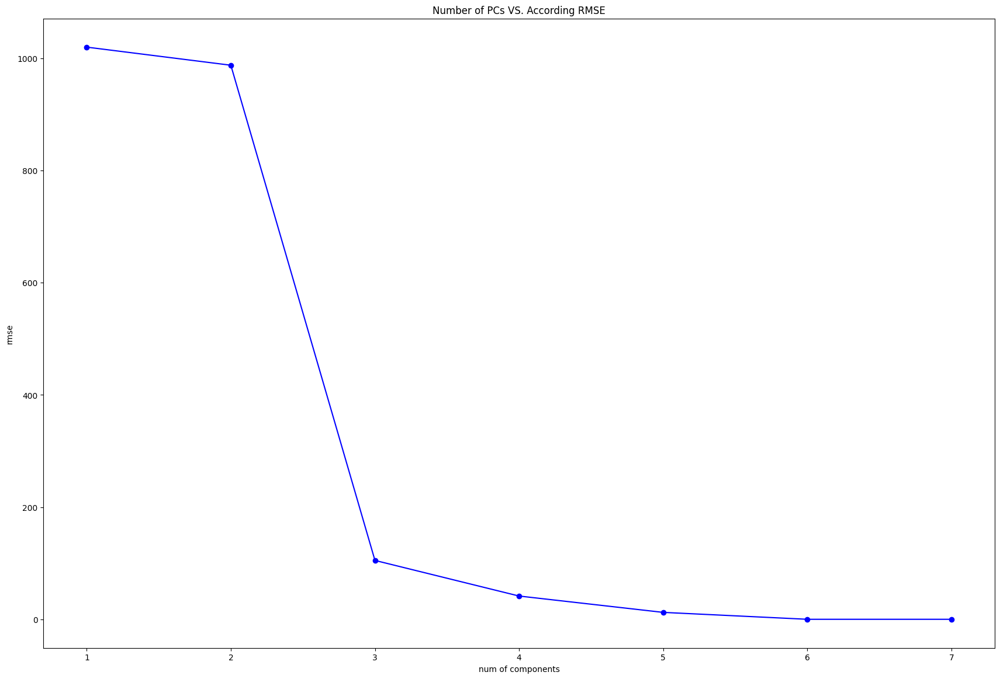

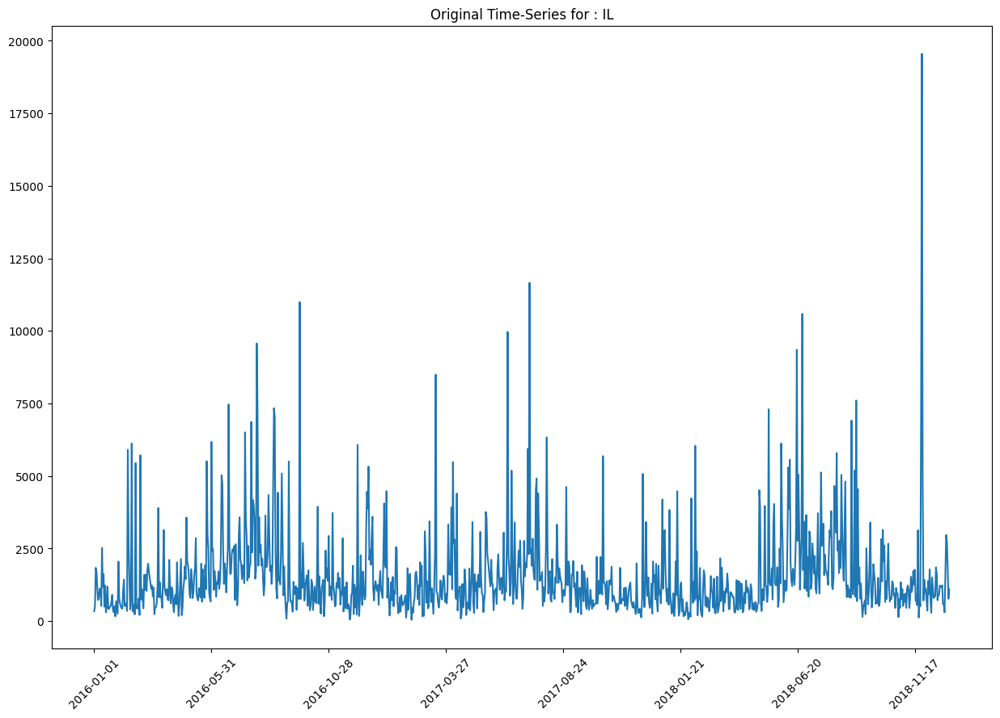

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [1221.3739788116322, 894.564095454139, 81.07078743211365, 9.189670307407297], best: 9.189670307407297


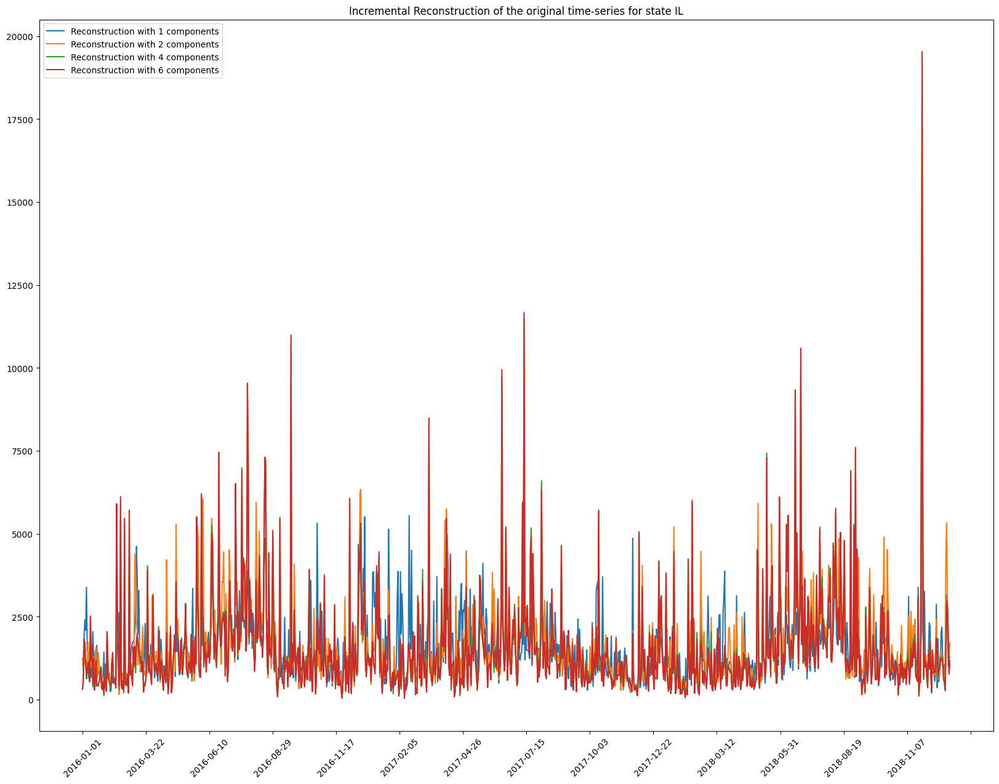

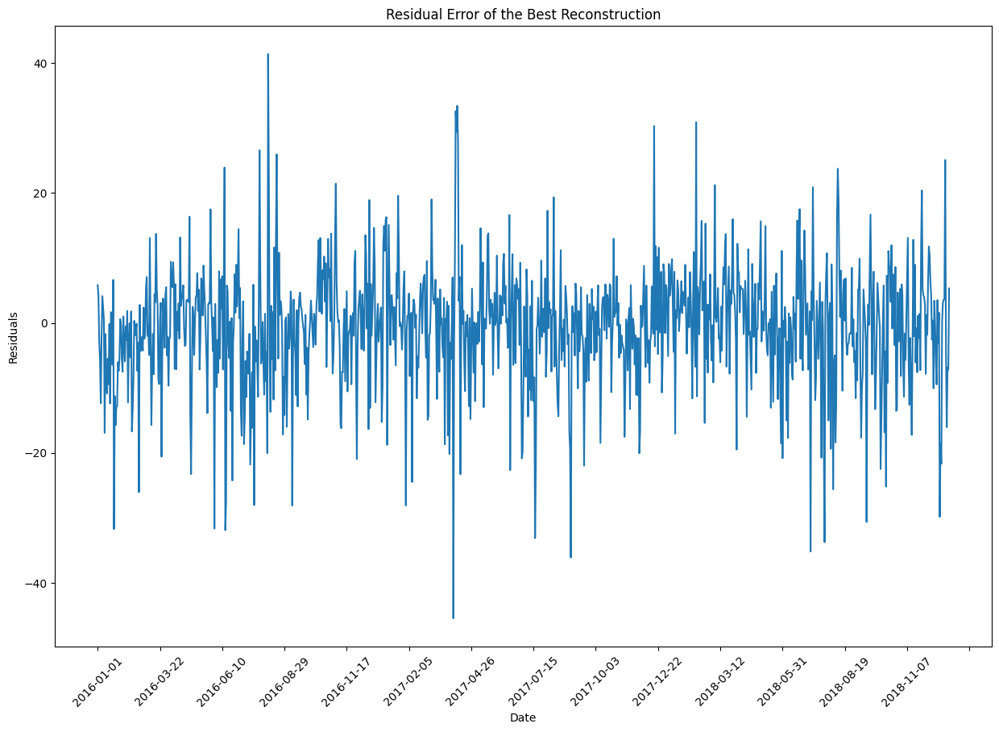

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


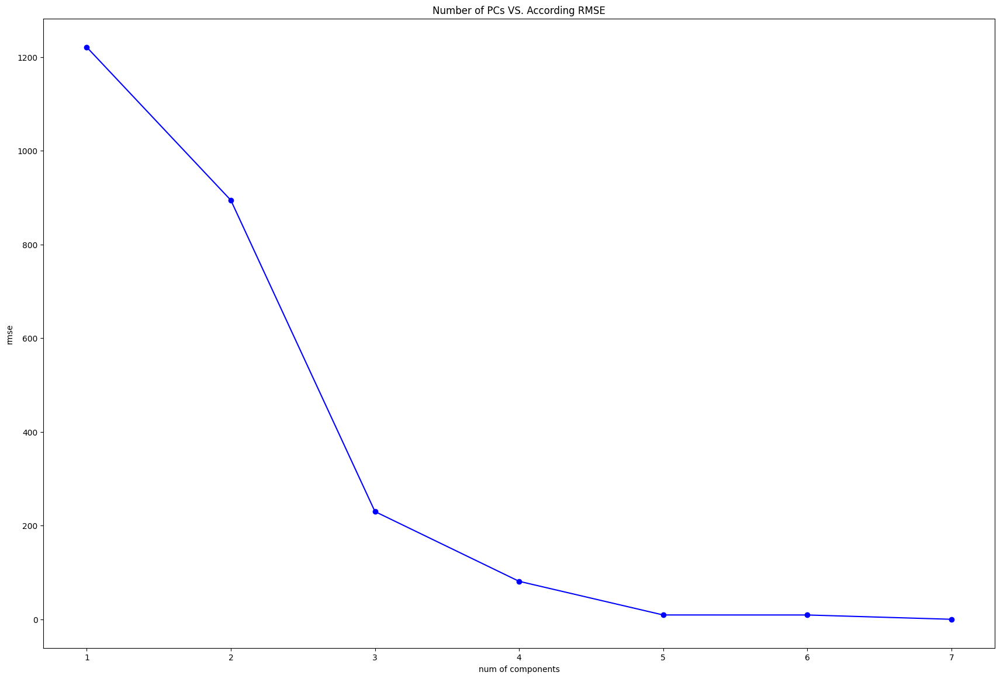

for state IL:

RMSE Comparison:
PCA RMSEs: [1020.0830187098478, 987.8167322281594, 41.45732860194495, 1.3166662507491616e-12]
SVD RMSEs: [1221.3739788116322, 894.564095454139, 81.07078743211365, 9.189670307407297]

Residual Error Summary:
PCA Residuals - Mean: 1.0261664678822123e-13, Std: 1.3126613575723922e-12, Max: 1.9554136088117957e-11, Min: -1.5234036254696548e-11
SVD Residuals - Mean: -0.7138669235345164, Std: 9.161901242336478, Max: 41.41392980675528, Min: -45.499781057319524

RMSE for Best Reconstruction:
PCA Best Reconstruction RMSE: 1.3166662507491616e-12
SVD Best Reconstruction RMSE: 9.189670307407297


In [254]:
# IL
compared_vals_IL = compare_PCA_SVD(data_raw, "IL")

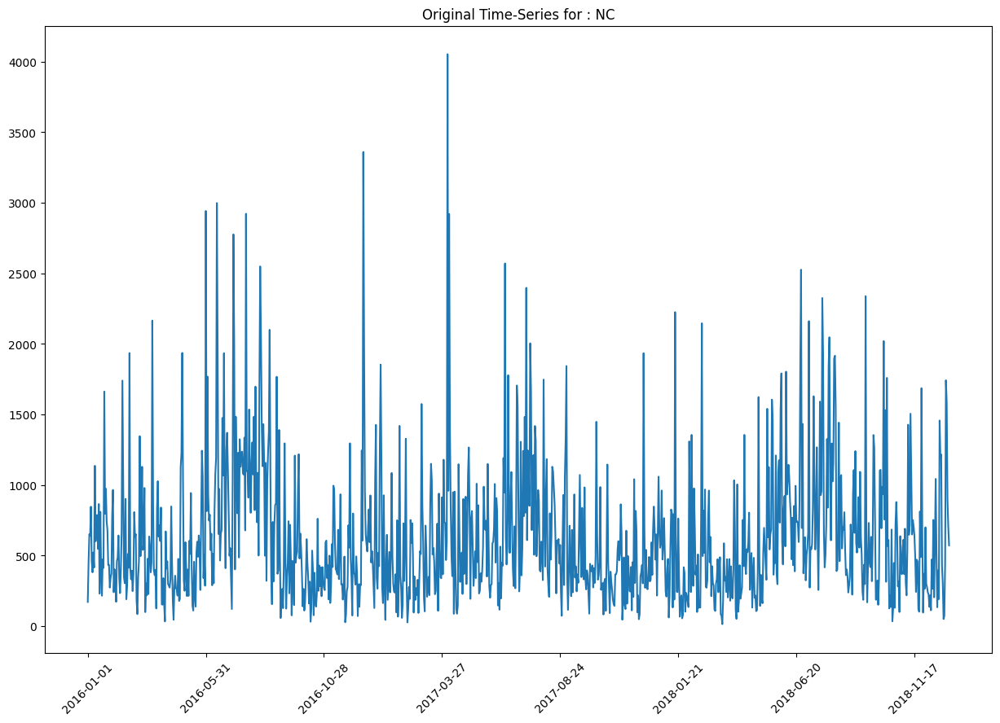

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
recons: [511.48724297222833, 377.78480160630147, 342.2656590536377, 9.999376271636067e-13]


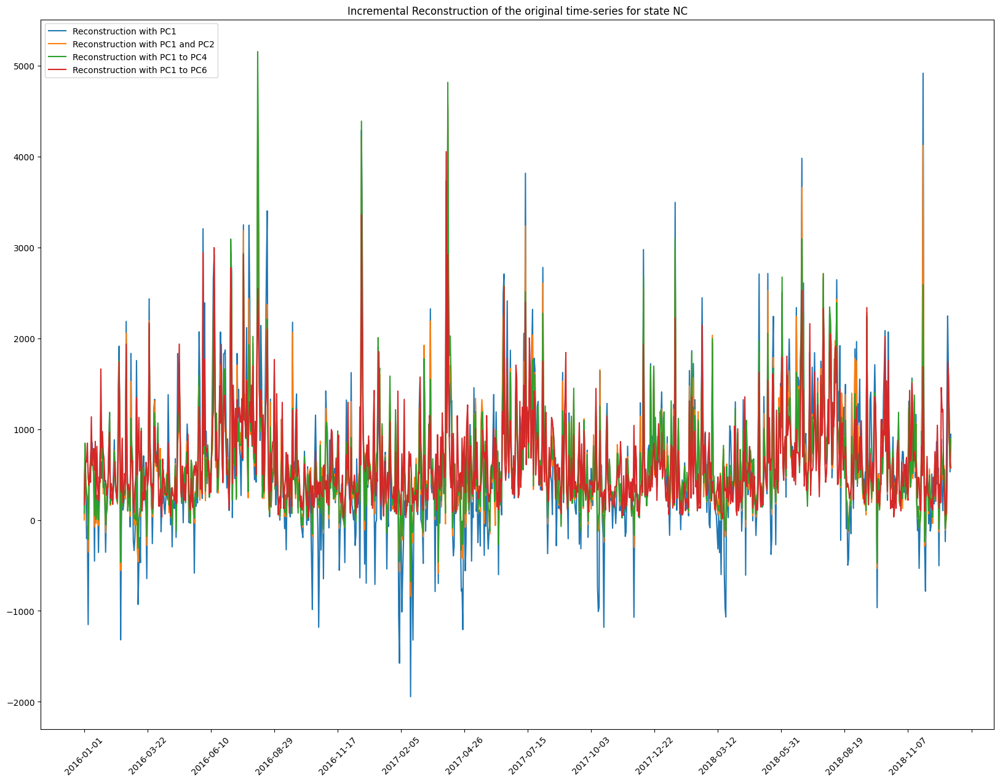

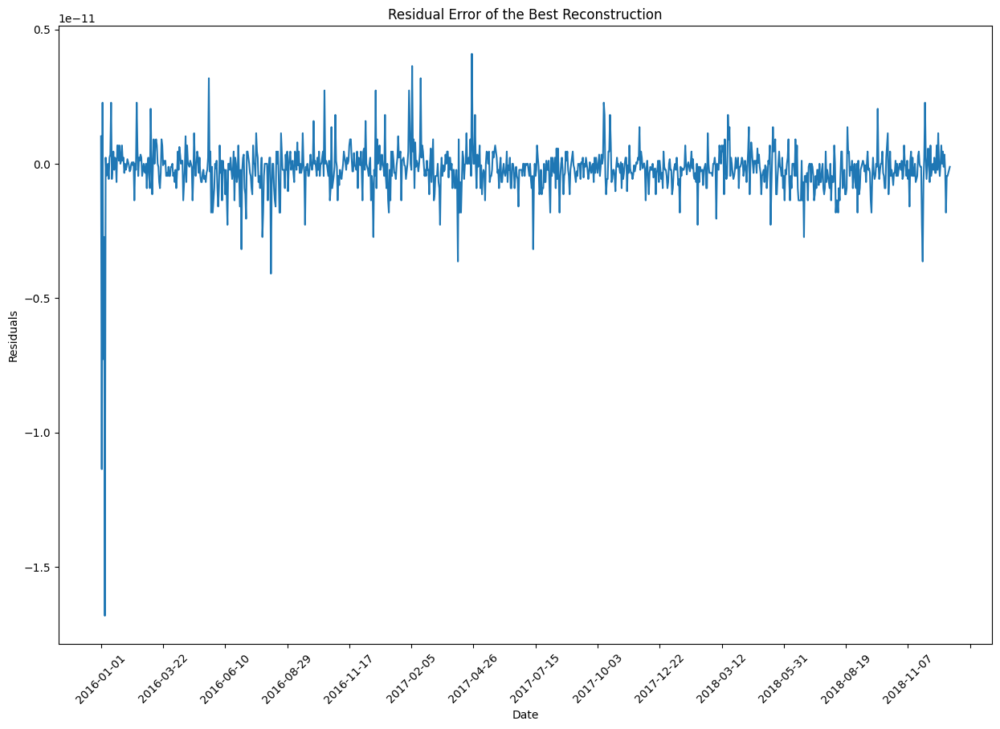

w shape: (1095, 1)
proj X shaep: (1, 1)
Recon X shaep: (1, 1095)
w shape: (1095, 2)
proj X shaep: (1, 2)
Recon X shaep: (1, 1095)
w shape: (1095, 3)
proj X shaep: (1, 3)
Recon X shaep: (1, 1095)
w shape: (1095, 4)
proj X shaep: (1, 4)
Recon X shaep: (1, 1095)
w shape: (1095, 5)
proj X shaep: (1, 5)
Recon X shaep: (1, 1095)
w shape: (1095, 6)
proj X shaep: (1, 6)
Recon X shaep: (1, 1095)
w shape: (1095, 7)
proj X shaep: (1, 7)
Recon X shaep: (1, 1095)


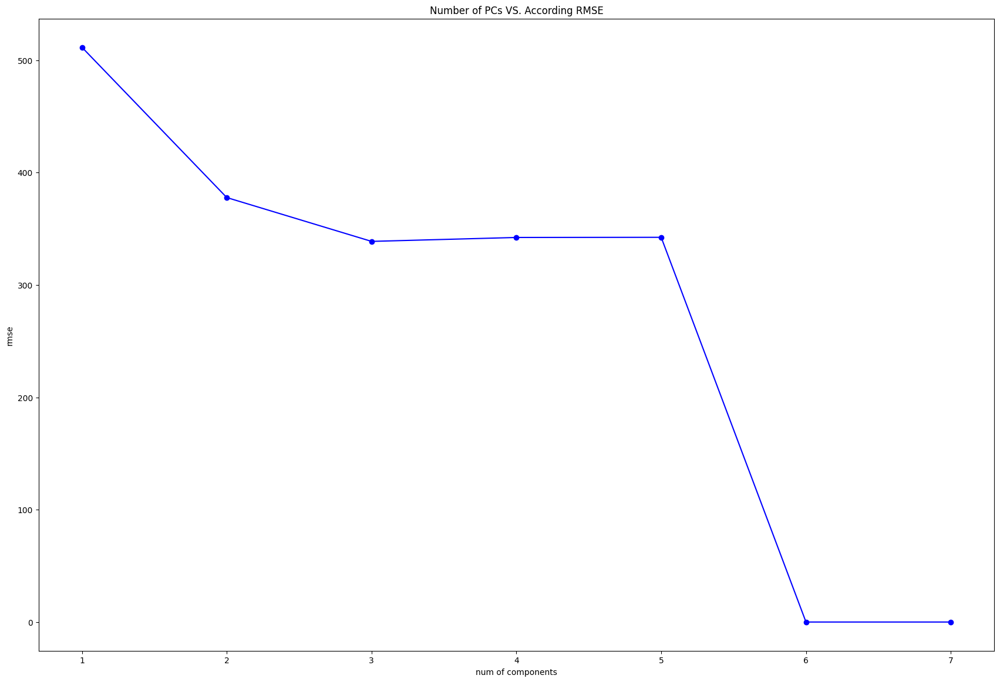

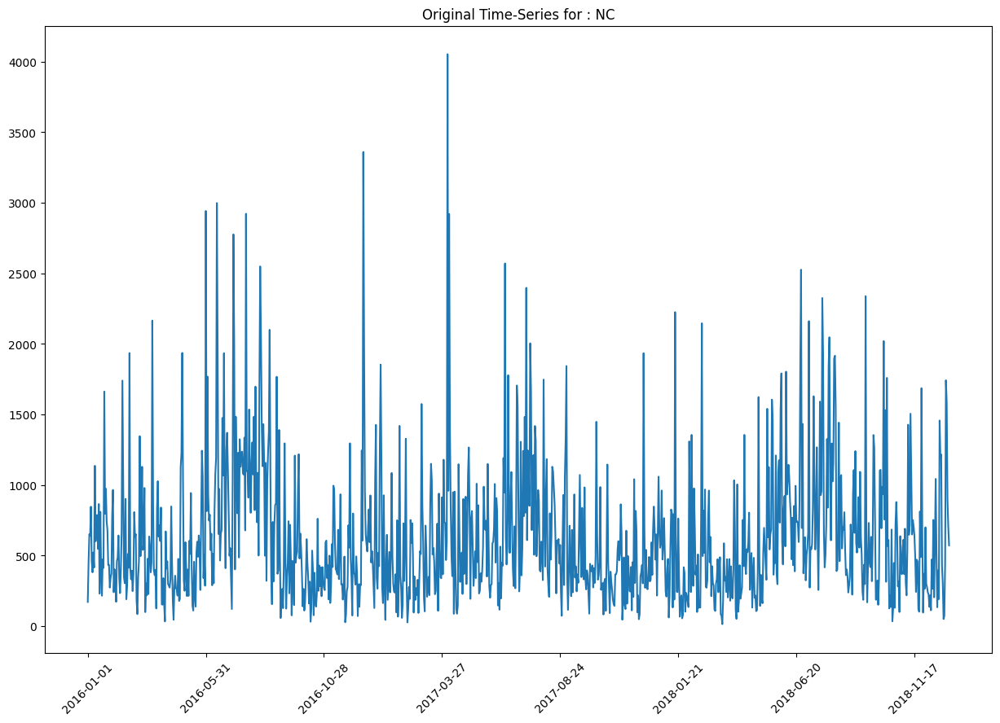

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
recons: [425.07187066483357, 330.6182481493101, 293.68882649934926, 286.86810957290874], best: 286.86810957290874


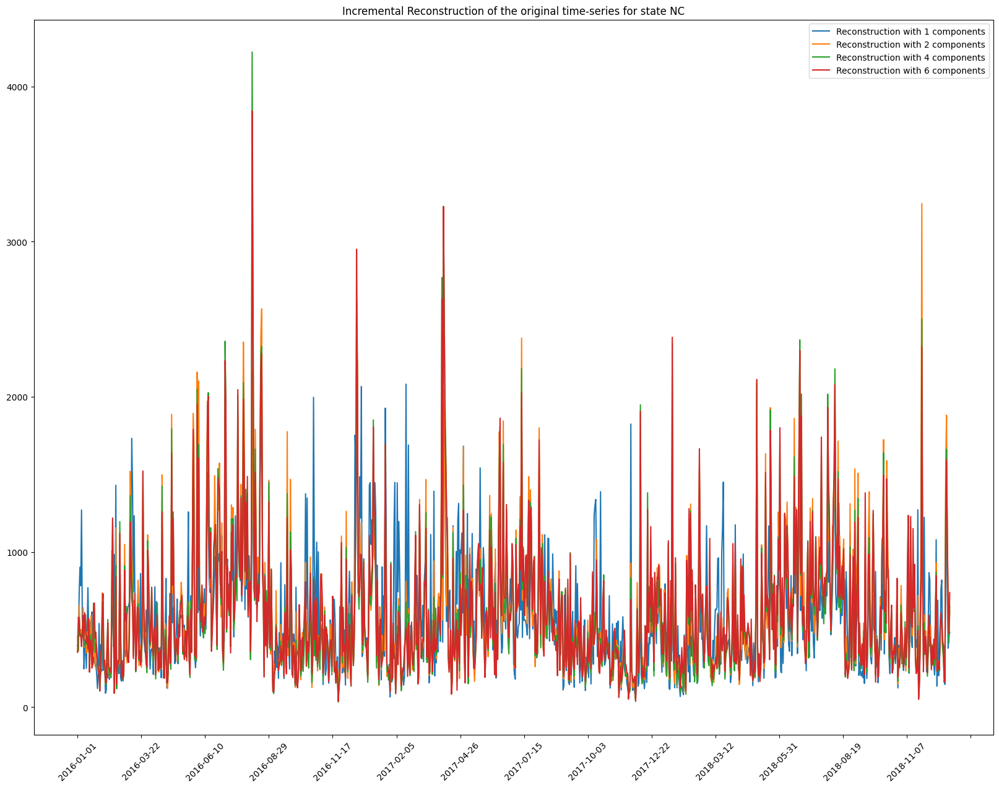

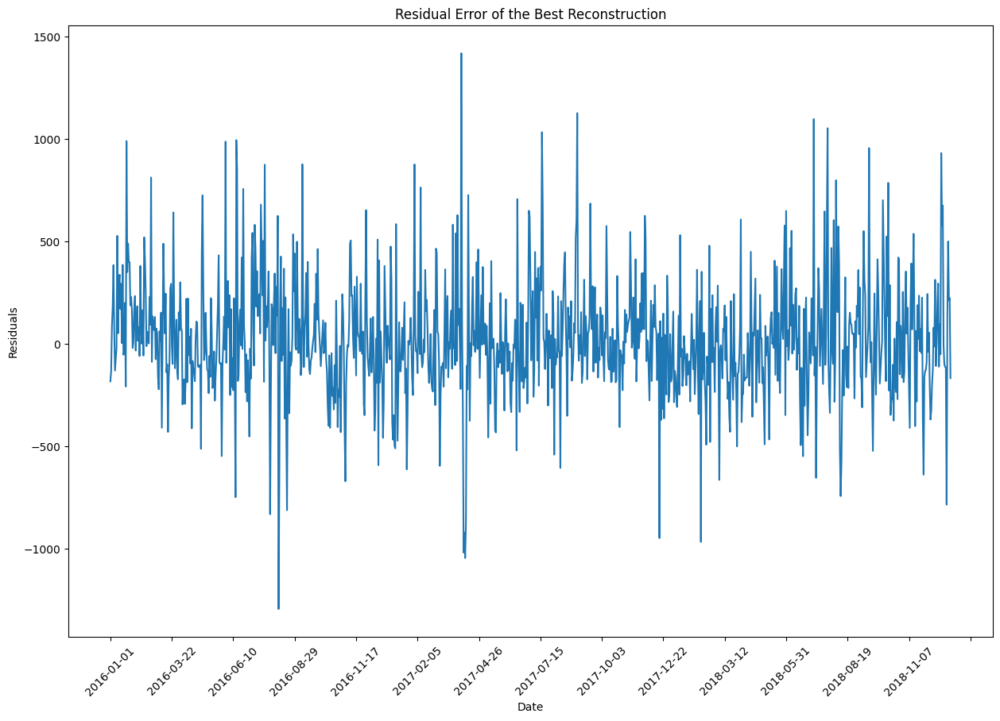

shape: Uk: (7, 1), sigmak: (1, 1), Vhk: (1, 1095)
shape: Uk: (7, 2), sigmak: (2, 2), Vhk: (2, 1095)
shape: Uk: (7, 3), sigmak: (3, 3), Vhk: (3, 1095)
shape: Uk: (7, 4), sigmak: (4, 4), Vhk: (4, 1095)
shape: Uk: (7, 5), sigmak: (5, 5), Vhk: (5, 1095)
shape: Uk: (7, 6), sigmak: (6, 6), Vhk: (6, 1095)
shape: Uk: (7, 7), sigmak: (7, 7), Vhk: (7, 1095)


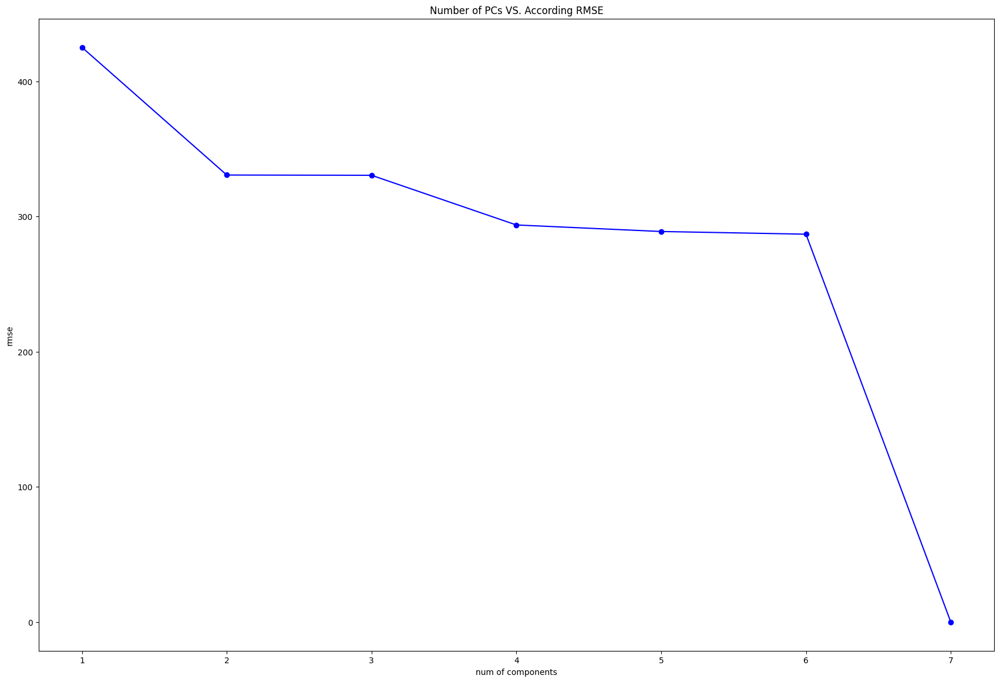

for state NC:

RMSE Comparison:
PCA RMSEs: [511.48724297222833, 377.78480160630147, 342.2656590536377, 9.999376271636067e-13]
SVD RMSEs: [425.07187066483357, 330.6182481493101, 293.68882649934926, 286.86810957290874]

Residual Error Summary:
PCA Residuals - Mean: -2.2126106122326845e-13, Std: 9.751506555419719e-13, Max: 4.092726157978177e-12, Min: -1.6825651982799172e-11
SVD Residuals - Mean: 22.28433099235408, Std: 286.0012602807155, Max: 1420.3378076984427, Min: -1292.7923806007875

RMSE for Best Reconstruction:
PCA Best Reconstruction RMSE: 9.999376271636067e-13
SVD Best Reconstruction RMSE: 286.86810957290874


In [255]:
# NC
compared_vals_NC = compare_PCA_SVD(data_raw, "NC")

Comment on the results:

- according to the comparison is RMSE, and especially in resiual, we can see that PCA outperforms SVD since SVD did not get centered. The SVD fails to reconstructed the data as accurate as PCA, reflecting by the high RMSE value even when we used 6 componenets. This is also reflected by higher residual error values compare to PCA. This suggest if SVD did not get centered, it does not capture the variance of data as effective, tend to focus more of the mean. 
- if we centered svd, we will probablity get almost same values as what we'll seen in PCA.

# Part 5: Let's explore the flip side of PCA using another dataset! [42 Marks in Total]


In the previous parts, we explored PCA for data reconstruction, where we aimed to approximate the original dataset using a reduced number of principal components.

Now, we will pivot to *the other side of the coin*, we will be **using PCA for feature analysis** with the [wine quality](https://www.kaggle.com/datasets/yasserh/wine-quality-dataset) dataset.

Instead of reconstructing the data, our goal will be to identify and analyze which factors contribute the most to wine quality, as indicated by the principal components.

<font color= #F26522>
This analysis will provide insights into the most critical features affecting wine quality, allowing us to better understand the underlying relationships in the dataset.
<font>


## Part 5.1 Load the Wine Quality Data [2 Marks]

First load the data, then drop the `Id` column in place


`df.drop(["Id"], axis=?, inplace=?)`

Determine what axis and inplace to be used by carefully reading [this](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.drop.html)





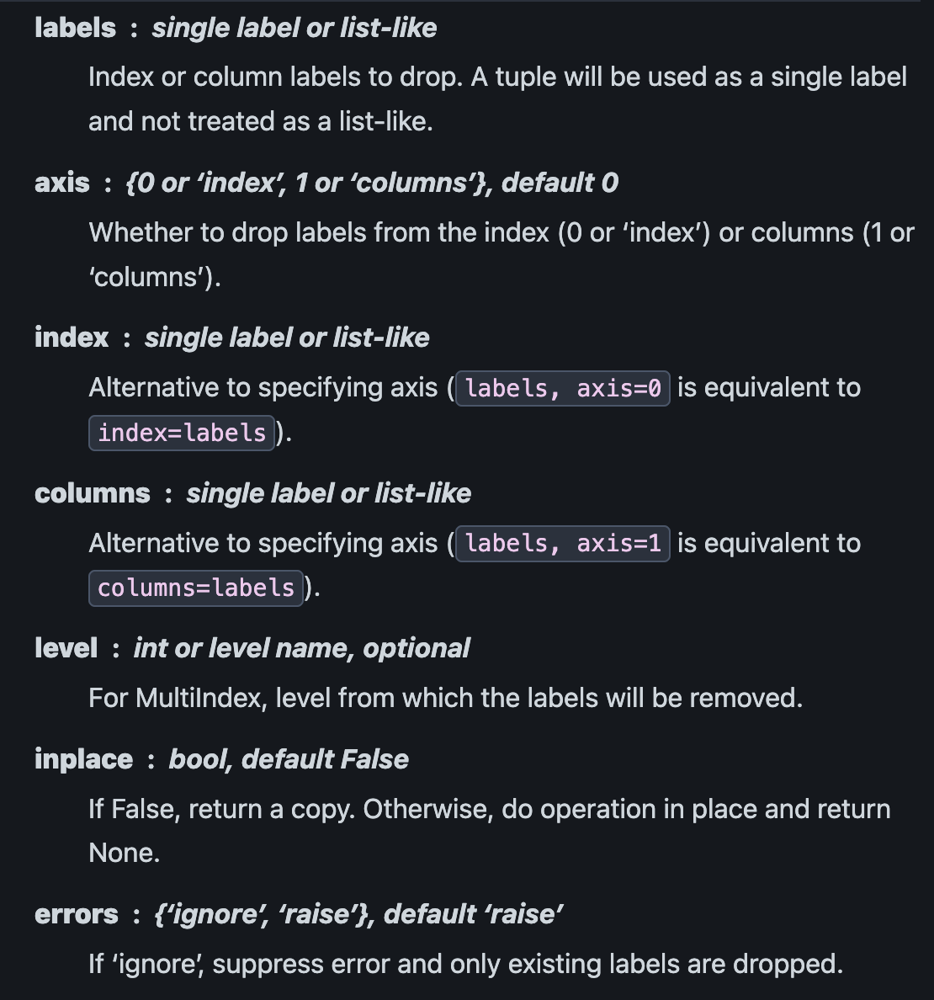

In [ ]:
pip install wget

In [113]:
import wget
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

myfile = wget.download('https://raw.githubusercontent.com/chf-NewStart/MIE370-TA-Material/main/WineQT.csv')
df = pd.read_csv(myfile, delimiter=',')
df.drop(["Id"], axis=1, inplace=True)



In [114]:
### YOUR CODE HERE ###
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1138,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
1139,6.8,0.620,0.08,1.9,0.068,28.0,38.0,0.99651,3.42,0.82,9.5,6
1140,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
1141,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6


## Part 5.2 Create the Principle Component (PC) DataFrame [5 Marks]

Similar to Part 1, remove the target column then standardize it.

Then get the PCs like we did before in Part 2 and Part 3, in summary:


1. Standardize the X data
2. Make the covariance matrix
3. Get the sorted eigenValues and eigenVectors
4. Get the PC  


Finally make a table containing all PCs.

In [196]:
### YOUR CODE HERE ###
# our target is wine quality
df_feature = df.drop(["quality"], axis=1)

# standardize
scaler2 = StandardScaler(copy=True, with_mean=True, with_std=True)
df_feature_std = scaler2.fit_transform(df_feature)
df_feature_std = pd.DataFrame(df_feature_std, index=df.index, columns=df_feature.columns)
df_feature_std

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,-0.521580,0.939332,-1.365027,-0.466421,-0.231395,-0.450467,-0.363610,0.555854,1.270695,-0.573658,-0.963382
1,-0.292593,1.941813,-1.365027,0.050060,0.234247,0.915920,0.643477,0.036165,-0.708928,0.130881,-0.593601
2,-0.292593,1.273492,-1.161568,-0.171289,0.107253,-0.060071,0.246745,0.140103,-0.325775,-0.045254,-0.593601
3,1.653789,-1.399789,1.483400,-0.466421,-0.252560,0.135127,0.429852,0.659792,-0.964363,-0.456235,-0.593601
4,-0.521580,0.939332,-1.365027,-0.466421,-0.231395,-0.450467,-0.363610,0.555854,1.270695,-0.573658,-0.963382
...,...,...,...,...,...,...,...,...,...,...,...
1138,-1.151292,-0.118842,-0.703785,-0.171289,-0.231395,1.306316,-0.180503,-0.514707,0.695966,0.541862,0.515741
1139,-0.865059,0.493785,-0.958109,-0.466421,-0.400719,1.208717,-0.241539,-0.114545,0.695966,0.952843,-0.870937
1140,-1.208538,0.382399,-0.958109,-0.392638,0.064922,1.599113,-0.058432,-0.951246,0.887542,-0.456235,0.053515
1141,-1.380278,0.103932,-0.856379,-0.245072,-0.527712,2.282306,0.155192,-0.836914,1.334554,0.600574,0.700632


In [197]:
# covariance
# use the equation we used in tut 7 instead of just .cov
# since we standardized data and the mean is 0
df_feature_std_cov = np.dot(df_feature_std.T, df_feature_std) / (df_feature_std.shape[0]-1)
df_feature_std_cov

array([[ 1.00087566, -0.25094787,  0.67374671,  0.171981  ,  0.10798304,
        -0.16497513, -0.11072524,  0.68209764, -0.68576257,  0.17474471,
        -0.07512058],
       [-0.25094787,  1.00087566, -0.54466346, -0.00575613,  0.05638559,
        -0.0019642 ,  0.0778158 ,  0.01652598,  0.22168547, -0.27632035,
        -0.20408783],
       [ 0.67374671, -0.54466346,  1.00087566,  0.17596881,  0.2455273 ,
        -0.05763953,  0.0369034 ,  0.37557184, -0.54681754,  0.3315218 ,
         0.10634338],
       [ 0.171981  , -0.00575613,  0.17596881,  1.00087566,  0.07092516,
         0.16548358,  0.1909571 ,  0.38047983, -0.11706135,  0.01748981,
         0.05847176],
       [ 0.10798304,  0.05638559,  0.2455273 ,  0.07092516,  1.00087566,
         0.01529384,  0.04820534,  0.20908364, -0.27800229,  0.37511208,
        -0.23011842],
       [-0.16497513, -0.0019642 , -0.05763953,  0.16548358,  0.01529384,
         1.00087566,  0.66167176, -0.05419774,  0.07286746,  0.03447528,
        -0.047

In [198]:
# get sorted eigen val, vec
eigen_val2, eigen_vec2 = get_sorted_eigen(df_feature_std_cov)
print(f"eigen val: {eigen_val2}, \n\neigen vec: {eigen_vec2}")

eigen val: [3.15892164 1.87990611 1.57503007 1.21256564 0.95905262 0.66595181
 0.55808566 0.41942574 0.34479563 0.17738664 0.05851067], 

eigen vec: [[-0.48533856 -0.10232799  0.12237612 -0.23604559 -0.09737837  0.10336891
  -0.34584711  0.18814791  0.17348058 -0.28699903 -0.62899964]
 [ 0.22714317  0.28878641  0.44371805  0.07728789  0.25755756  0.41609139
  -0.5287217   0.08362815 -0.10290939  0.35417056 -0.01067237]
 [-0.46007532 -0.14650773 -0.24684311 -0.06381775 -0.07767357  0.08936147
   0.09485329  0.37817865 -0.34696005  0.64231279  0.05366627]
 [-0.17450629  0.2522617  -0.09135939 -0.40726337  0.70114127  0.02481684
   0.30669585 -0.31878359  0.0083917   0.10055884 -0.18335435]
 [-0.22487011  0.15313338  0.05256247  0.65266911  0.27064882  0.31893577
   0.37697348  0.32771496  0.08411508 -0.25202339 -0.04664514]
 [ 0.04785179  0.51702178 -0.42828836 -0.05080877 -0.14928186 -0.00952849
  -0.09981691  0.20648347  0.65173736  0.20789847  0.03779114]
 [-0.01506861  0.57739283 -0.

In [340]:
# Get the PC and form a table of it
W2 = eigen_vec2[: , :12]
df_pc = np.dot(df_feature_std, W2)
df_pc = pd.DataFrame(df_pc, columns=[f"PC{i+1}" for i in range(df_pc.shape[1])])

df_pc

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11
0,1.561545,0.444892,1.767209,0.132635,0.130138,-0.906815,-0.122336,0.330086,-0.011548,-0.249611,-0.046465
1,0.760892,1.915058,0.864158,0.536890,0.090935,0.860406,-0.998623,-0.746939,0.547644,0.005196,0.134810
2,0.708085,0.914423,1.142363,0.435075,0.024940,0.356702,-0.536162,-0.575652,0.084118,-0.203715,0.122553
3,-2.308166,-0.224448,-0.256895,-0.830630,-1.639209,-0.154720,0.300410,0.494589,-0.110087,-0.121798,-0.313678
4,1.561545,0.444892,1.767209,0.132635,0.130138,-0.906815,-0.122336,0.330086,-0.011548,-0.249611,-0.046465
...,...,...,...,...,...,...,...,...,...,...,...
1138,1.442233,0.332152,-1.137812,0.441063,0.232027,-0.499123,-0.185077,-0.061655,0.867211,0.217315,0.381995
1139,1.222998,0.921618,-0.027234,0.855285,-0.155510,-1.130942,-0.605893,-0.364230,0.868018,0.581082,-0.007893
1140,2.124635,0.873804,-0.626573,0.399466,-0.177268,0.063081,0.221032,0.357601,1.008091,0.296691,0.033930
1141,2.208536,0.928343,-1.815403,0.339723,0.189002,-0.665644,-0.539637,0.269461,1.150577,0.436506,0.215402


## Part 5.3 Scree Plot [4 Marks]


Again, we want to know how much of the total variance in the data is captured by each PC, so let us plot the scree plot. **[3]**

What is the percentage of variance that the first two PC captured? **[1]**

In [341]:
### YOUR CODE HERE ###
# 1st calculate the explained var
eigen_val2_sum = sum(eigen_val2)  # total var explained by all PCs
exp_var2 = [(e_val2 / eigen_val2_sum) * 100 for e_val2 in eigen_val2]  # % of var explain by this PC - PCi

cum_exp_var2 = np.cumsum(exp_var2)  # get the cummulative sum
cum_exp_var2

array([ 28.69234485,  45.76744847,  60.07337656,  71.08705633,
        79.79808861,  85.84689933,  90.91596654,  94.72559187,
        97.85735521,  99.46855016, 100.        ])

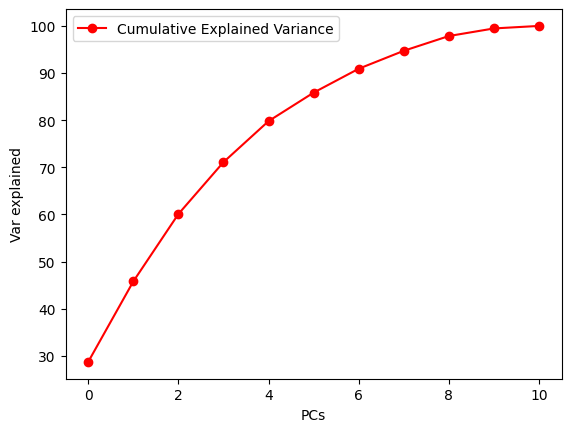

In [306]:
# plot cum to check of PCs
plt.plot(cum_exp_var2, 'r-o', label="Cumulative Explained Variance")
plt.xlabel("PCs")
plt.ylabel("Var explained")
plt.legend()
plt.show()


scree plot

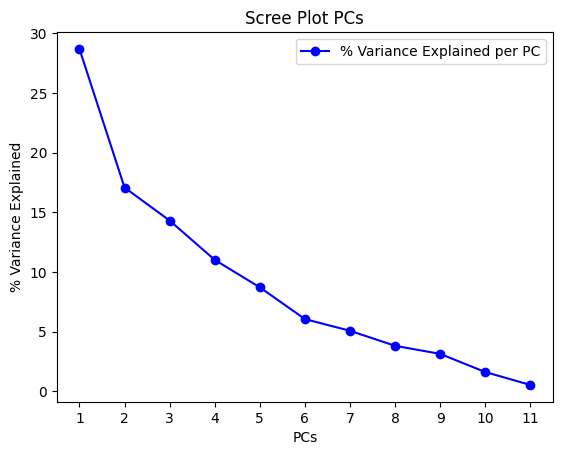

In [316]:
# scree plot
# first 10
exp_var2 = [cum_exp_var2[0]] + [cum_exp_var2[i] - cum_exp_var2[i-1] for i in range(1, len(cum_exp_var2))]

# Plot the scree plot for the first 10 PCs (individual explained variance)
plt.plot(range(1, 12), exp_var2, 'b-o', label="% Variance Explained per PC")
plt.xlabel("PCs")
plt.xticks(range(1, 12))
plt.ylabel("% Variance Explained")
plt.title("Scree Plot PCs")
plt.legend()
plt.show()


In [264]:
# % explain by 1st 2
print(f"% of variance captured by 1st 2PC: {cum_exp_var2[:2].sum()}%")

% of variance captured by 1st 2PC: 74.45979332186627%


## Part 5.4: 2D Scatter Plots with the First 2 PCs [7 Marks]

As an attempt to describe the dataset to using only the first two PCs, we now use the first 2 PCs to plot a scatter plot with various wine qualities. Here are the steps:


1. Set 6 different colors for the 6 different wine qualities.
  - `colors = [your favourite 6 colors]`
  - we want the colors to correspond to increasing wine quality. In other words,
    - `colors[0]` --> lowest quality;
    - `colors[-1]` --> highest quality


2. Create a DataFrame that includes the first two principal components and the corresponding target variable (wine quality).
In other words, the data should have 3 columns:
  - `PC1`,
  - `PC2`,
  - `Target`


3. **(Major Step)** Use a loop to plot the data points for each wine quality class in different colors, allowing for easy visual differentiation.

4. Label the x and y axes of the plot to indicate which principal components are being displayed. Add a title to the plot that includes the percentage of the variance explained by the first two principal components. Include a legend that explains the color coding of the different wine quality classes.

 **[5]**





After plotting, what can you say about this plot? **[1]**


What quality of wine could be the easiest to predict? What quality of wine would be the hardest to predict? **[1]**

In [ ]:
### YOUR CODE HERE ###

1.

In [286]:
# 6 diff color for 6 qualities
colors = ["red", "orange", "yellow", "green", "blue", "indigo"] # just use rainbow clr im lazy
# red = lowest, indigo = best

2.

In [284]:
# get the quality
unique = df["quality"].unique()
unique

array([5, 6, 7, 4, 8, 3], dtype=int64)

In [277]:
# 2 pcs
df_2PC = df_pc[["PC1", "PC2"]]

# target
df_target = df["quality"]

df_2PC_target = pd.concat([df_2PC, df_target], axis=1)  # concat on axis 1x
df_2PC_target.columns = ["PC1", "PC2", "Target"] # rename cols

df_2PC_target

,PC1,PC2,Target
0,1.561545,0.444892,5
1,0.760892,1.915058,5
2,0.708085,0.914423,5
3,-2.308166,-0.224448,6
4,1.561545,0.444892,5
...,...,...,...
1138,1.442233,0.332152,6
1139,1.222998,0.921618,6
1140,2.124635,0.873804,5
1141,2.208536,0.928343,6


3, 4.

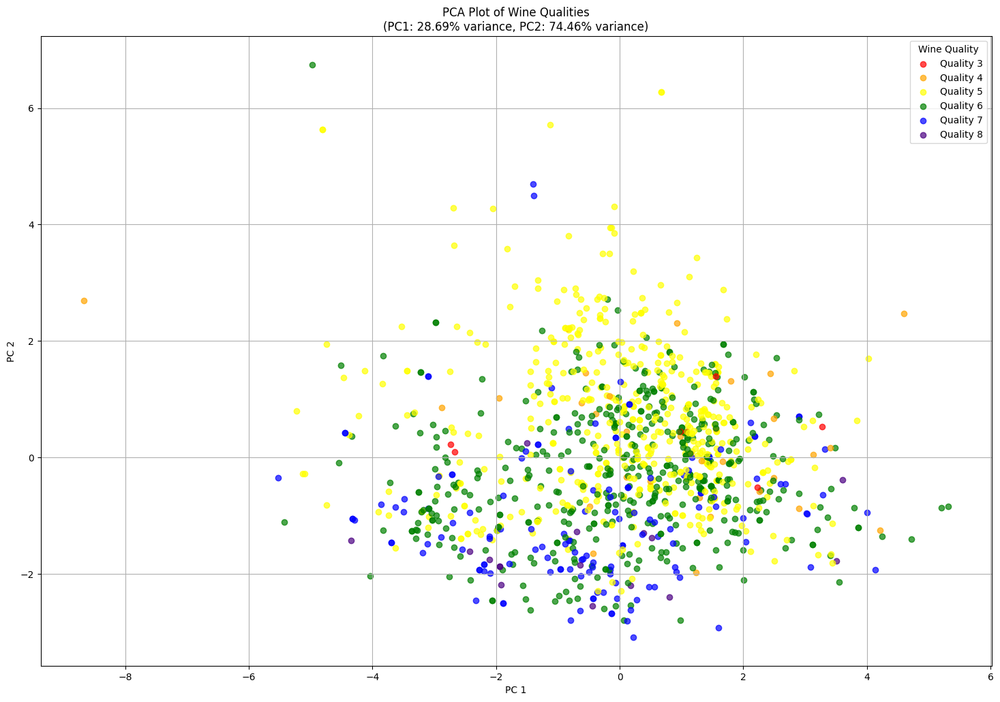

In [303]:
plt.figure(figsize=(18, 12))
# quality = [i for i in range(1, 7)]

# % explained
ex_var_pc1 = cum_exp_var2[0]
ex_var_pc2 = cum_exp_var2[:2].sum()

for i in range(len(df_2PC_target)):
    # quality
    quality = df_2PC_target["Target"].iloc[i]
    
    # quality - 1 = idx in clr
    color = colors[quality - 3] 
    
    # plot
    plt.scatter(df_2PC_target["PC1"].iloc[i], df_2PC_target["PC2"].iloc[i], color=color, alpha=0.7)

# x, y labels
plt.xlabel("PC 1")
plt.ylabel("PC 2")

# title
plt.title(f"PCA Plot of Wine Qualities\
\n(PC1: {ex_var_pc1:.2f}% variance, PC2: {ex_var_pc2:.2f}% variance)")

# clr in diff wine quality classes
for quality in range(3, 9):
    plt.scatter([], [], color=colors[quality - 3], label=f"Quality {quality}", alpha=0.7)  # Empty scatter for legend

plt.legend(title="Wine Quality", loc="upper right")
plt.grid(True)
plt.show()

## Part 5.5: 3D Plot by the First 3 PCs [12 Marks]

By increasing the variance captured, we could add in one more dimension by introducing the PC3 into the plot.

Now plot the 3D scatter plot using `ax.scatter()`. **[5]**




In [299]:
### YOUR CODE HERE ###
df_3PC = df_pc[["PC1", "PC2", "PC3"]]
# target
df_target = df["quality"]
df_3PC_target = pd.concat([df_3PC, df_target], axis=1)  # concat on axis 1x
df_3PC_target.columns = ["PC1", "PC2", "PC3", "Target"] # rename cols
df_3PC_target

,PC1,PC2,PC3,Target
0,1.561545,0.444892,1.767209,5
1,0.760892,1.915058,0.864158,5
2,0.708085,0.914423,1.142363,5
3,-2.308166,-0.224448,-0.256895,6
4,1.561545,0.444892,1.767209,5
...,...,...,...,...
1138,1.442233,0.332152,-1.137812,6
1139,1.222998,0.921618,-0.027234,6
1140,2.124635,0.873804,-0.626573,5
1141,2.208536,0.928343,-1.815403,6


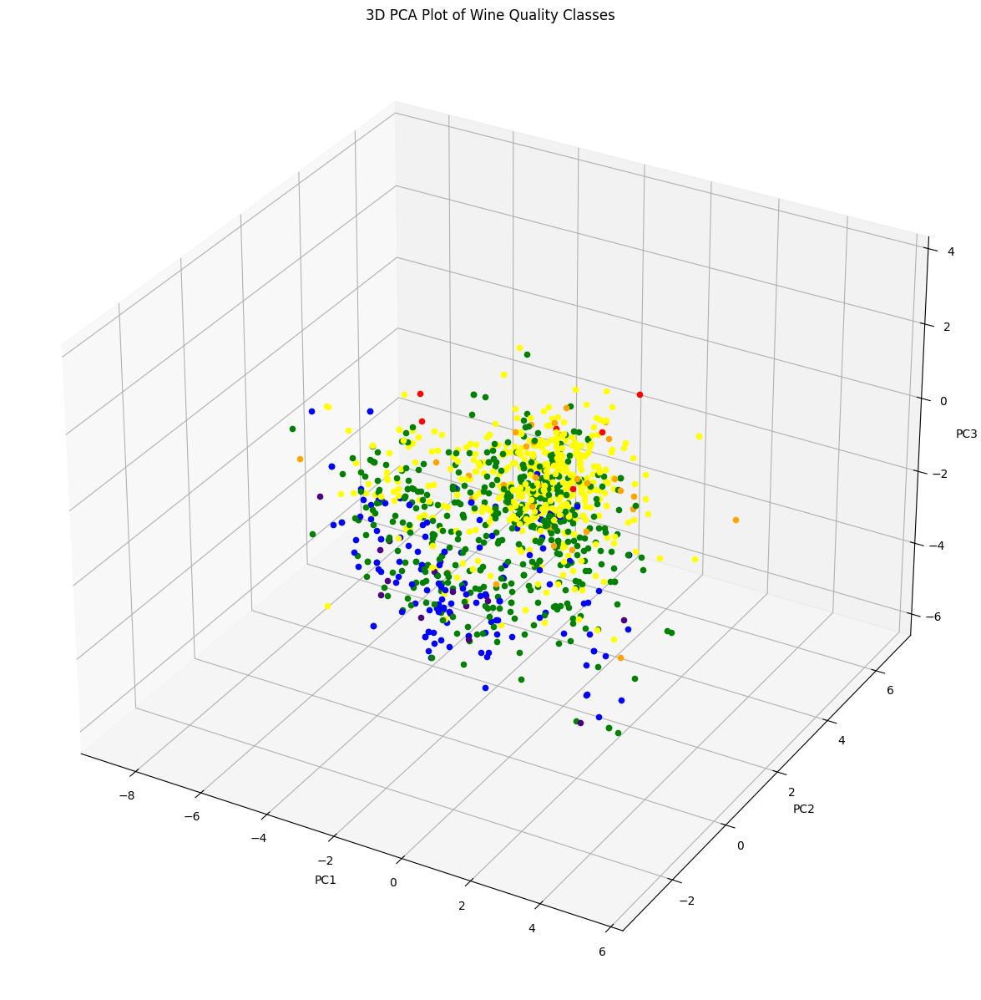

In [301]:
# plot 3d using ax.scatter
fig = plt.figure(figsize=(18, 15))
ax = fig.add_subplot(111, projection="3d")

for i in range(len(df_3PC_target)):
    # quality
    quality = df_3PC_target["Target"].iloc[i]
    # clr
    color = colors[quality - 3]
    # 3d
    ax.scatter(df_3PC_target["PC1"].iloc[i], df_3PC_target["PC2"].iloc[i], df_3PC_target["PC3"].iloc[i], color=color)

# x, y, z label
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")

# title
ax.set_title("3D PCA Plot of Wine Quality Classes")
plt.show()


This still looks a little messy, let's try to make the plot interactive by using [plotly](https://plotly.com/python/plotly-express/). Let's import the `plotly.express` package first!



In [289]:
pip install plotly.express

^C
Note: you may need to restart the kernel to use updated packages.


   ---------------------------------------- 0.0/19.1 MB ? eta -:--:--
   ---- ----------------------------------- 2.4/19.1 MB 13.4 MB/s eta 0:00:02
   ----------- ---------------------------- 5.2/19.1 MB 13.3 MB/s eta 0:00:02
   ---------------- ----------------------- 7.9/19.1 MB 13.2 MB/s eta 0:00:01
   ---------------------- ----------------- 10.7/19.1 MB 13.4 MB/s eta 0:00:01
   ----------------------------- ---------- 14.2/19.1 MB 13.9 MB/s eta 0:00:01
   ------------------------------------ --- 17.3/19.1 MB 14.0 MB/s eta 0:00:01
   ---------------------------------------- 19.1/19.1 MB 13.8 MB/s eta 0:00:00


In [291]:
import plotly.express as px


Next, we'll use [`px.scatter_3d()`](https://plotly.com/python-api-reference/generated/plotly.express.scatter_3d) to create a 3D scatter plot. We need to pass the DataFrame we just created in part 5.5 `pca_3d_df` and specify which columns should be used for the x, y, and z axes. **[5]**

Once the plot is displayed, you can use your mouse to drag and rotate the plot interactively.



**How** does adding the PC3 help? **[1]**


**Which** quality of wine are easier to be predicted now with the addition of PC3? **[1]**


In [302]:
### YOUR CODE HERE ###
fig = px.scatter_3d(
    df_3PC,
    x="PC1",
    y="PC2",
    z="PC3", 
    color=df_3PC_target["Target"].astype(str),
    labels={"color": "Wine Quality"},
    title="3D PCA Plot of Wine Quality Classes"
)

fig.show()

## Part 5.6: How Much of Each Feature are Captured by the PCs [12 Marks]


Now we know PCs could be used to predict wine qualities, but to get a meaningful analysis, we need to know **how much** of each features are captured by the PCs.

Loading Score is a score that represents the weight of each feature to the PC, higher Loading Score means higher weight.

Use the **Loading Score Plot for PC1, PC2, PC3** to find out **how much** of each features are captured by the PCs.







## Part 5.6a Create Loading DataFrame [5 Marks]

First, and most importantly we need to create a DataFrame that is made by `eigen Vectors * np.sqrt(eigen Values)`

**Why** do we multiply the eigenvectors by the square root of their corresponding eigenvalues to compute the loadings? **[1]**

**How** does this operation help in interpreting the contribution of each original feature to the principal components? **[1]**










Use the result of `eigen Vectors * np.sqrt(eigen Values)` to create the loading dataframe.

Create the DataFrame with the required values and with the same columns as the original dataset. **[3]**




In [325]:
### YOUR CODE HERE ###
loading = eigen_vec2 * np.sqrt(eigen_val2)
loading_df = pd.DataFrame(loading, columns=df_feature.columns)
                    #    columns=[f"PC{i+1}" for i in range(loading.shape[1])])

loading_df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,-0.862609,-0.140302,0.153582,-0.259925,-0.095364,0.084355,-0.258366,0.121850,0.101867,-0.120876,-0.152149
1,0.403710,0.395954,0.556867,0.085107,0.252229,0.339555,-0.394982,0.054160,-0.060428,0.149167,-0.002582
2,-0.817708,-0.200876,-0.309789,-0.070274,-0.076067,0.072924,0.070860,0.244920,-0.203733,0.270525,0.012981
3,-0.310156,0.345875,-0.114656,-0.448464,0.686636,0.020252,0.229118,-0.206454,0.004928,0.042353,-0.044352
4,-0.399670,0.209961,0.065966,0.718697,0.265050,0.260270,0.281619,0.212238,0.049392,-0.106145,-0.011283
5,0.085049,0.708887,-0.537503,-0.055949,-0.146194,-0.007776,-0.074568,0.133725,0.382696,0.087561,0.009141
6,-0.026782,0.791661,-0.405898,-0.051390,-0.206125,0.077426,-0.080768,-0.024210,-0.360838,-0.141812,-0.011400
7,-0.710373,0.298264,0.419470,-0.180612,0.148407,-0.327887,-0.117747,0.165883,0.012932,-0.090193,0.139610
8,0.769309,-0.008739,-0.075203,-0.007405,0.282878,-0.413568,-0.001112,0.368447,-0.097846,-0.002453,-0.082821
9,-0.422215,-0.085392,-0.379974,0.580916,0.245313,-0.307976,-0.348667,-0.233042,-0.015600,0.045021,-0.017262


- The reason we multiply the eigenvectors by the square root of their corresponding eigenvalues is that since the eigen values explain the variance (importance) of each PC, scales the eigen vectors by each PC's important in proportion to eigen vector will allow us to capture each PC's important (weight).

- Each loading explains how much does original feature impacting a PC. Higher loading values of a feature indicates it contribute more in forming this PC.


## Part 5.6b: Plot Loading Score Plot (Bar Plot) [7 Marks]

Next, we'll set up the Loading Score Plot, which is nothing but a Bar Plot for each PC.

We'll create **a bar plot for each PC** we wish to analyze.

In each of the bar plots, please make the Y-axis represents the loading scores we just created (indicating the contribution of each feature to the PC), and the X-axis represents the features. **[5]**



Based on the plot, with high `alcohol` and `free sulfur dioxide` values, a lower or higher PC3 value should be expected? **[1]**

Would that mean a higher quality or lower quality wine from this part and the 3D plot? **[1]**


In [333]:
loading_df.iloc[:, 1]

0    -0.140302
1     0.395954
2    -0.200876
3     0.345875
4     0.209961
5     0.708887
6     0.791661
7     0.298264
8    -0.008739
9    -0.085392
10   -0.523259
Name: volatile acidity, dtype: float64

In [334]:
loading_df.iloc[1]

fixed acidity           0.403710
volatile acidity        0.395954
citric acid             0.556867
residual sugar          0.085107
chlorides               0.252229
free sulfur dioxide     0.339555
total sulfur dioxide   -0.394982
density                 0.054160
pH                     -0.060428
sulphates               0.149167
alcohol                -0.002582
Name: 1, dtype: float64

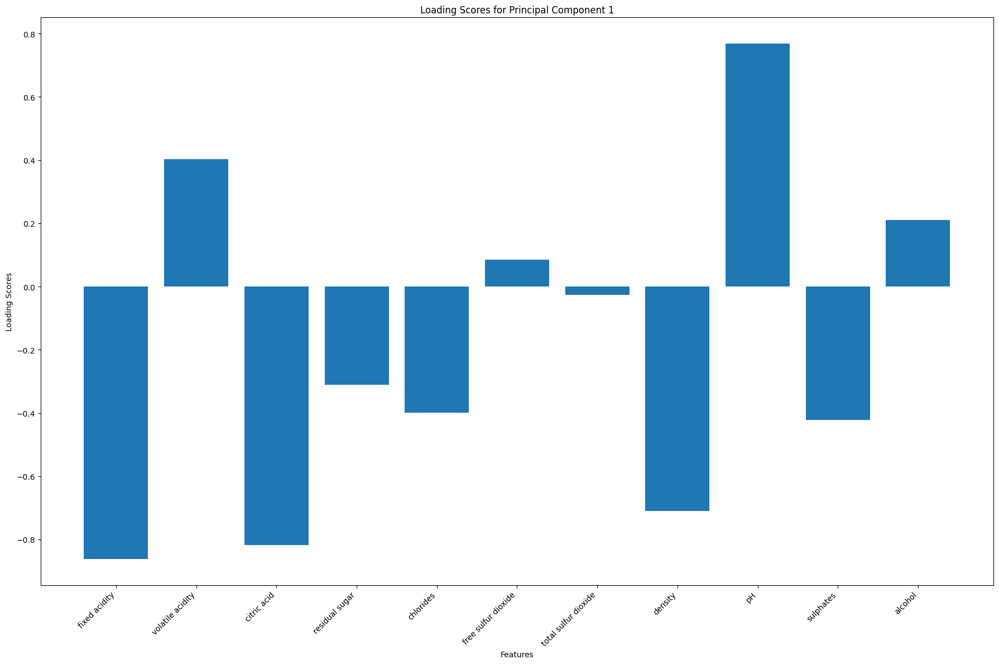

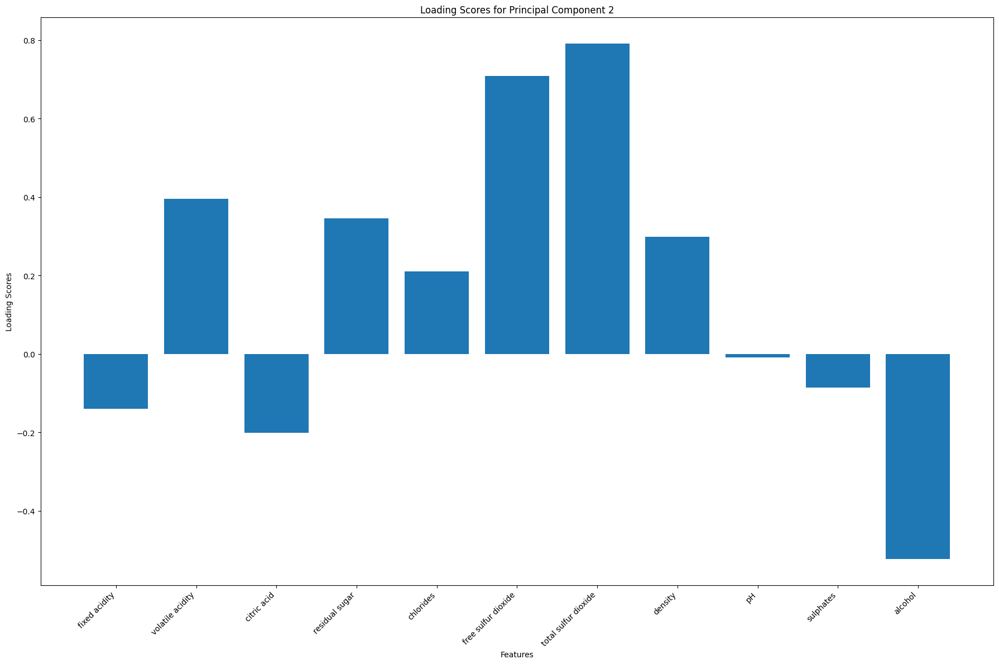

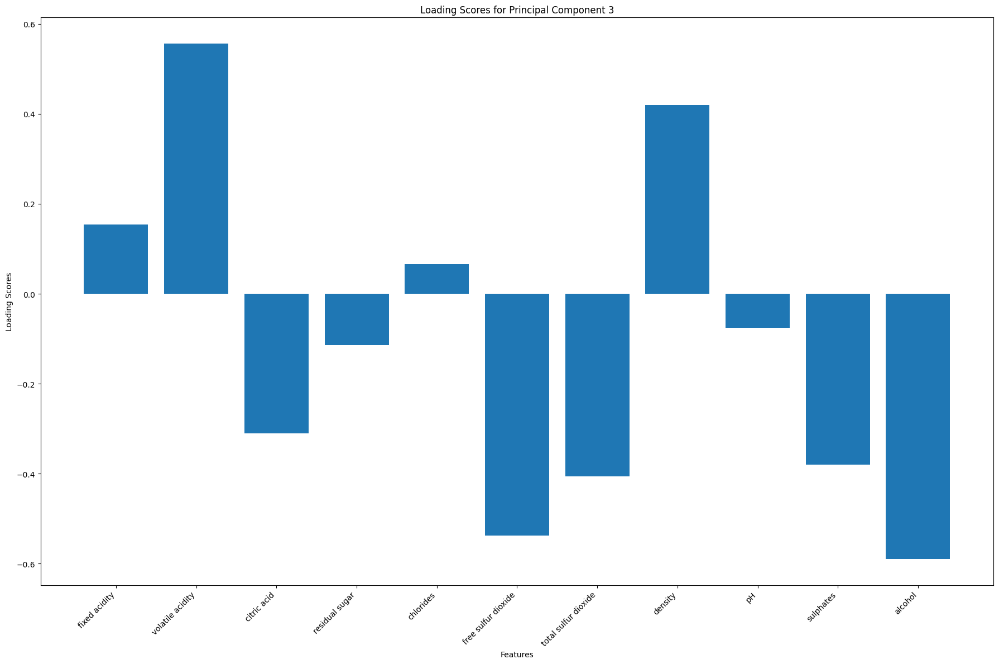

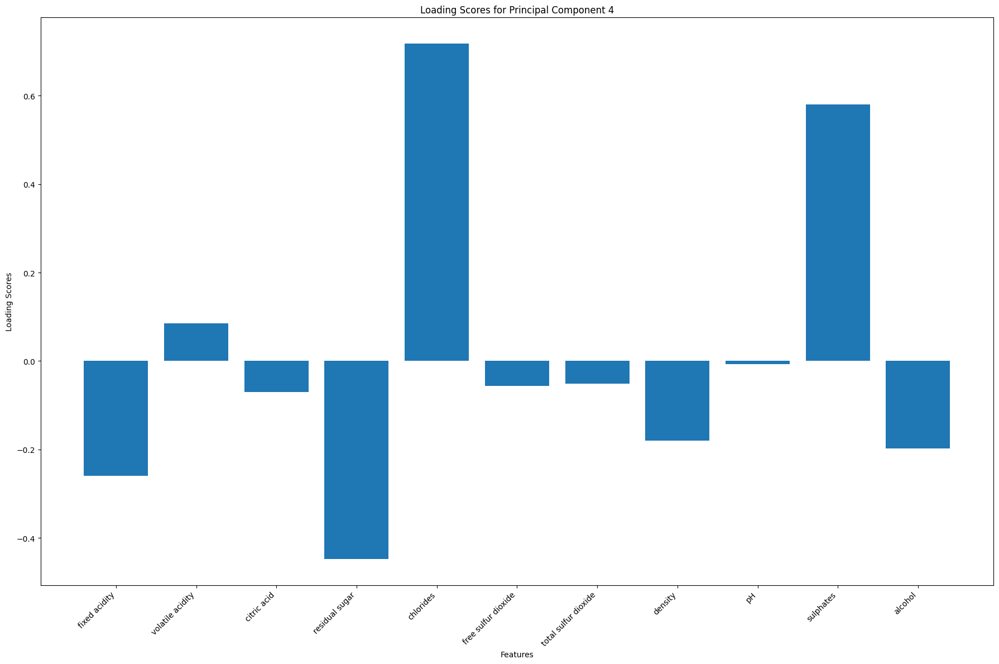

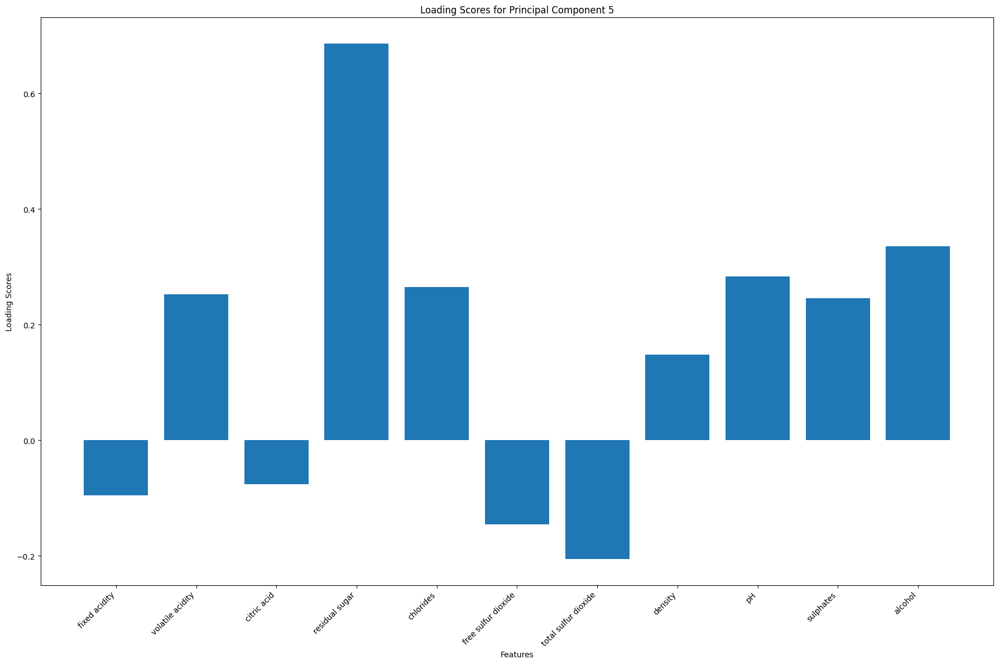

...

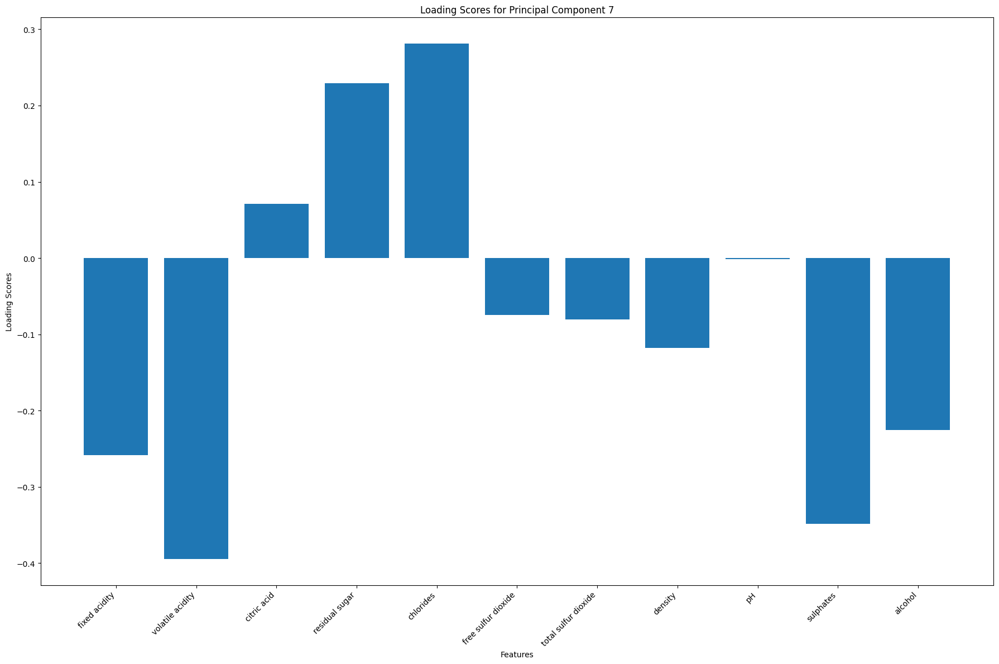

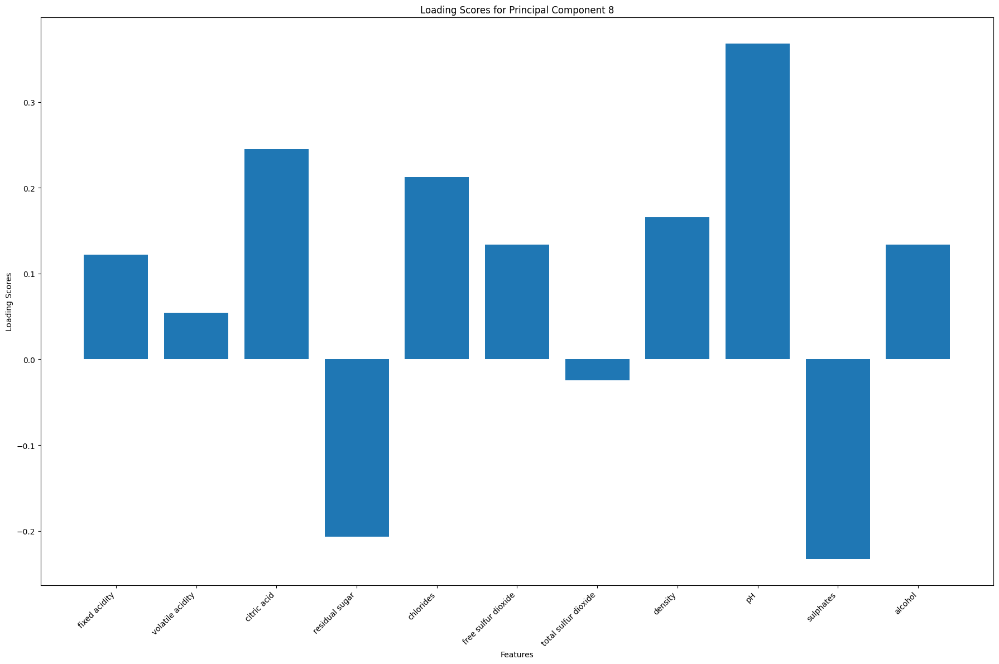

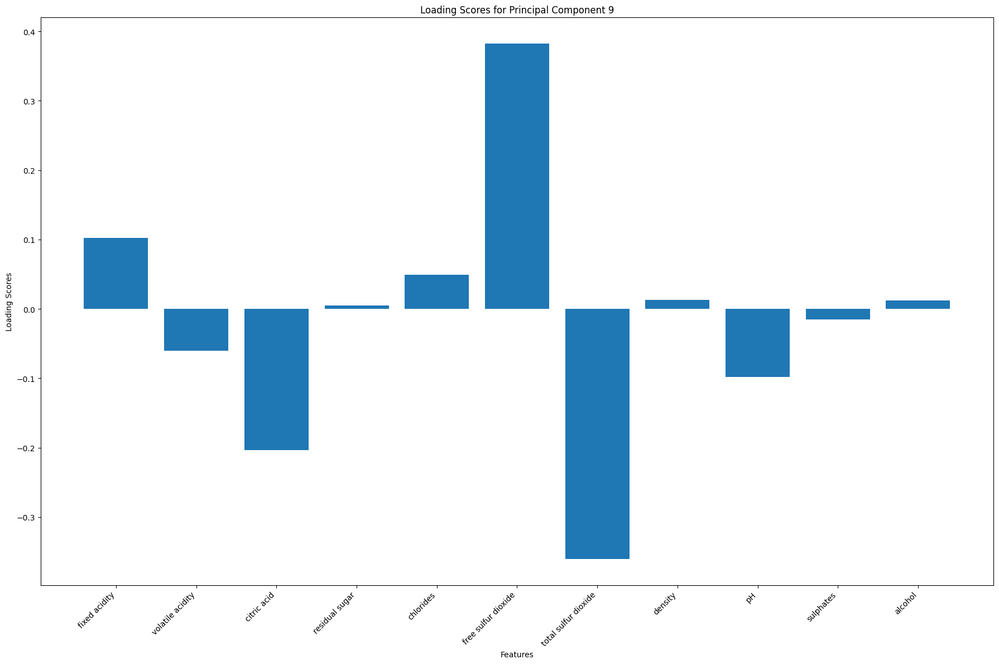

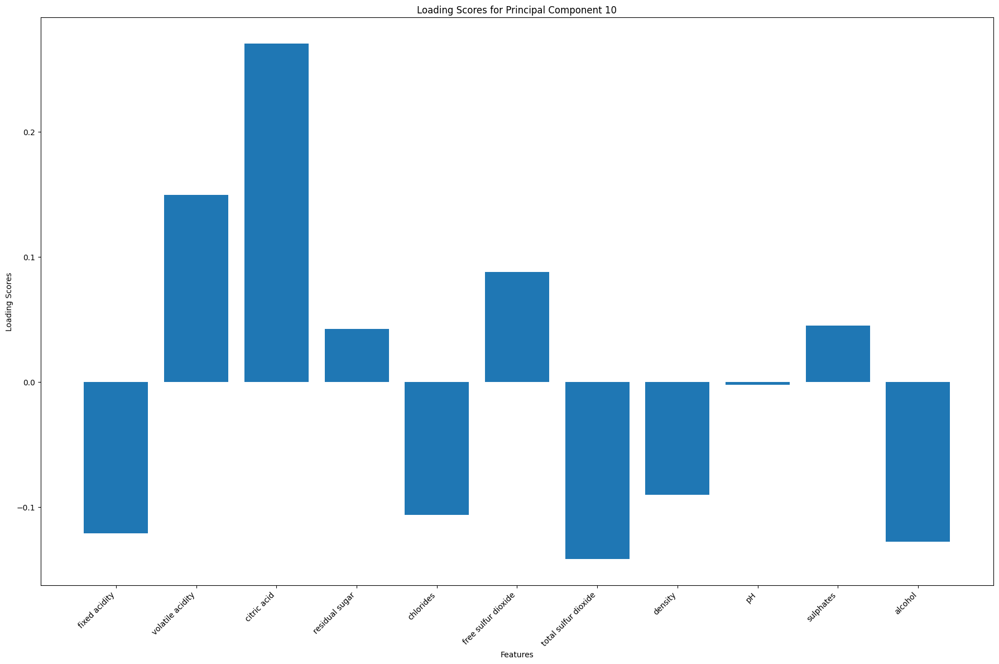

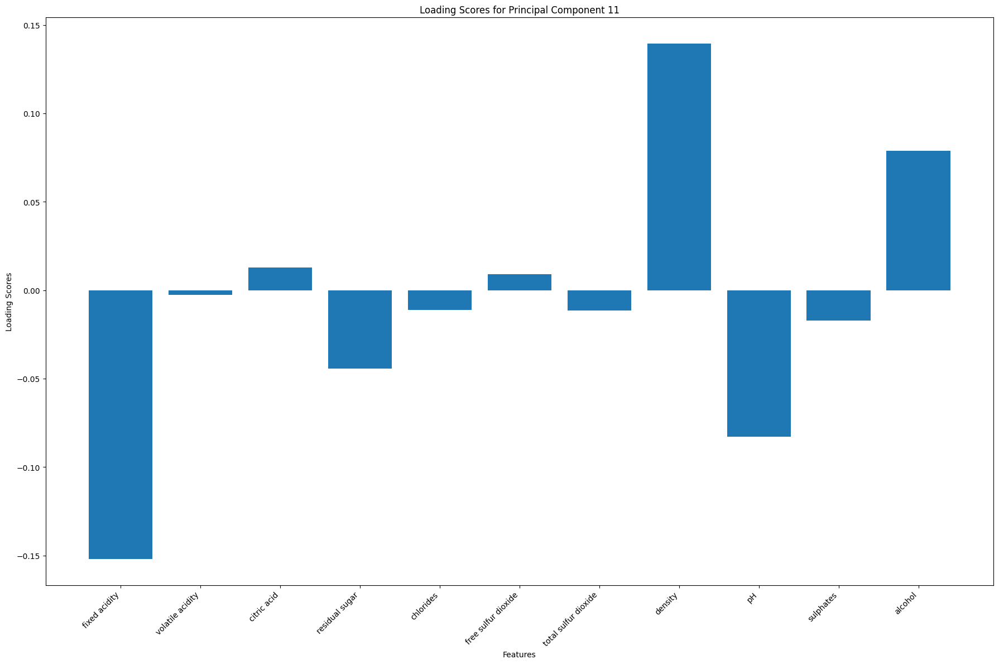

In [335]:
### YOUR CODE HERE ###

for i in range(loading_df.shape[1]):
    plt.figure(figsize=(18, 12))
    
    # bar plot for each pc
    plt.bar(loading_df.columns, loading_df.iloc[:, i])
    
    plt.title(f'Loading Scores for Principal Component {i+1}')
    plt.ylabel('Loading Scores')
    plt.xlabel('Features')
    
    # Rotate the x-axis labels for better readability
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

- since `alcohol` and `free sulfur dioxide` is negative, the higher of them will result in `lower` PC3 value.

- `lower PC3`value will related to `higher quality` wine

# References

Understanding PCA and SVD:

1. https://towardsdatascience.com/pca-and-svd-explained-with-numpy-5d13b0d2a4d8

2. https://stats.stackexchange.com/questions/134282/relationship-between-svd-and-pca-how-to-use-svd-to-perform-pca

3. https://stats.stackexchange.com/questions/2691/making-sense-of-principal-component-analysis-eigenvectors-eigenvalues

4. https://hadrienj.github.io/posts/Deep-Learning-Book-Series-2.8-Singular-Value-Decomposition/

PCA:

1. Snippets from: https://plot.ly/ipython-notebooks/principal-component-analysis/

2. https://www.value-at-risk.net/principal-component-analysis/


3. https://medium.com/towards-data-science/5-pca-visualizations-you-must-try-on-your-next-data-science-project-148ec3d31e4d


Flight Delays Data:

1. https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018


Wine Quality Data:
1. https://www.kaggle.com/datasets/yasserh/wine-quality-dataset

In [2]:
!jupyter nbconvert --to script F24_MIE370_Project_2.ipynb

[NbConvertApp] Converting notebook F24_MIE370_Project_2.ipynb to script
[NbConvertApp] Writing 360448 bytes to F24_MIE370_Project_2.py
